In [ ]:
import numpy as np
import numpy.random
from matplotlib import pyplot as plt
import networkx as nx
import timeit
import random
from numba import jit

In [ ]:
class potts:
#    @jit
    def __init__(self, J, gen, neigh, gamma, Q, t, beta, cycles = 0):
        self.neigh = neigh #Число соседей в графе Кэли
        self.gen = gen
        X = self.gen_Bethe(gen, neigh)
        self.t = t #Время эволюции модели
        self.Nodes = X['nodes']
        self.Edges = X['edges']
        self.adjacency_matrix = self.aj_matrix()
        self.boundry = []
        if(cycles == 1):
            self.closure()
        self.Q = Q
        self.basis = self.spin_vector()
        self.alt_basis = np.array([i for i in range(len(self.basis))])
        N = np.random.randint(0, Q, len(self.Nodes))
        self.N = N #пусть это будет массив спинов (элемент массива - вектор компонент спина)
        self.epsilon = np.random.gumbel(0, beta, [len(self.N),3])
        self.J = J #J is J
        self.gamma = gamma
        self.cycles = self.mean_of_spins3()
        self.T = gamma
        self.N_new = self.N[:] #массив новой конфигурации спинов
        self.probability_mass = [[0 for j in range(Q)] for i in range(len(self.N))]
        self.mass_of_probability()
        mss = self.mean()
        suka = self.mean_herfendale()
        self.ms = suka[0].copy()
        self.ks = suka[1].copy()
###########HELPERS#############
    def convert_number_to_vector(self, index):
        return self.basis[index]
#########END HELPERS###########
#########MATH###############
    def delta(self, x,y):
        Q = self.Q
        basis = self.basis.copy()
        scalar_product = np.inner(basis[x], basis[y])
        d = (1 + (Q - 1)*scalar_product)/Q
        return d

    def spin_vector(self):
#        Q = self.Q
        vector_mass = [[0,1], [(3**(0.5))/2, -0.5], [(-3**(0.5))/2, -0.5]] #for Q = 3
#        for component in range(Q):
#            vector_mass.append([])
        return vector_mass
###########END MATH############
###########PROB AND UTILITY######

    def probability(self, ind):
        utility_nT = np.array(self.utility(ind))
        utility = utility_nT * (1/self.T)
#        neigh_for_utility = self.find_neigh3(ind)
        neigh = self.find_neigh3(ind)
#        pre_sum = [np.exp(utility[i]*(1/self.T)) for i in range(len(self.basis))]
        pre_sum = np.exp(utility)
        psum = np.sum(pre_sum)
#        bas = self.basis_Without_one(ind)
#        result = np.zeros(3)
        result = np.exp(utility) * (1/psum)
#        for i in range(len(self.basis)):
#            f = np.exp(utility[i] * (1/self.T))/(psum)
#            result.append(f)
        return result

    def delta_mass(self, neighbors):
        result = np.zeros(neighbors)
        basis = self.alt_basis.copy()
        

    def utility(self, ind):
        neigh = self.find_neigh3(ind)
        Spins = self.N.copy()
        result = np.zeros(3)
        for i in range(len(self.basis)):
            pre_sum = [self.delta(i, Spins[k]) for k in neigh]
            f = self.J * np.sum(pre_sum)
            result[i] = f
        return result

##########END PROB AND UTILITY########
    def find_colors(self):
        col1 = self.N[:]
        c = np.unique(col1)
#        p = [0 for i in range(len(self.basis))]
        p = np.zeros(len(self.basis))
        for i in range(len(col1)):
            for k in range(len(self.basis)):
                if(col1[i] == k):
                    p[k] = p[k] + 1
        return p

    def find_colors_in_branches(self):
        col1 = self.N[:]
#        index_of_verticles = [i for i in range(len(self.N))]
        N_new = np.delete(self.N, 0)
        N_new2 = np.split(N_new, 3)
        c = np.unique(col1)
        result = []
#        print('result pre = %s' %result)
        p1 = np.zeros(len(self.basis))
        for l in range(len(N_new2)):
            p = p1.copy()
            for i in N_new2[l]:
                for k in range(len(self.basis)):
                    if(i == k):
                        p[k] = p[k] + 1
            result.append(p)
#        print('result past = %s' %result)
        return result
#########WORK WITH GRAPH##############
    def coloryze(self): #Раскрашиваем граф
        diff_spins = self.N[:]
        diff = len(np.unique(diff_spins, axis=0))
        diffsp = np.unique(diff_spins, axis=0)
        colors = [i/(diff*2) for i in range(1, diff + 1)]
        l = [1 for i in range(len(diff_spins))]
        for k in range(len(diff_spins)):
            for i in range(len(diffsp)):
                if(np.array_equal(diffsp[i],diff_spins[k])):
                    l[k] = colors[i]
        return l

    def aj_matrix(self): #Строим матрицу смежности графа
        a = [[0 for j in range(len(self.Nodes))] for i in range(len(self.Nodes))]
        for i in self.Edges:
            a[i[0]][i[1]] = 1
            a[i[1]][i[0]] = 1
        return np.array(a)

    def simple_bound(self): #Вычисляем границу графа
        bound = []
        aj = self.adjacency_matrix
        for i in range(len(aj)):
            m = np.sum([k for k in aj[i] if k == 1])
            if(m > 1):
                continue
            bound.append(i) #Храним номера элементов границы из матрицы смежности
        return bound

    def closure(self): #Замыкаем границу графа
        self.boundry = self.simple_bound()
        bound = self.boundry[:]
        aj = self.adjacency_matrix[:]
        for i in range(len(bound)):
            t = i
            if(t+1 >= len(bound)):
                t = -1
            aj[bound[t]][bound[t + 1]] = 1
            aj[bound[t+1]][bound[t]] = 1
        self.adjacency_matrix = aj
########END WORKING WITH GRAPH####################################
    def mass_of_probability(self):
        for i in range(len(self.N)):
            pr2 = self.probability(i)
            pr = pr2.copy()
            self.probability_mass[i] = pr

########################################################################################

#here i try something new

    def basis_Without_one(self, ind):
        indexes = []
        for i in range(len(self.basis)):
            if(np.array_equal(self.basis[i], self.N[ind]) == True):
                continue
            indexes.append(i)
        return indexes

    def change_spin(self, ind):
        K = ind
        pr2 = self.probability(ind)
        pr = pr2.copy()
        self.probability_mass[ind] = pr
        indexes = [i for i in range(len(self.basis))]
        index_new_state = np.random.choice(indexes, p = pr)
        mda = self.basis[index_new_state]
        mda2 = mda.copy()
        self.N[ind] = index_new_state
        K = ind
        return [K, pr]


    def evolve(self):
        mean_of_sp = []
        mean_of_sp.append(self.ms[:])
        mean_of_graph = []
        mean_of_graph.append(self.ks)
        mean_of_zero_point = []
        mean_of_zero_point2 = []
        color_mass = []
        mass_of_br_mean = []
        color_branches = []
        for i in range(self.t):
            fucc = self.N[0]
            z = fucc.copy()
            mean_of_zero_point.append(z)
            index = np.random.randint(len(self.N))
            mass = self.change_spin(index)
            L = mass[0]
            pr = mass[1]
            wut2 = np.array(self.basis).T * np.array(self.probability_mass[0])
#            print('wut2 = %s' %wut2)
#            wut3 = np.sum(wut2.T, axis = 0)
            wutT = wut2.T
            wut3 = wutT[0] - (wutT[1] + wutT[2]) 
            wut4 = wut3.copy()
            mean_of_zero_point2.append(np.inner(wut4, wut4))
#            mss = self.mean()
            mss_herf = self.mean_herfendale()
            mss_herf1 = mss_herf.copy()
            mean_of_br = self.mean_of_branches_herfendale()
            mass_of_br_mean.append(mean_of_br)
#            mss1 = mss.copy()
            col = self.find_colors_in_branches()
            col1 = col.copy()
            color_branches.append(col1)
            self.ms = mss_herf1[0].copy()
            self.ks = mss_herf1[1].copy()
            mean_of_sp.append(mss_herf1[0])
            mean_of_graph.append(mss_herf1[1])
            colors = self.find_colors()
            color_mass.append(colors)
        return [mean_of_sp, mean_of_graph, mean_of_zero_point, mass_of_br_mean, color_branches, color_mass, mean_of_zero_point2]

    def check_max(self, neighbors, full_utility, prev):
        neighbors_utility = [full_utility[i] for i in neighbors]
        X = np.amax(neighbors_utility, axis = 0)
        Y = np.amax(neighbors_utility, axis = 1)
        X = np.amax(X)
        Y = np.amax(Y)
        result = prev
        maxim = np.amax([X, Y])
        for i in neighbors:
            for j in range(len(full_utility[0])):
                if(full_utility[i][j] == maxim):
                    print('result = %s' %i)
                    print('prev = %s' %prev)
                    result = i
        return result


    def herfendale2(self, mass1):
        X = np.array([i for i in range(self.Q)])
        mass = np.array(mass1)
        Y = [np.sum(mass==i) for i in X]
#        print('mass = %s' %mass)
#        print('Y = %s' %Y)
        Z = np.sum(Y)
        herf = np.sum([(j/Z)**2 for j in Y])
#        print('herf = %s' %herf)
        return herf

    def herfendale(self, mass):
        full_summ = np.sum(mass, axis = 0)
#        print('fukk symm = %s' %full_summ)
        full_sum = np.inner(full_summ, full_summ)
#        print('i = %s' %mass[-1])
        herf = np.sum([np.inner(i, i)/full_sum for i in mass])
        return herf

    def mean_of_branches_herfendale(self):
        index_of_verticles = [i for i in range(len(self.N))]
        N_new = np.delete(index_of_verticles, 0)
        N_new2 = np.split(N_new, 3)
#        print('len N = %s' %len(N_new2))
        mean = []
        for i in range(len(N_new2)):
#            print('N_new2[i] = %s' %N_new2[i])
#            mass = [self.convert_number_to_vector(self.N[k]) for k in N_new2[i]]
            mass = [self.N[k] for k in N_new2[i]]
#            print('mass = %s ' %mass)
            X = self.herfendale2(mass)
#            print('X = %s' %X)
            mean.append(X)
        return mean


    def mean_of_branches(self):
        index_of_verticles = [i for i in range(len(self.N))]
        N_new = np.delete(index_of_verticles, 0)
        N_new2 = np.split(N_new, 3)
        mean = []
        for i in range(len(N_new2)):
            X = []
            for k in N_new2[i]:
                wut2 = np.array(self.basis).T * np.array(self.probability_mass[k])
                Y = np.sum(wut2.T, axis = 0)
#                Y = np.sum([[self.basis[j][l] * self.probability_mass[k][j] for l in range(len(self.basis[0]))] for j in range(len(self.probability_mass[0]))], axis = 0)
                X.append(Y)
            mean.append(np.mean(X, axis = 0))
        return mean

    def mean_herfendale(self): #Рассчет средних
        zero = self.N[0]
        cycles = self.cycles[:]
#        z = zero.copy()
        mean_spins = []
#        mean_spins.append(z)
        for i in range(self.gen + 1):
            X = cycles[i].copy()
            X1 = [self.N[j] for j in X]
            Z = self.herfendale2(X1).copy()
            mean_spins.append(Z)
        Y = self.N.copy()
        full_mean = self.herfendale2(Y)
#        print('mean_spins = %s' %mean_spins)
#        print('full_mean = %s' %full_mean)
        return [mean_spins, full_mean]

    def mean(self): #Рассчет средних
        zero = self.N[0]
        cycles = self.cycles[:]
#        z = zero.copy()
        mean_spins = []
#        mean_spins.append(z)
        for i in range(self.gen + 1):
            X = []
            for j in cycles[i]:
#                m = self.N[j].copy()
                wut2 = np.array(self.basis).T * np.array(self.probability_mass[j])
                spin = np.sum(wut2.T, axis = 0)
#                spin = np.sum([[self.basis[i][k] * self.probability_mass[j][i] for k in range(len(self.basis[0]))] for i in range(len(self.probability_mass[0]))], axis = 0)
                X.append(spin)
            mean_spins.append(np.mean(X, axis = 0))
        spin2 = [np.sum((np.array(self.basis).T * np.array(self.probability_mass[j])).T, axis = 0) for j in range(len(self.N))]
        full_mean = np.mean(spin2, axis = 0)
        return [mean_spins, full_mean]
        

    def mean_of_spins3(self): #находит границу
        X = [[0]]
#        aj = self.adjacency_matrix[:]
        N = []
        for i in range(self.gen):
            Y = []
            for k in X[i]:
                p = self.find_neigh3(k)
                if(i > 0):
                    f = np.setdiff1d(p, X[i-1])
                else:
                    f = p
                for z in f:
                    Y.append(z)
            X.append(Y)
        return X

    def mean_of_spins(self): #Рассчет средних
        zero = self.N[0]
        cycles = self.cycles[:]
#        z = zero.copy()
        mean_spins = []
#        mean_spins.append(z)
        for i in range(self.gen + 1):
            X = []
            for j in cycles[i]:
                m = self.N[j].copy()
                X.append(m)
            mean_spins.append(np.mean(X, axis = 0))
        spin = self.N
        spin2 = spin.copy()
        full_mean = np.mean(spin2, axis = 0)
        return [mean_spins, full_mean]
        

##############################################################################################
#Блок, отвечающий за блуждание точки по графу и вычисление средней ориентации графа по времени
##############################################################################################
    def find_neigh(self, ind):
          s = self.adjacency_matrix[:]
          st = s[ind]
          F = np.nonzero(st)
          X = F[0]
          Y = [x for x in X if(np.array_equal(self.N[ind], self.N[x]) == False)]
          Z = [[y, self.N[y]] for y in Y]
          K = [z[:][1] for z in Z]
          uniques = []
          for arr in K:
              if not any(numpy.array_equal(arr, unique_arr) for unique_arr in uniques):
                  uniques.append(arr)
          un = []
          for i in uniques:
              for j in Z:
                  if(np.array_equal(i,j[:][1])):
                      un.append(j[:][0])
                      break
#          print('Y = %s' %Y)
          if(len(un) == 0):
              un = [ind]
          return un

    def find_neigh2(self, ind):
          s = self.adjacency_matrix[:]
          st = s[ind]
          F = np.nonzero(st)
          X = F[0]
          Y = [x for x in X if(np.array_equal(self.N[ind], self.N[x]) == False)]
#          Z = [[y, self.N[y]] for y in Y]
          if(len(Y) == 0):
              Y = [ind]
          return Y

    def find_neigh3(self, ind):
          s = self.adjacency_matrix[:]
          st = s[ind]
          F = np.nonzero(st)
          X = F[0]
          return X
        
##############
#блок завершен
##############

    def gen_Bethe(self, generations, neighbors):
        nodes = []
        edges = []
        counter = -1
        def tree(level, neighbors, head):
            nonlocal counter
            counter += 1
            nodes.append({
                    'id': counter,
                    'label': str(counter),
                    'group': level})
            current_node = counter
            if (head != current_node):
                edges.append([
                    head,           #from
                    current_node])  #to

            if (level == 0):
                return 0

            childs = neighbors - 1
            if (current_node == 0):
                childs = neighbors

            low = level - 1
            for i in range(childs):
                tree(low, neighbors, current_node)

            return 0

        tree(generations, neighbors, 0)

        return {
            'nodes': nodes,
            'edges': edges}

In [ ]:
def fix_orient(Mass):
  mak = []
  mean = []
  for i in range(len(Mass)):
    bak = []
    bak_b = []
    for k in range(len(Mass[i])):
      l = Mass[i][k].argmin()
      bak.append({ 'epoch': k, 'spin': l})
      bak_b.append(l)
    mean.append(bak_b)
    mak.append({'itteration': i, 'result': bak})
#for i in mak:
#  print(i)
  mean = np.array(mean).T
  for i in range(len(mean)):
    plt.plot(mean[i])
    plt.show()

def color(M1):
  col1 = M1.coloryze()
  c = np.unique(col1)
  p = [0 for i in range(len(c))]
  for i in range(len(col1)):
    for k in range(len(c)):
      if(col1[i] == c[k]):
        p[k] = p[k] + 1
  print('p = %s' %p)
  a = np.array(M1.adjacency_matrix)
  G1 = nx.from_numpy_matrix(a, create_using=nx.MultiGraph)
  nx.draw_kamada_kawai(G1, node_color=col1, edge_color='r', node_size = 30)

def col_all_graph(Mass):
#  Mass = Mass[1].copy()
  style = ['r-', 'b-.', 'g--']
  Mass = np.array(Mass)
  Mass = Mass.T
  y = [i for i in range(len(Mass[0]))]
#  for i in Mass:
  k = Mass
#  print(k)
  plt.figure(figsize=(10,5))
  for j in range(len(k)):
    plt.plot(y, k[j], style[j], label = 'Спиновая компонента %s' %j)
  plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left', borderaxespad=0.)
  plt.show()

def col_all_graph2(Mass):
#  Mass = Mass[1].copy()
  style = ['r-', 'b-.', 'g--']
  Mass = np.array(Mass)
  Mass = Mass.T
  y = [i for i in range(len(Mass[0]))]
#  for i in Mass:
#  k = Mass
#  print(k)
  plt.figure(figsize=(10,5))
  for j in range(len(Mass)):
    plt.plot(y, Mass[j], style[j], label = 'Спиновая компонента %s' %j)
  plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left', borderaxespad=0.)
  plt.show()

def herfendale_for_all_graph(Mass, typ):
#  Mass = Mass[0].copy()
  name = 'Квадрат функции от взвешанных с вероятностью спинов, заданной в центральной вершине графа'
  if(typ == 1):
    name = 'Индекс Херфиндаля для всего графа'
  y = [i for i in range(len(Mass))]
#  print('len of y = %s' %len(y))
#  print('first epoch = %s' %Mass[1])
  style = ['r-', 'b-.', 'g--']
#    print('element of epoch = %s' %k)
  plt.figure(figsize=(10,5))
  plt.axis([0, len(Mass) + 1, 0, 1.3])
  plt.plot(y, Mass, style[0])
  plt.xlabel(name)
  plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left', borderaxespad=0.)
  plt.show()


def result_graph2(Mass):
  print('zero point')
#  Y = Mass[-1].copy()
  X = [i for i in range(len(Mass))]
#  print('X = %s' %X)
  Y = np.array(Mass).T
  print('transp Y = %s' %Y)
  var = ['r-', 'b-.']
  plt.figure(figsize=(10,5))
  for k in range(len(Y)):
    plt.plot(X, Y[k], var[k], label = 'компонента %s' %k)
  plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left', borderaxespad=0.)
  plt.show()

def result_graph3(Mass1):
#  Mass = Mass[0].copy()
  y = [i for i in range(len(Mass1))]
  Mass = np.array(Mass1).T
#  print('len of y = %s' %len(y))
#  print('first epoch = %s' %Mass[1])
  style = ['r-', 'b-.', 'g--']
  for i in range(len(Mass[0])):
    print('epoch = %s' %i)
#    print('element of epoch = %s' %k)
    plt.figure(figsize=(10,5))
    for k in range(len(Mass)):
      plt.plot(y, Mass[k][i], style[k], label = 'Спин %s' %k)
    plt.axis([0, len(Mass1) + 1, 0, 35])
    plt.xlabel('Зависимость количества вершин со спинами различной ориентации от времени для ветви %s' %i)
    plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left', borderaxespad=0.)
    plt.show()


def result_graph_for_branches(Mass1):
#  Mass = Mass[0].copy()
  Mass = np.array(Mass1).T
  y = [i for i in range(len(Mass1))]
#  print('len of y = %s' %len(y))
#  print('first epoch = %s' %Mass[1])
  name = 'Ветвь %s'
  name2 = name2 = 'Индекс Херфиндаля для ветви %s'
  if(len(Mass) > 3):
    name = 'Окружность %s'
    name2 = 'Индекс Херфиндаля для окружности %s'
  style = ['r-', 'b-.', 'g--']
  for i in range(len(Mass)):
    print(name %i)
#    print('element of epoch = %s' %k)
    plt.figure(figsize=(10,5))
    plt.axis([0, len(Mass1) + 1, 0, 1.3])
    plt.plot(y, Mass[i], style[0])
    plt.xlabel(name2 %i)
    plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left', borderaxespad=0.)
    plt.show()


def find_dynamics_of_colors(Mass):
  X = [i for i in range(len(Mass))]
  Y1 = np.array(Mass)
  Y = Y1.transpose()
  style = ['r-', 'b-.', 'g--']
  plt.figure(figsize=(10,5))
  for j in range(len(Y)):
    plt.plot(X, Y[j], style[j], label = 'Спин %s' %j)
  
  plt.axis([0, len(Mass) + 1, 0, 100])
  plt.xlabel('Зависимость количества вершин со спинами различной ориентации от времени')
  plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left', borderaxespad=0.)
  plt.show()


def result_graph(Mass):
#  mean = np.mean(Mass, axis = 1)
  epoch = []
  for i in range(len(Mass[0])):
    b = []
    for k in Mass:
      b.append(k[i])
    epoch.append(b)
  print('len epoch = %s' %len(epoch))
  epoch = np.array(epoch)
  y = [i for i in range(len(epoch[0]))]
#for i in epoch:
#  k = i.T
#  print(k)
#  plt.figure(figsize=(20,10))
#  plt.plot(y, k[0], 'r-', y, k[1], 'b-.', y, k[2], 'g--')
#  plt.show()
  style = ['r-', 'b-.', 'g--']
  for i in epoch:
    k = i.T
    print('element of epoch = %s' %k)
    plt.figure(figsize=(10,5))
    for j in range(len(k)):
      plt.plot(y, k[j], style[j], label = 'Спиновая компонента %s' %j)
    plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left', borderaxespad=0.)
    plt.show()

In [ ]:
def stat(t):
#  k = [0.001, 0.01, 0.1, 1, 10, 100, 1000]
  k = [1000, 0.7, 0.6, 0.5, 0.1]
  for i in k:
    M1 = potts(1, 5, 3, i, 3, t, 1, 0)
    print('debug zero pre = %s' %M1.N[0])
    color(M1)
    Mss1 = M1.evolve()
    Mass1 = Mss1[0]
    print('debug zero past = %s' %M1.N[0])
    print('without cycle, beta = %s' %i)
    col_all_graph(Mss1[1])
    color(M1)
    result_graph2(Mass1)
    result_graph(Mass1)
    M2 = potts(1, 5, 3, i, 3, t, 1, 1)
    color(M2)
    Mss2 = M2.evolve()
    Mass2 = Mss2[0]
    print('with cycle, beta = %s' %i)
    col_all_graph(Mss2[1])
    color(M2)
    result_graph2(Mass2)
    result_graph(Mass2)

debug zero pre = 0
p = [25, 37, 32]
debug zero past = 2
without cycle, beta = 1000


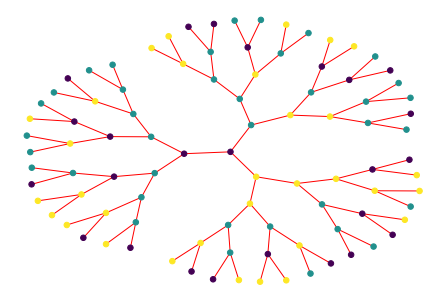

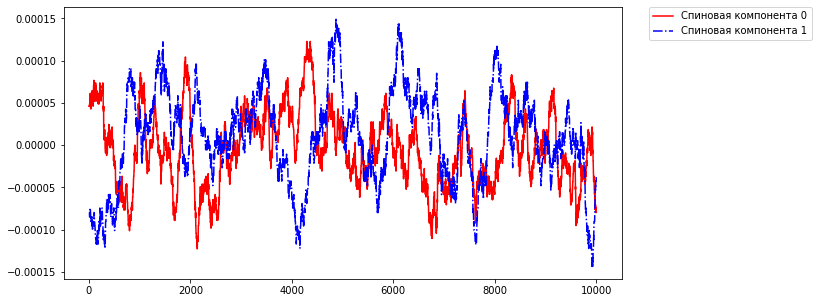

p = [27, 26, 41]
zero point


ValueError: ignored

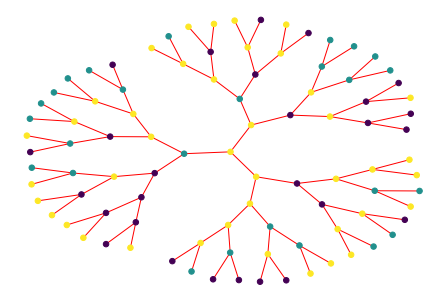

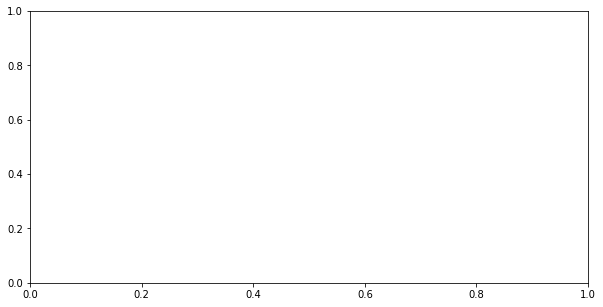

In [ ]:
stat(10000)

In [ ]:
def stat2(t):
#  k = [0.001, 0.01, 0.1, 1, 10, 100, 1000]
  k = [10, 1, 0.8, 0.6, 0.4, 0.2, 0.1, 0.01]
  for i in k:
    M1 = potts(1, 5, 3, i, 3, t, 1, 0)
    print('debug zero pre = %s' %M1.N[0])
    color(M1)
    Mss11 = M1.evolve()
    Mss1 = Mss11.copy()
#    Mass1 = Mss1[0]
    print('debug zero past = %s' %M1.N[0])
    print('without cycle, beta = %s' %i)
    col_all_graph2(Mss1[1])
    find_dynamics_of_colors(Mss1[-2])
    color(M1)
    result_graph2(Mss1[-1])
    print('colors of branches')
    result_graph3(Mss1[4])
    print('Branches')
    result_graph3(Mss1[3])
    print('Circles')
    result_graph3(Mss1[0])
    M2 = potts(1, 5, 3, i, 3, t, 1, 1)
    color(M2)
    Mss21 = M2.evolve()
    Mss2 = Mss21.copy()
#    Mass2 = Mss2[0]
    print('with cycle, beta = %s' %i)
    col_all_graph2(Mss2[1])
    find_dynamics_of_colors(Mss2[-2])
    color(M2)
    result_graph2(Mss2[-1])
    print('colors of branches')
    result_graph3(Mss2[4])
    print('Branches')
    result_graph3(Mss2[3])
    print('Circles')
    result_graph3(Mss2[0])

debug zero pre = 1
p = [33, 28, 33]
debug zero past = 0
without cycle, beta = 10


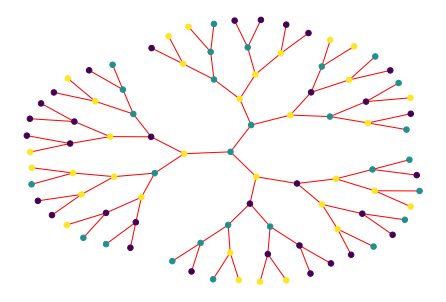

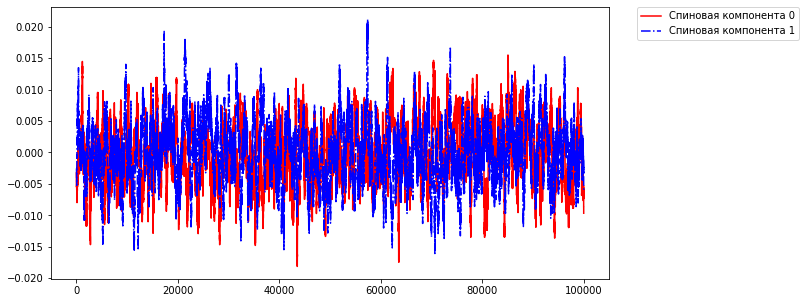

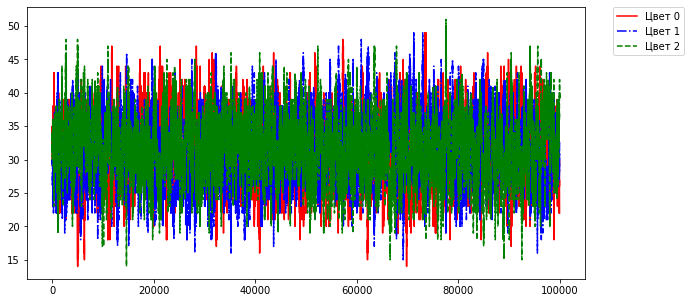

p = [22, 33, 39]
zero point
transp Y = [[-0.03025928 -0.03025928 -0.03025928 ... -0.02737973 -0.02737973
  -0.02737973]
 [-0.04908559 -0.04908559 -0.04908559 ...  0.0507481   0.0507481
   0.0507481 ]]


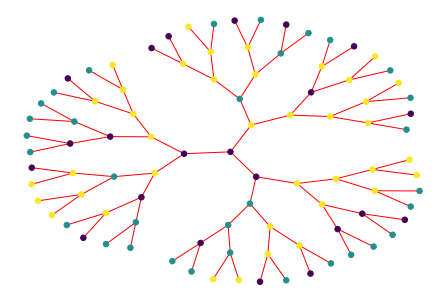

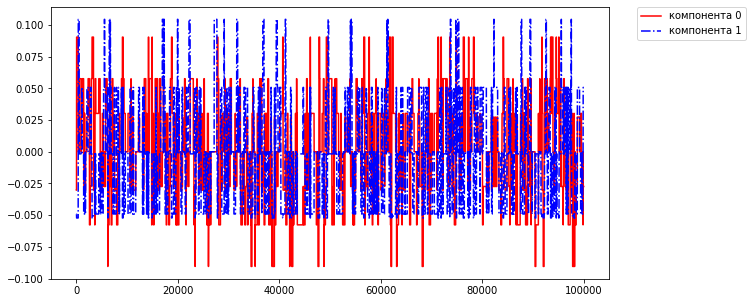

colors of branches
epoch = 0


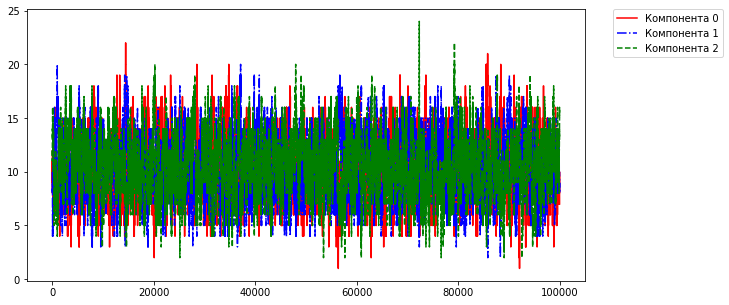

epoch = 1


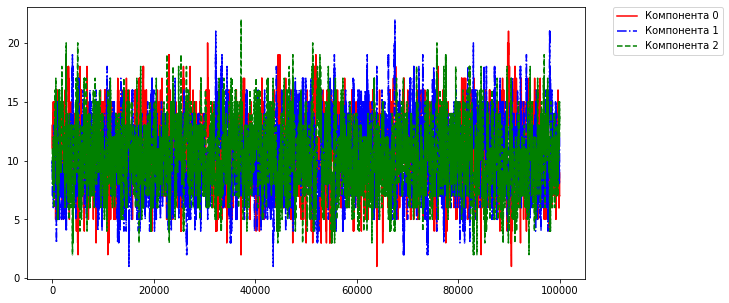

epoch = 2


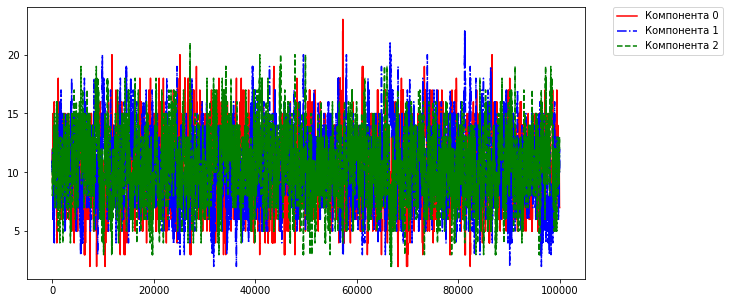

Branches
epoch = 0


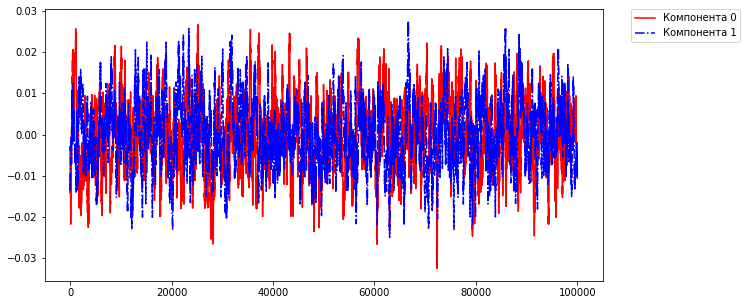

epoch = 1


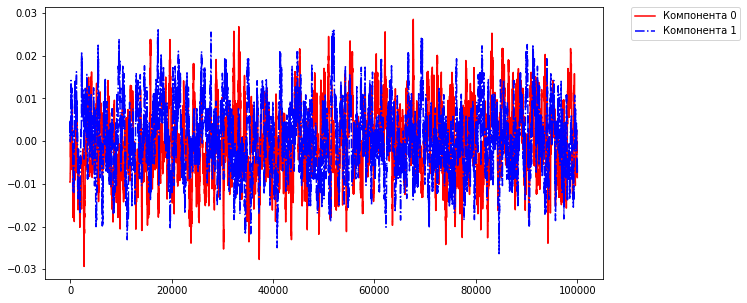

epoch = 2


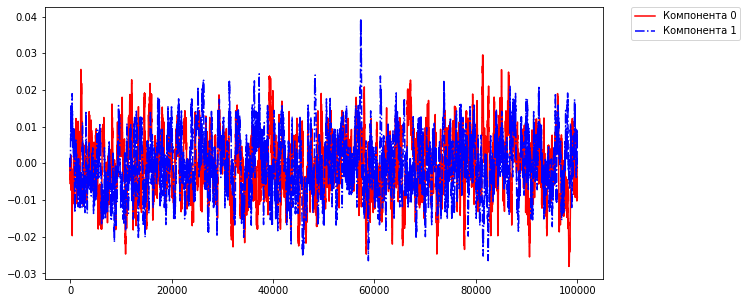

Circles
epoch = 0


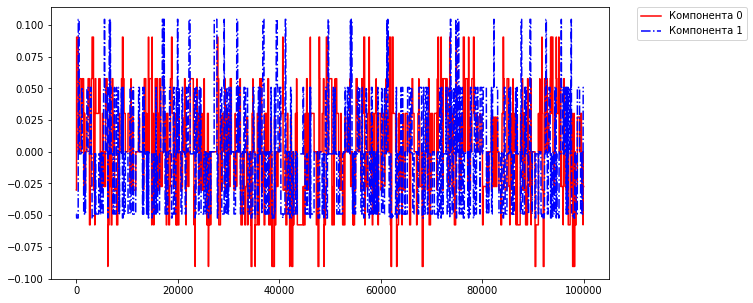

epoch = 1


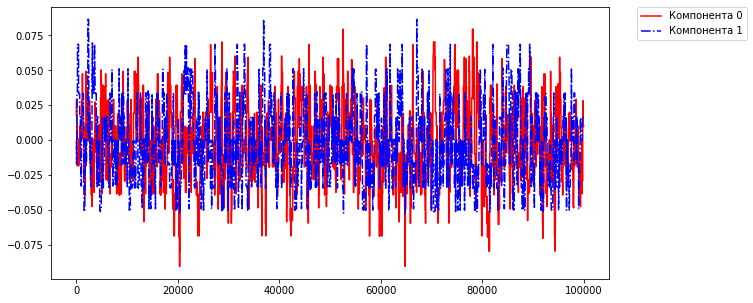

epoch = 2


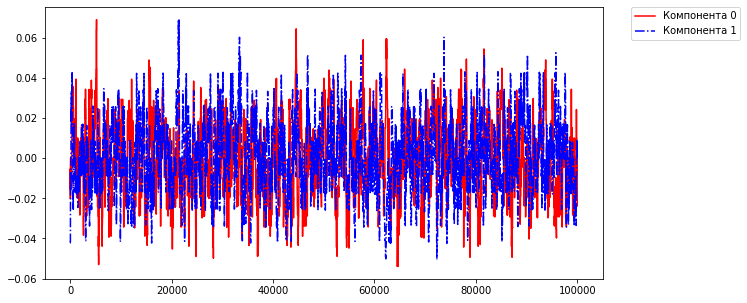

epoch = 3


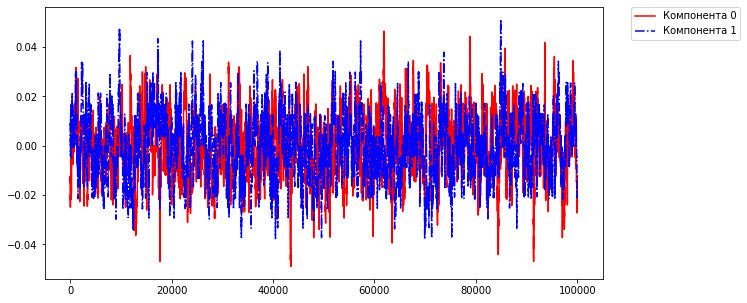

epoch = 4


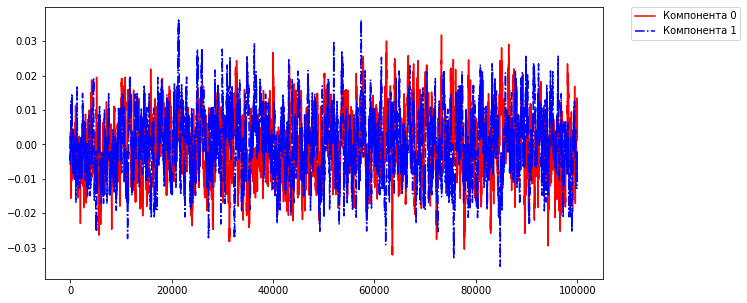

epoch = 5


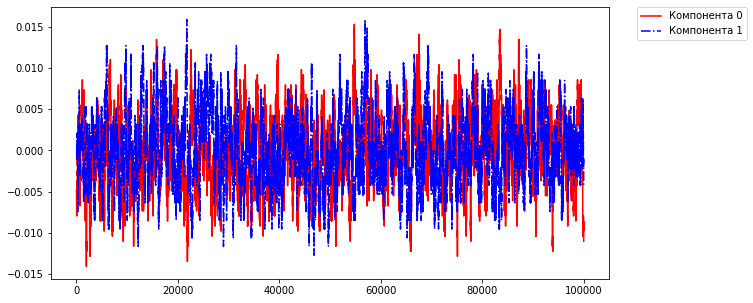

p = [33, 34, 27]
with cycle, beta = 10


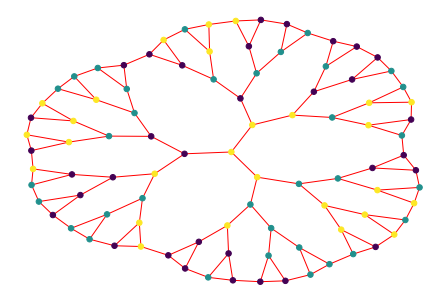

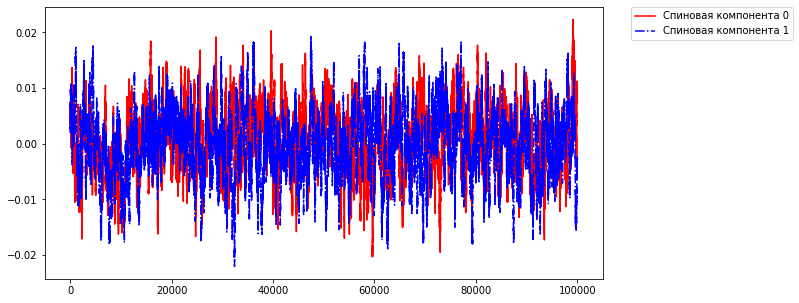

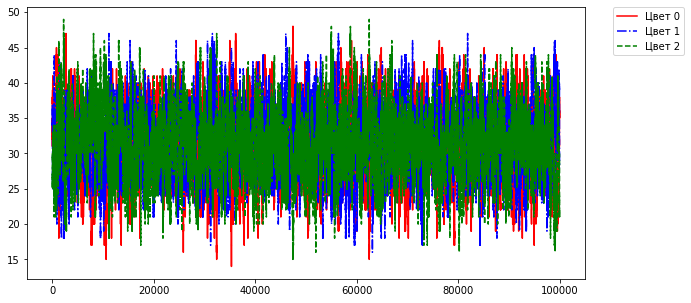

p = [36, 28, 30]
zero point
transp Y = [[-0.05763901 -0.05763901 -0.05763901 ... -0.02737973 -0.02737973
  -0.02737973]
 [-0.00166251 -0.00166251 -0.00166251 ...  0.0507481   0.0507481
   0.0507481 ]]


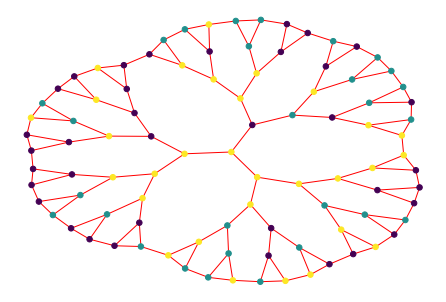

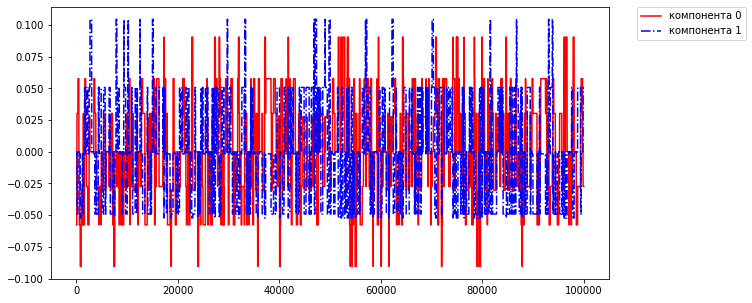

colors of branches
epoch = 0


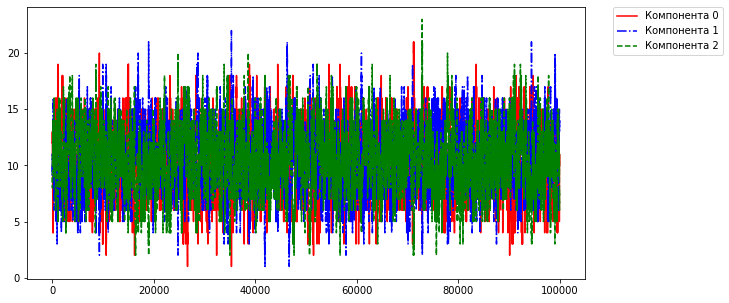

epoch = 1


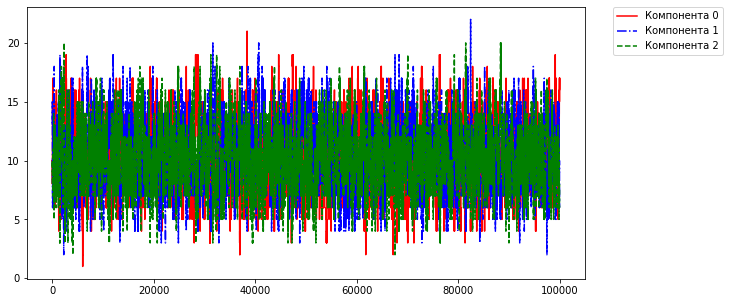

epoch = 2


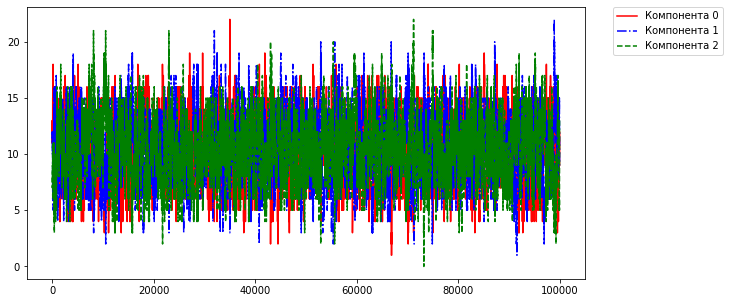

Branches
epoch = 0


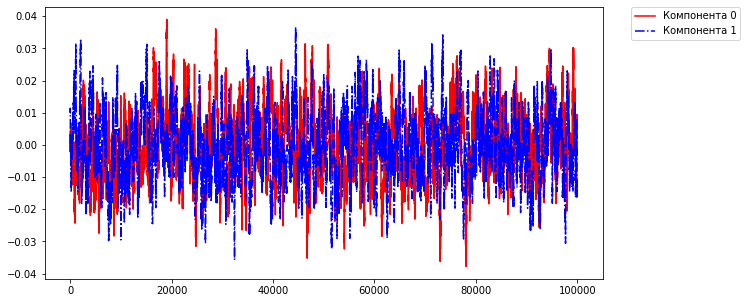

epoch = 1


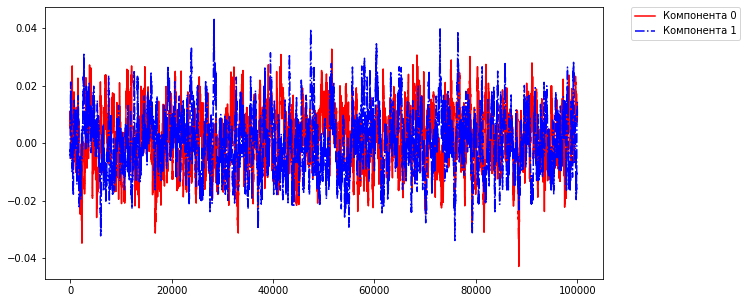

epoch = 2


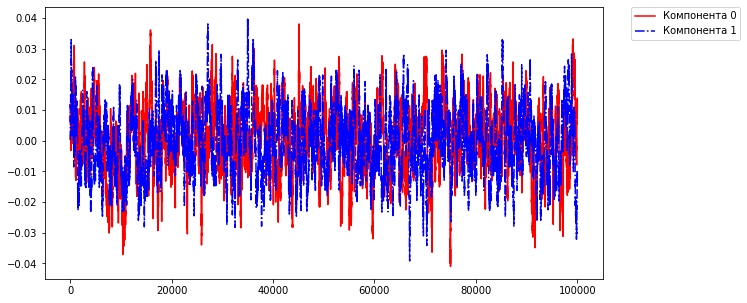

Circles
epoch = 0


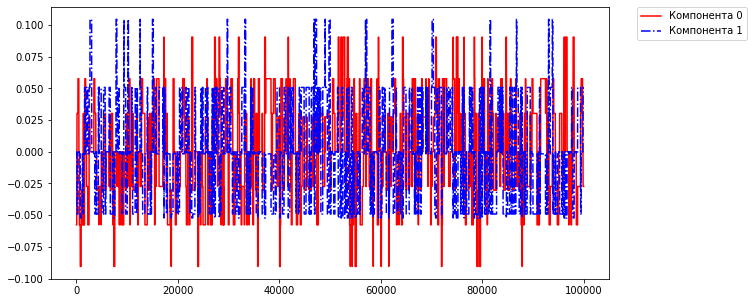

epoch = 1


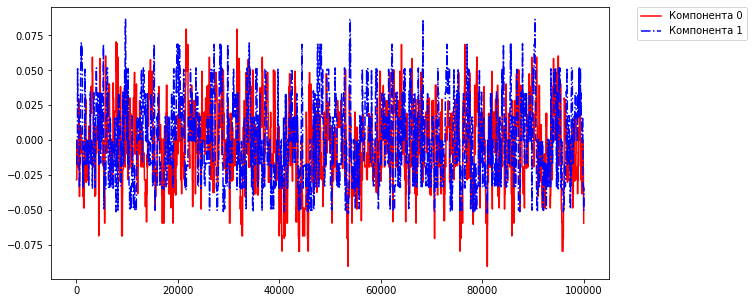

epoch = 2


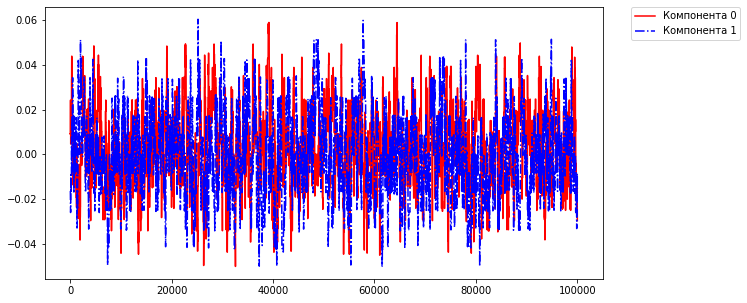

epoch = 3


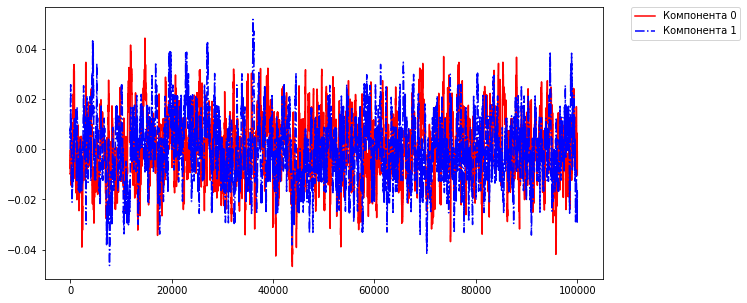

epoch = 4


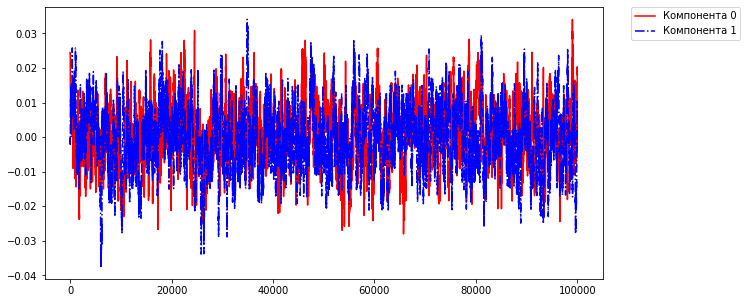

epoch = 5


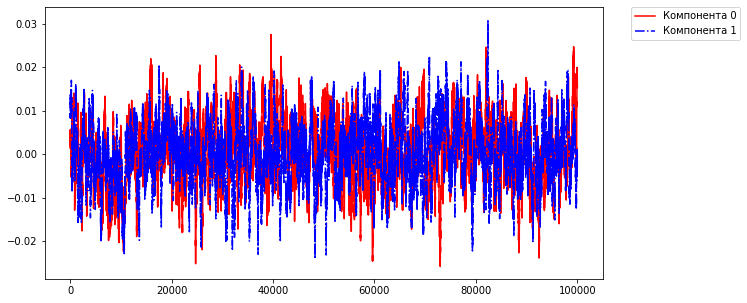

debug zero pre = 1
p = [31, 31, 32]
debug zero past = 1
without cycle, beta = 1


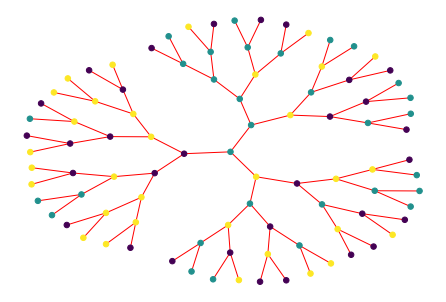

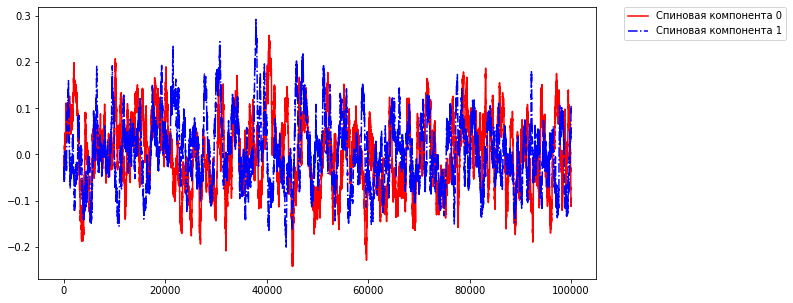

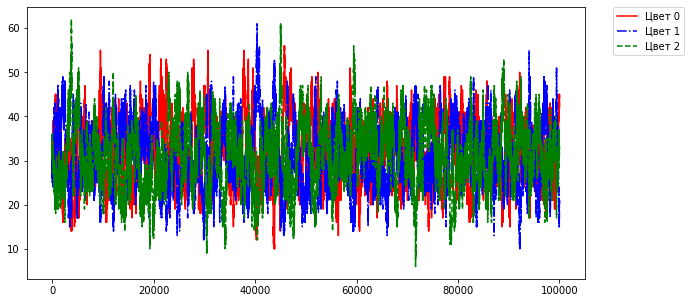

p = [43, 20, 31]
zero point
transp Y = [[ 0.          0.          0.         ... -0.36417449 -0.36417449
  -0.36417449]
 [ 0.          0.          0.         ... -0.36495414 -0.36495414
  -0.36495414]]


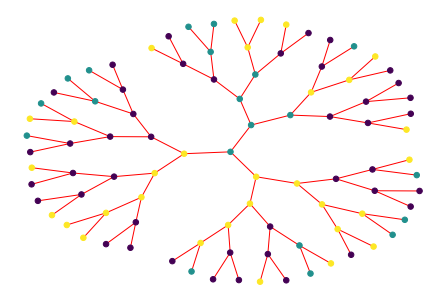

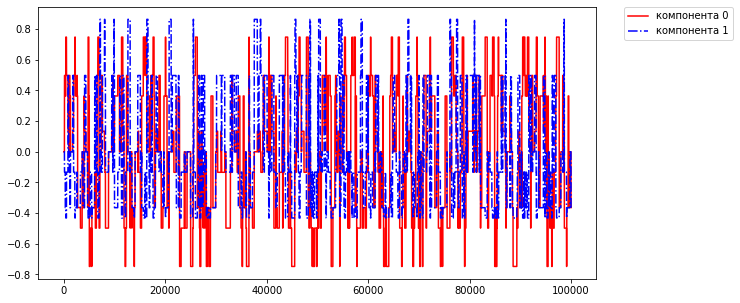

colors of branches
epoch = 0


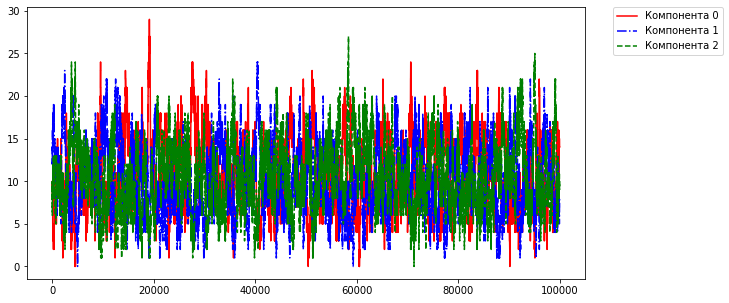

epoch = 1


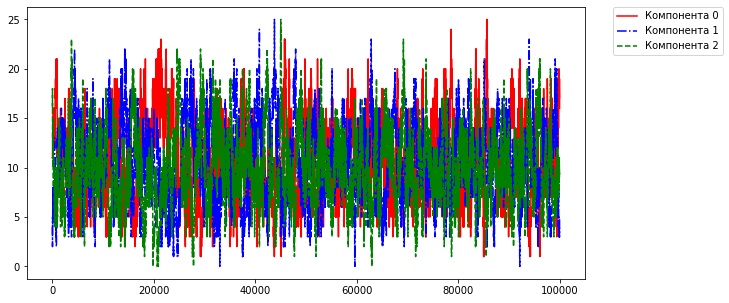

epoch = 2


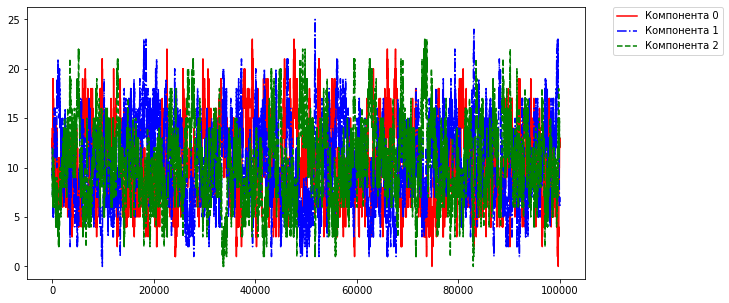

Branches
epoch = 0


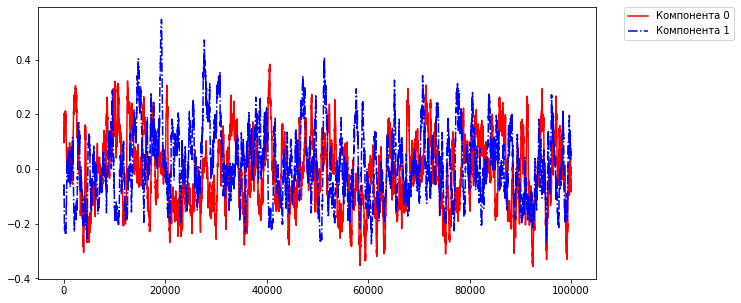

epoch = 1


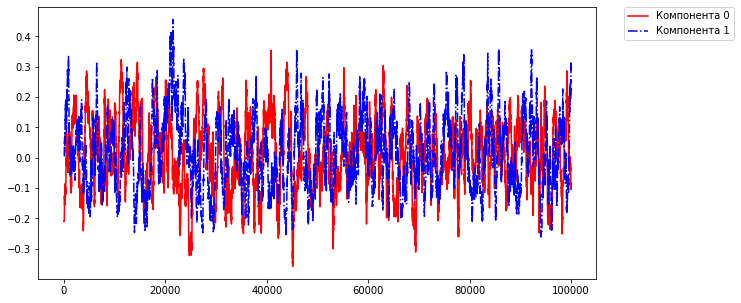

epoch = 2


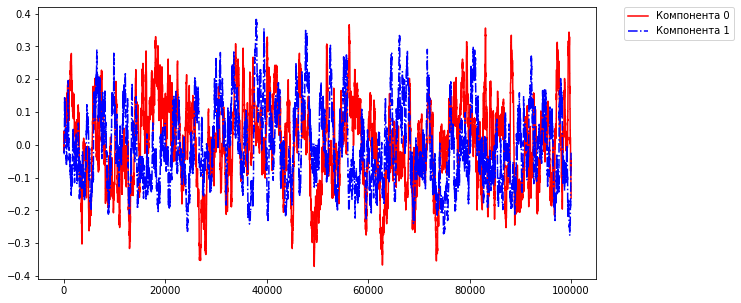

Circles
epoch = 0


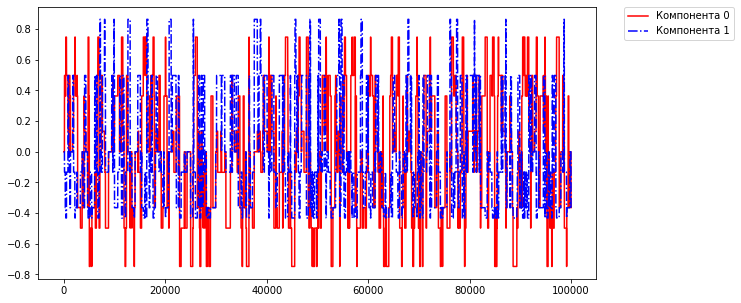

epoch = 1


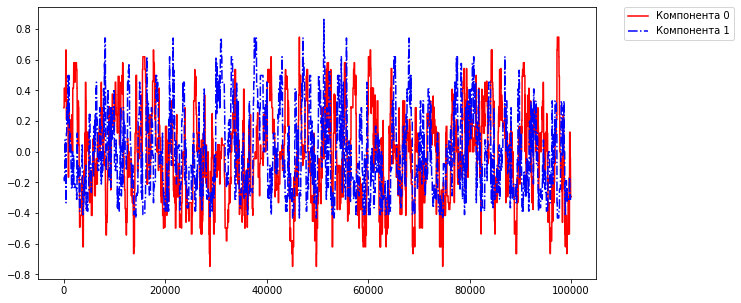

epoch = 2


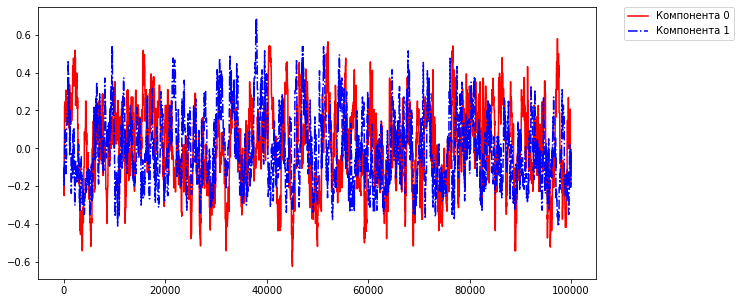

epoch = 3


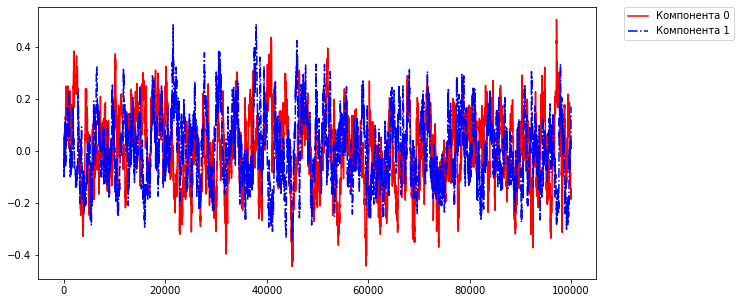

epoch = 4


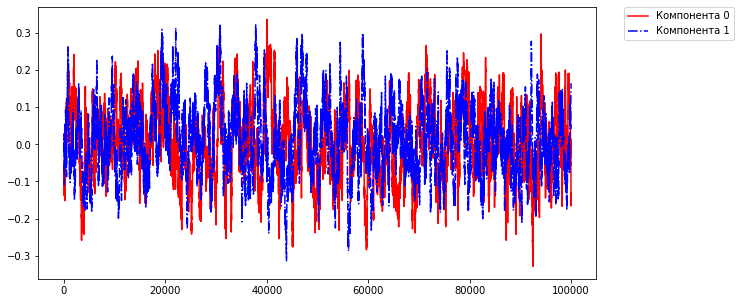

epoch = 5


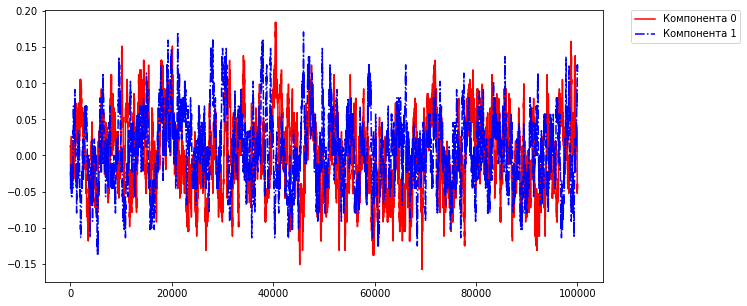

p = [36, 28, 30]
with cycle, beta = 1


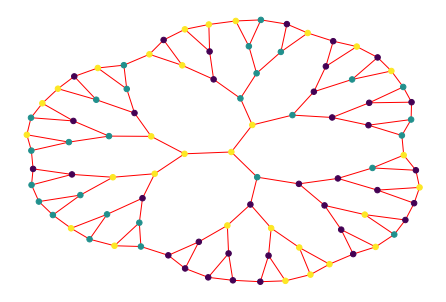

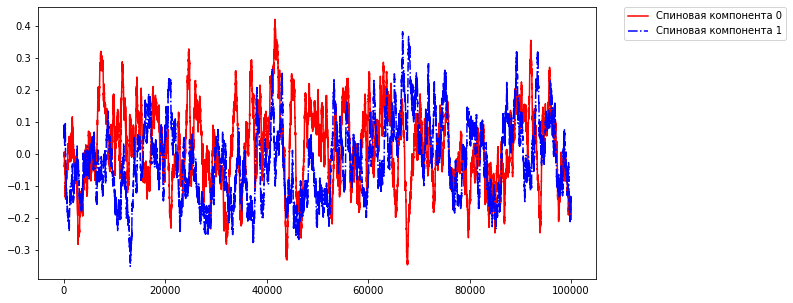

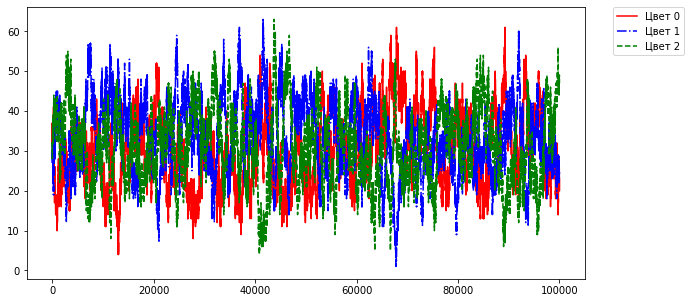

p = [23, 24, 47]
zero point
transp Y = [[-0.36417449 -0.36417449 -0.36417449 ... -0.74838841 -0.74838841
  -0.74838841]
 [-0.36495414 -0.36495414 -0.36495414 ... -0.43208225 -0.43208225
  -0.43208225]]


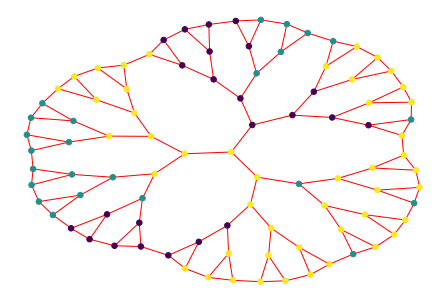

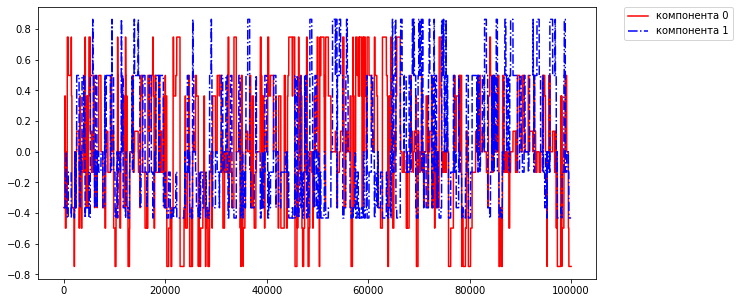

colors of branches
epoch = 0


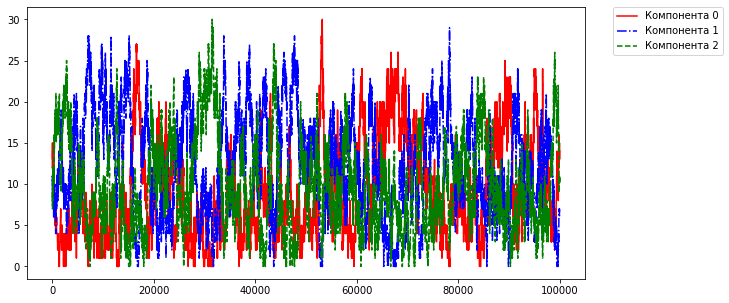

epoch = 1


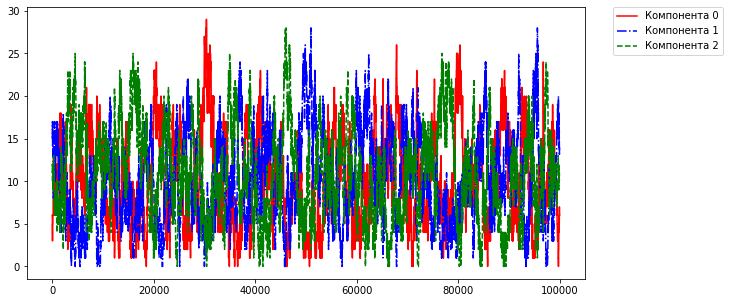

epoch = 2


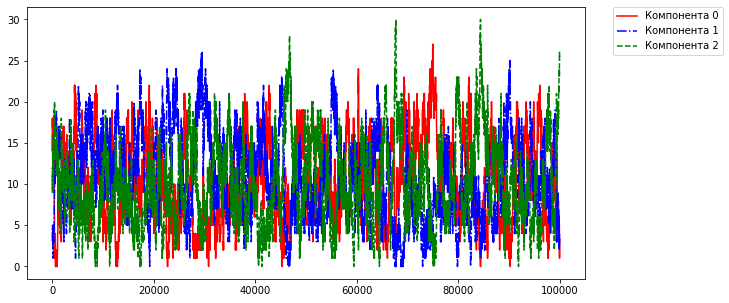

Branches
epoch = 0


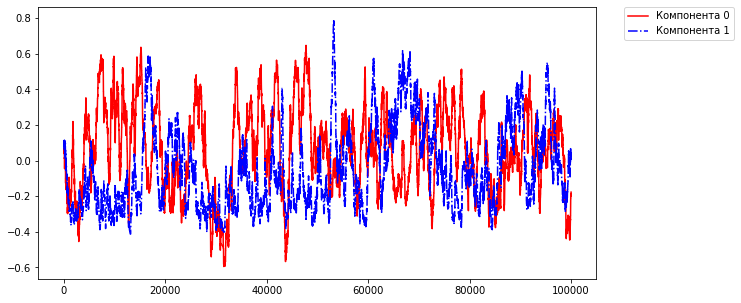

epoch = 1


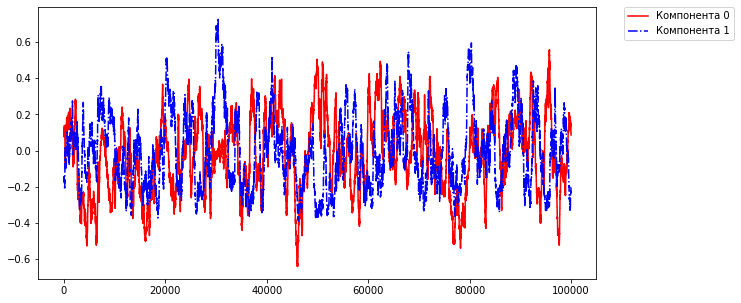

epoch = 2


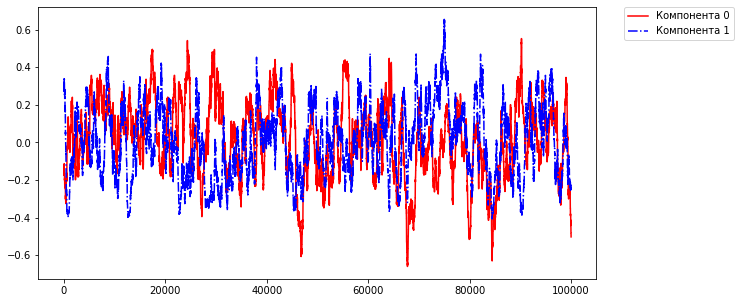

Circles
epoch = 0


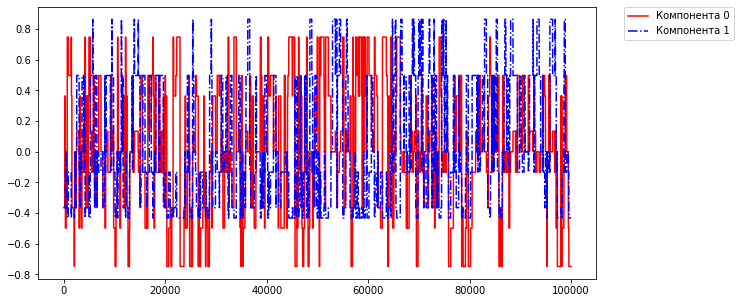

epoch = 1


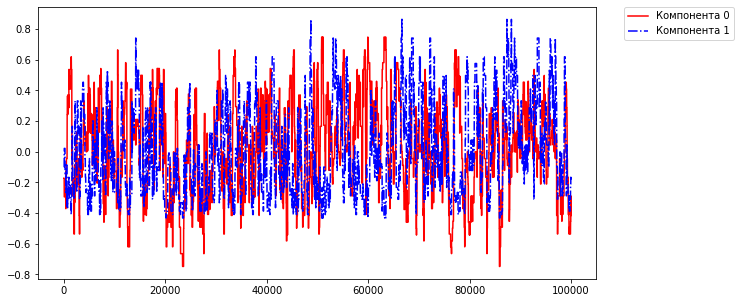

epoch = 2


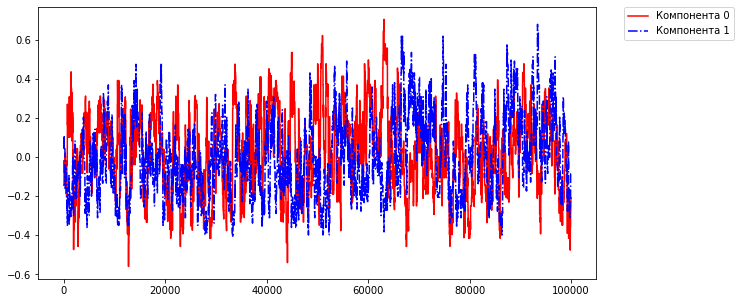

epoch = 3


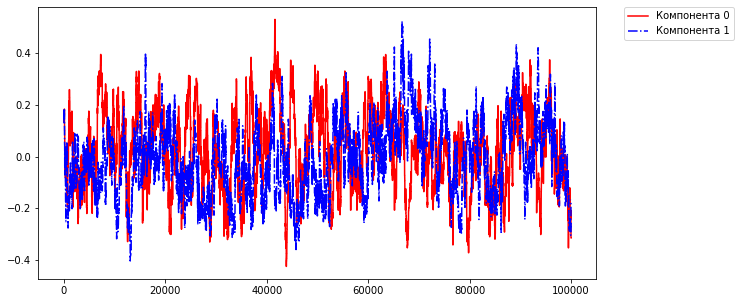

epoch = 4


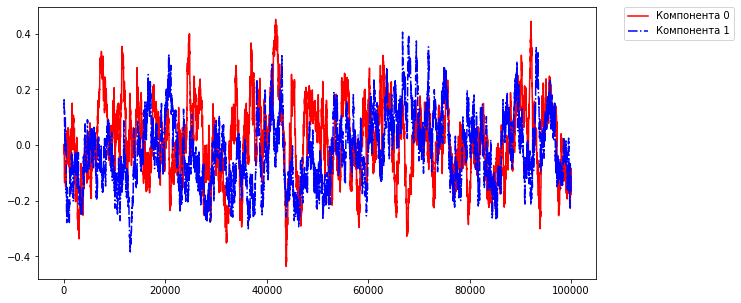

epoch = 5


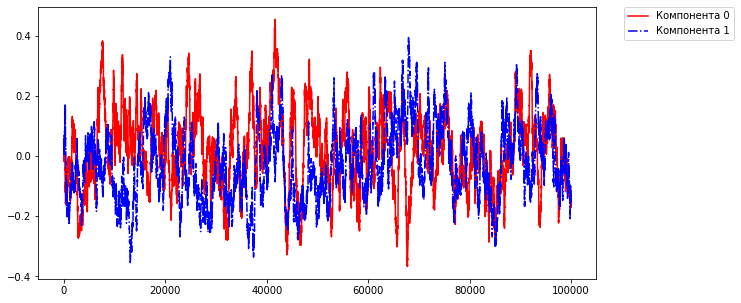

debug zero pre = 2
p = [35, 26, 33]
debug zero past = 2
without cycle, beta = 0.8


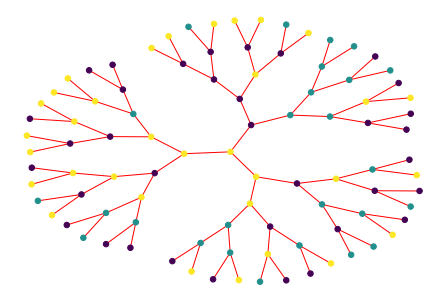

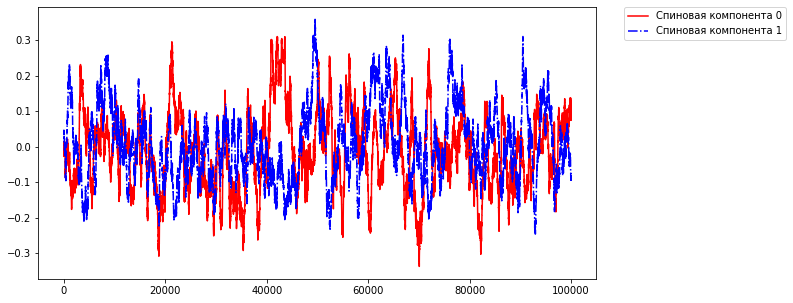

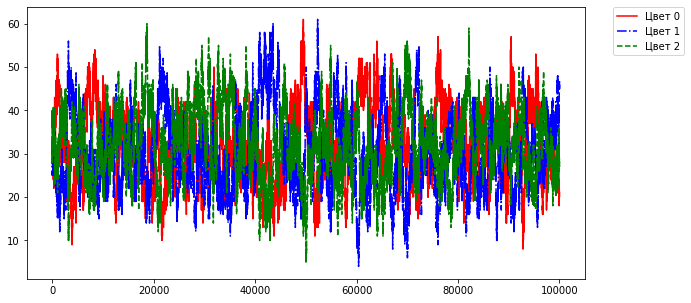

p = [21, 45, 28]
zero point
transp Y = [[-0.58084439 -0.58084439 -0.58084439 ... -0.45149027 -0.45149027
  -0.45149027]
 [-0.18598539 -0.18598539 -0.18598539 ... -0.41003331 -0.41003331
  -0.41003331]]


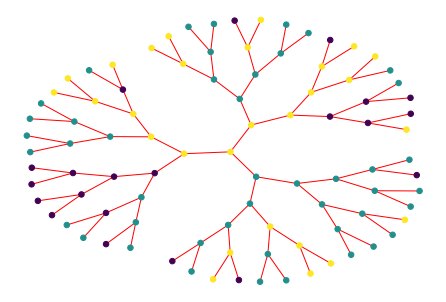

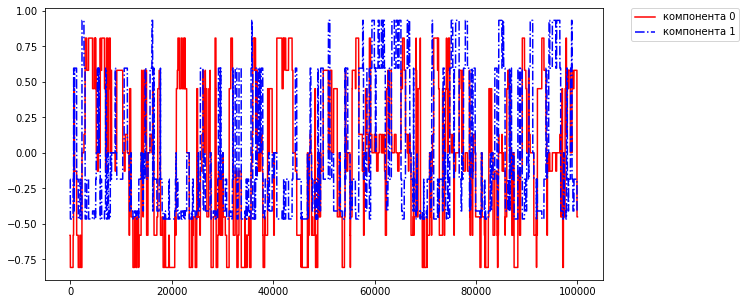

colors of branches
epoch = 0


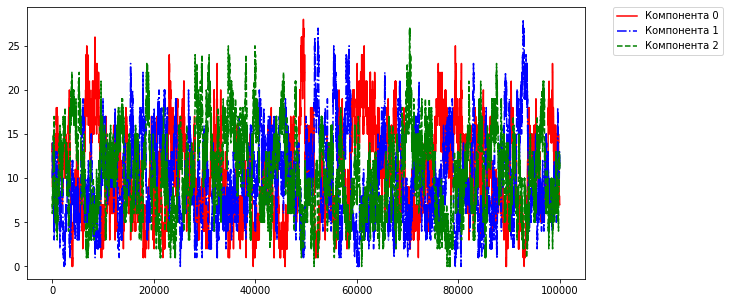

epoch = 1


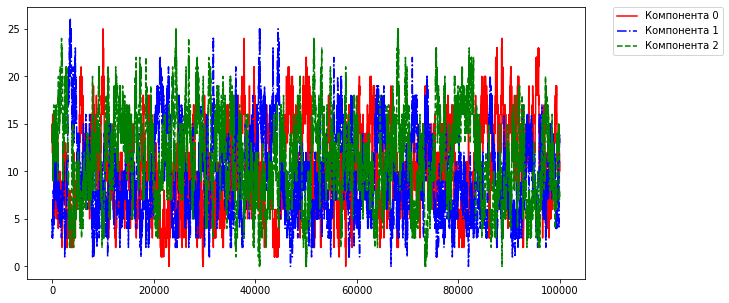

epoch = 2


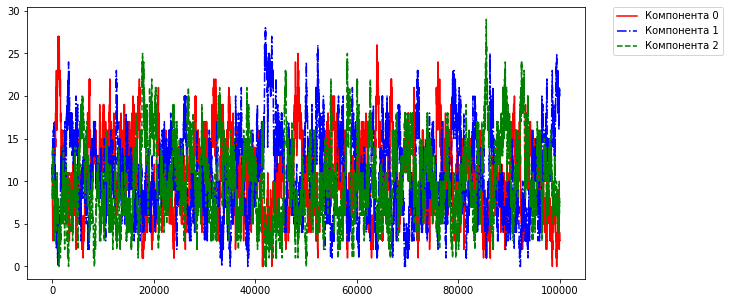

Branches
epoch = 0


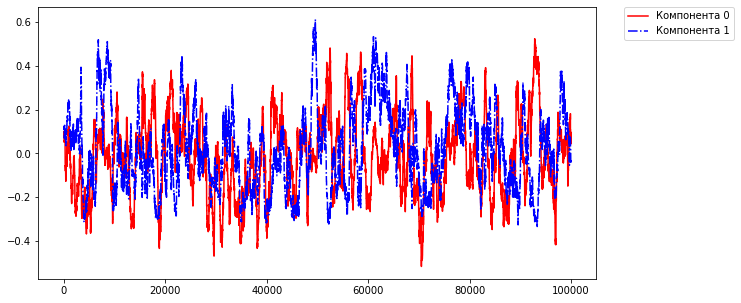

epoch = 1


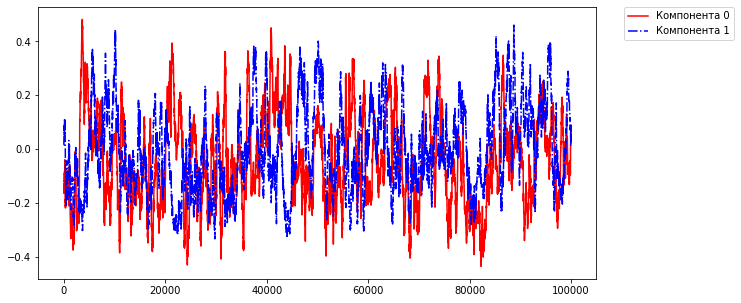

epoch = 2


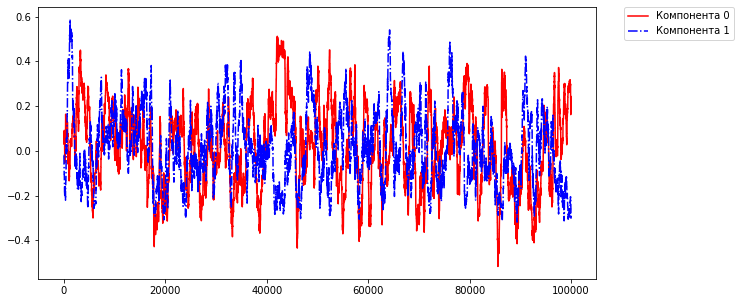

Circles
epoch = 0


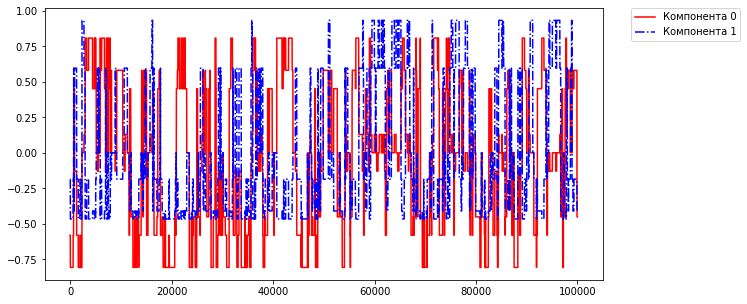

epoch = 1


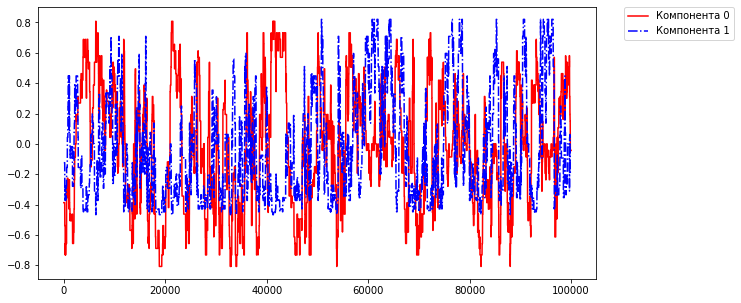

epoch = 2


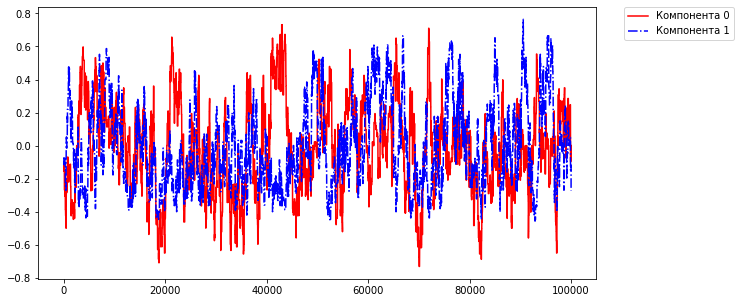

epoch = 3


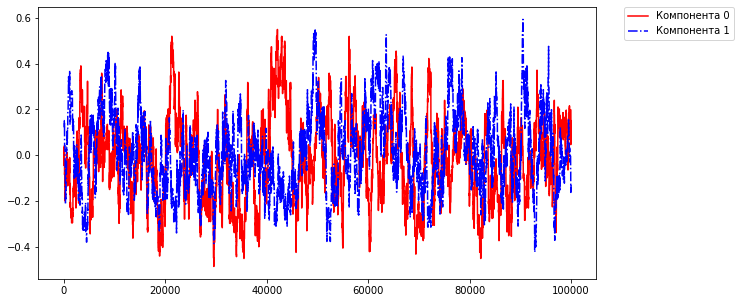

epoch = 4


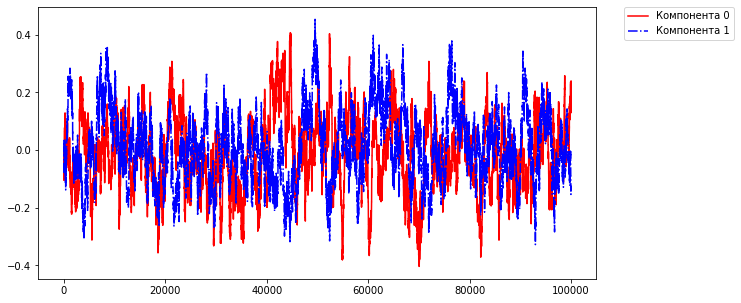

epoch = 5


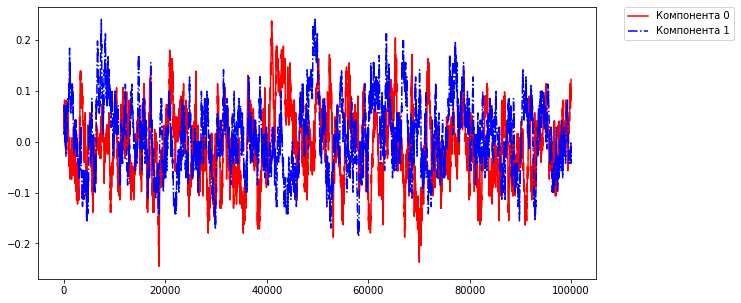

p = [34, 23, 37]
with cycle, beta = 0.8


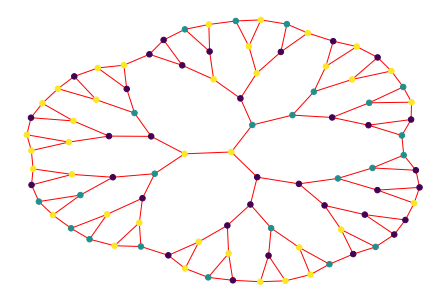

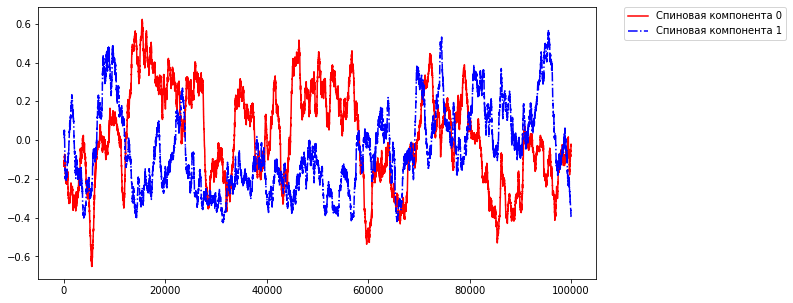

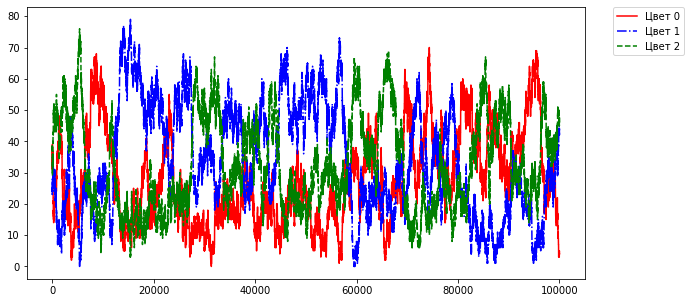

p = [4, 44, 46]
zero point
transp Y = [[0.         0.         0.         ... 0.12935413 0.12935413 0.12935413]
 [0.         0.         0.         ... 0.59601869 0.59601869 0.59601869]]


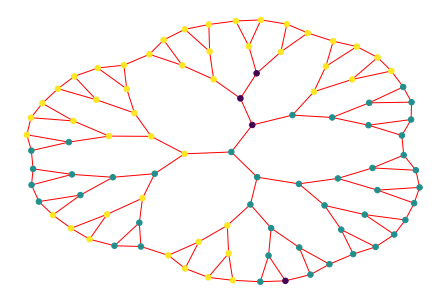

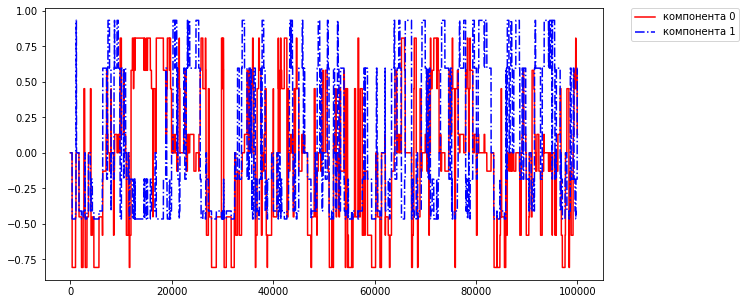

colors of branches
epoch = 0


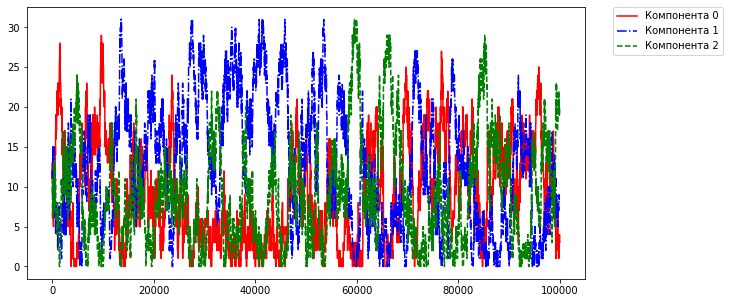

epoch = 1


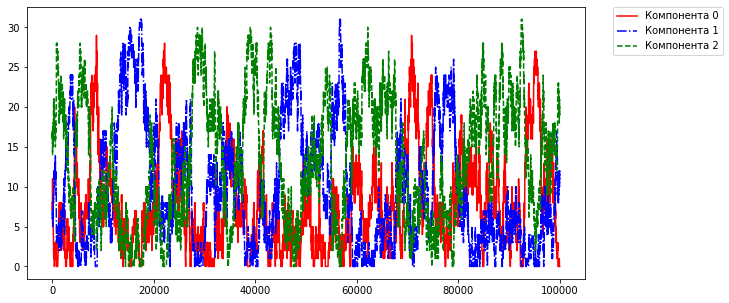

epoch = 2


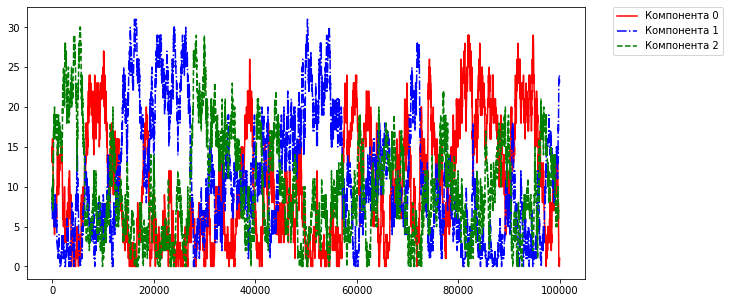

Branches
epoch = 0


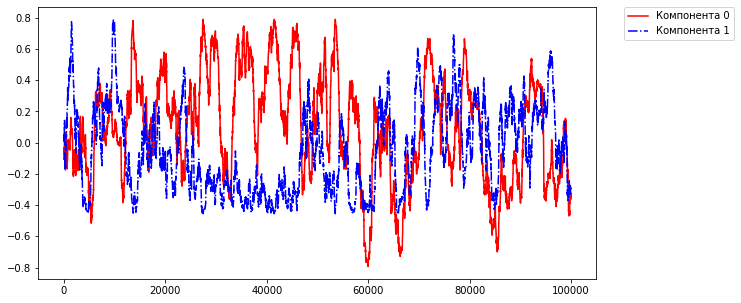

epoch = 1


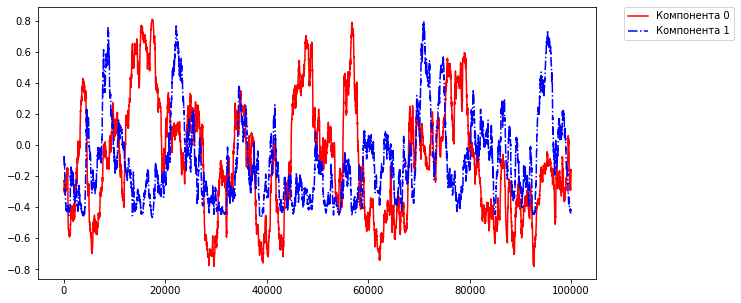

epoch = 2


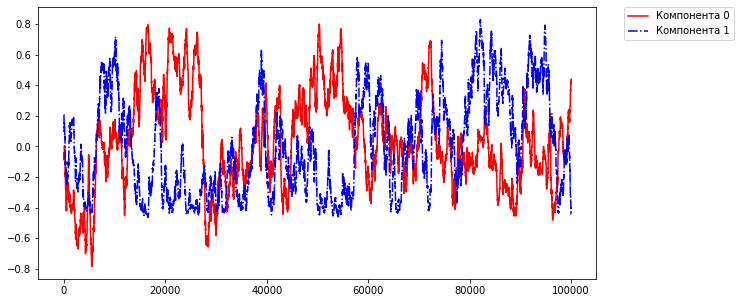

Circles
epoch = 0


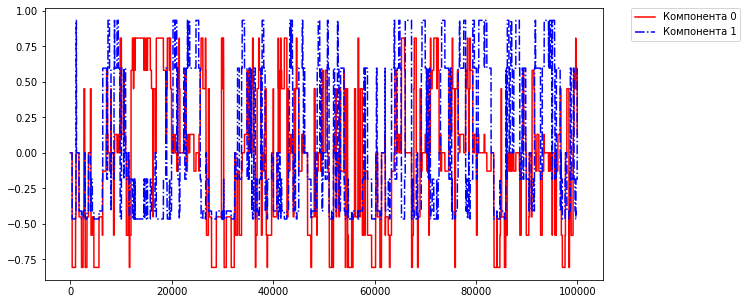

epoch = 1


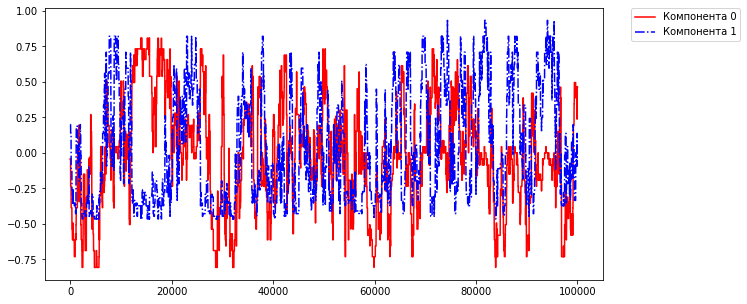

epoch = 2


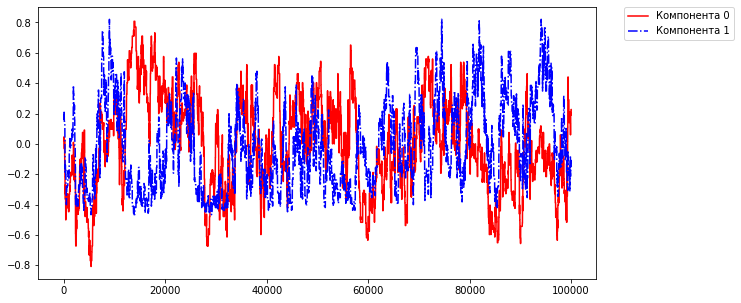

epoch = 3


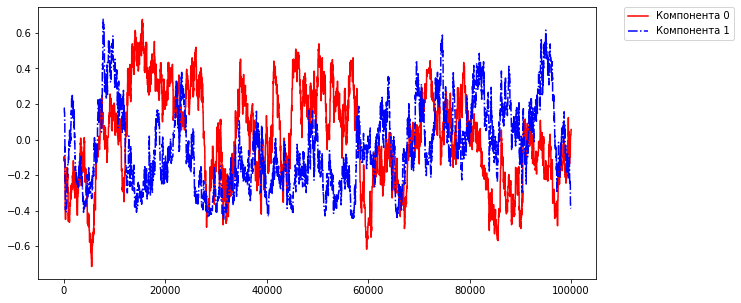

epoch = 4


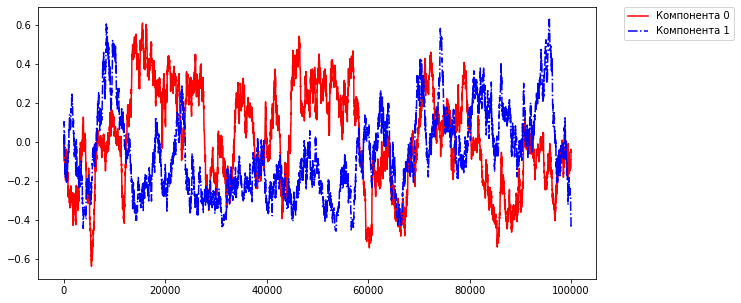

epoch = 5


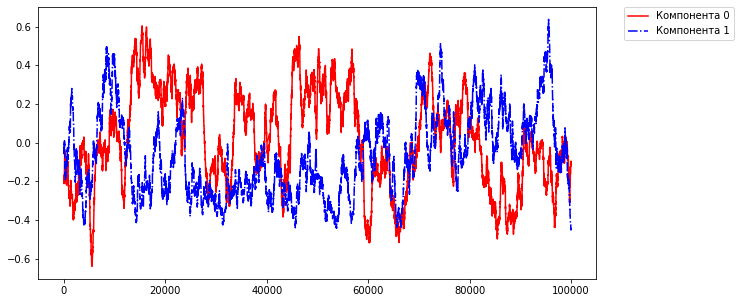

debug zero pre = 1
p = [29, 34, 31]
debug zero past = 2
without cycle, beta = 0.6


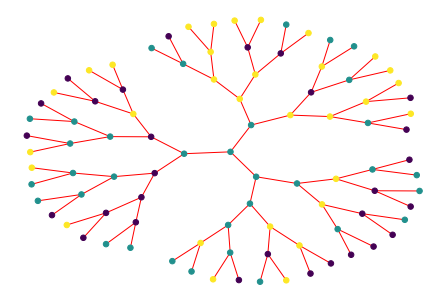

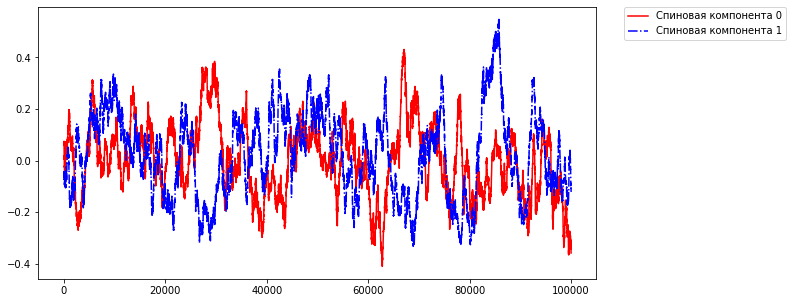

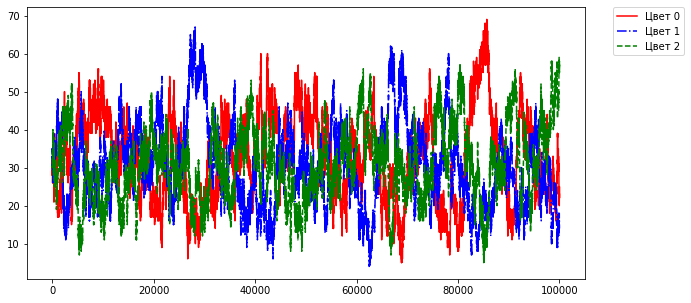

p = [23, 14, 57]
zero point
transp Y = [[ 0.84875247  0.84875247  0.84875247 ... -0.6819902  -0.6819902
  -0.6819902 ]
 [-0.49002747 -0.49002747 -0.49002747 ... -0.26863869 -0.26863869
  -0.26863869]]


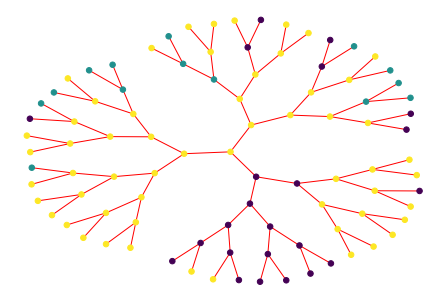

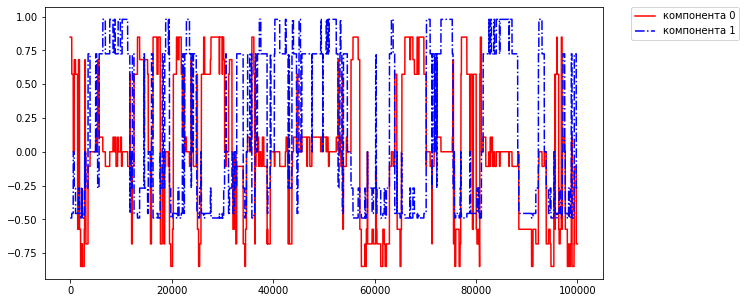

colors of branches
epoch = 0


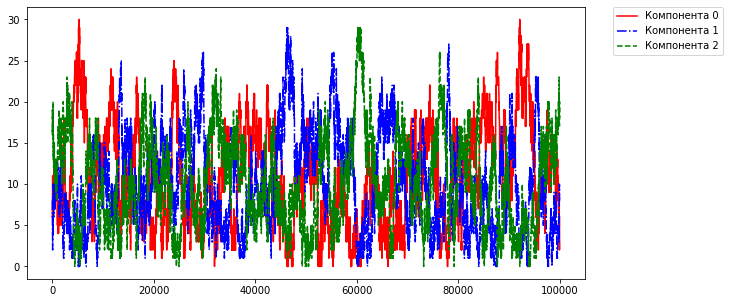

epoch = 1


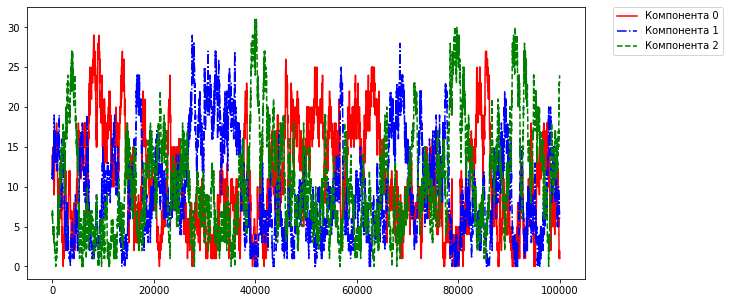

epoch = 2


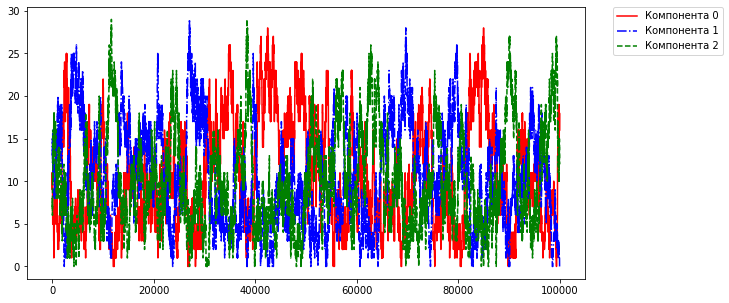

Branches
epoch = 0


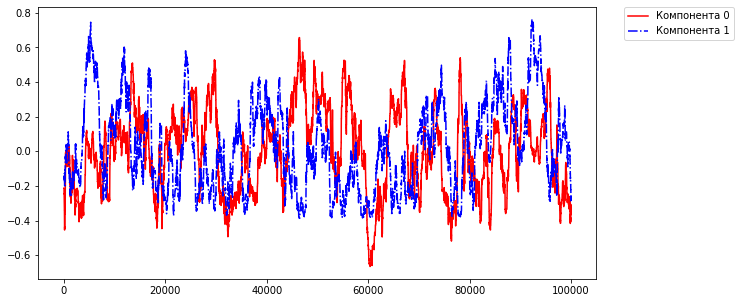

epoch = 1


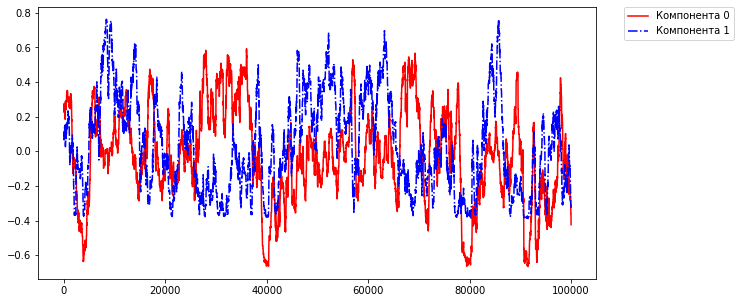

epoch = 2


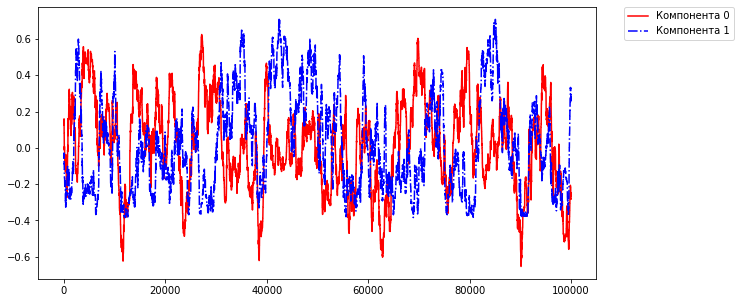

Circles
epoch = 0


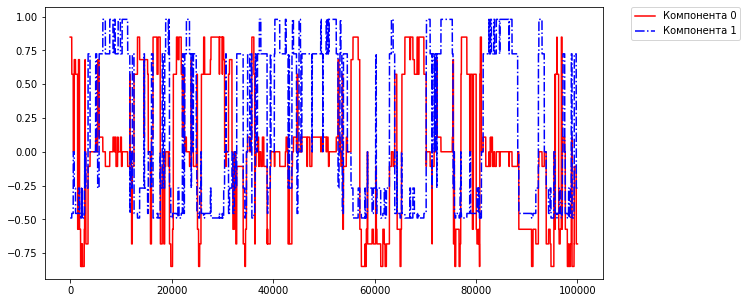

epoch = 1


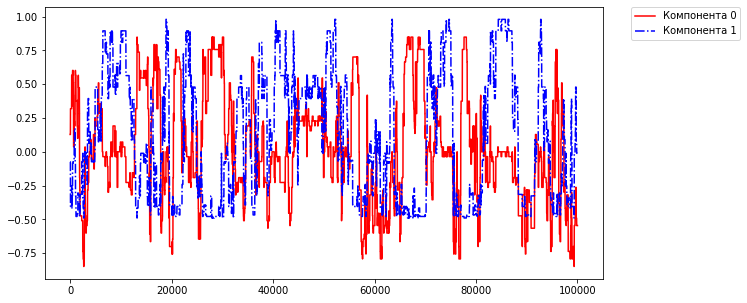

epoch = 2


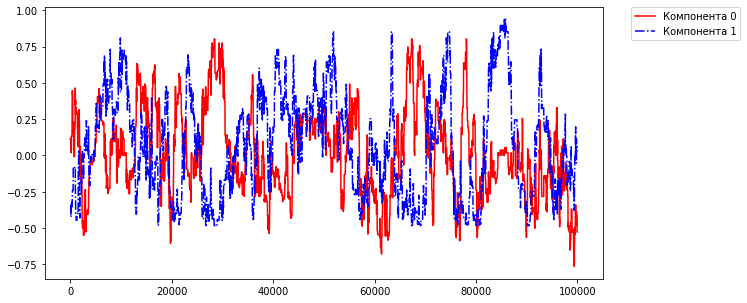

epoch = 3


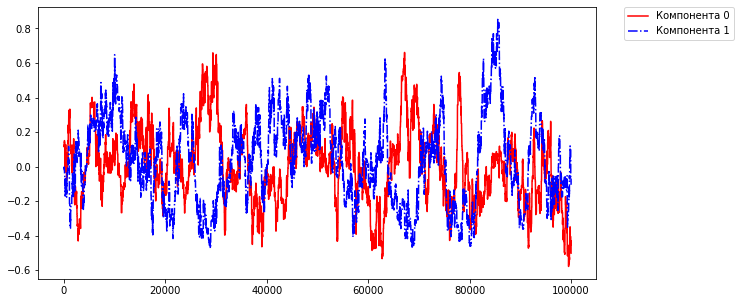

epoch = 4


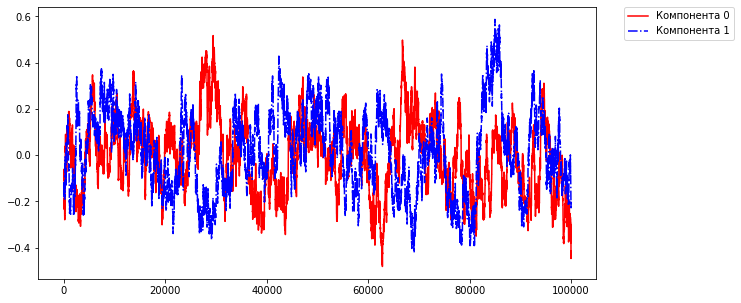

epoch = 5


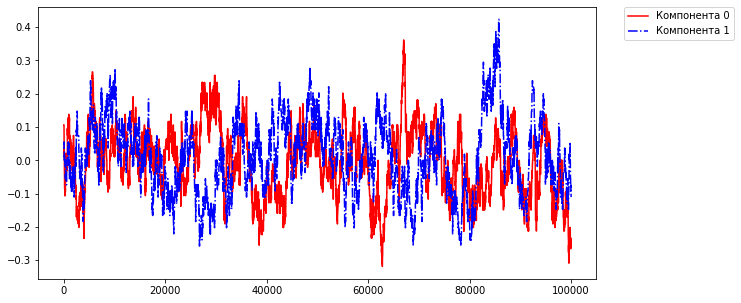

p = [28, 37, 29]
with cycle, beta = 0.6


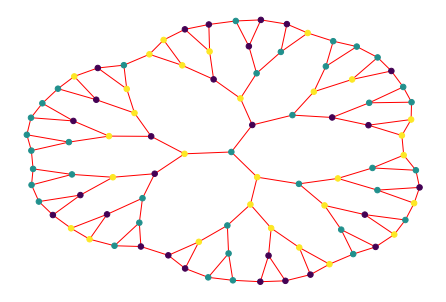

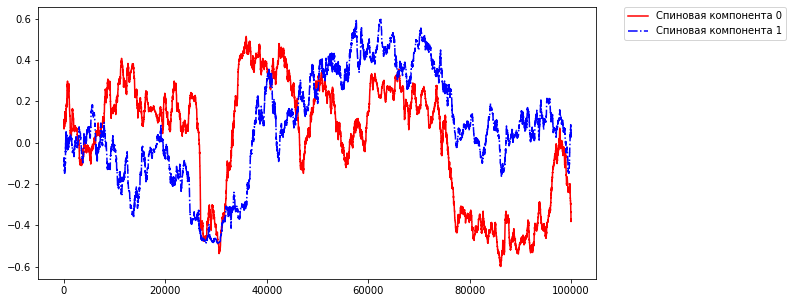

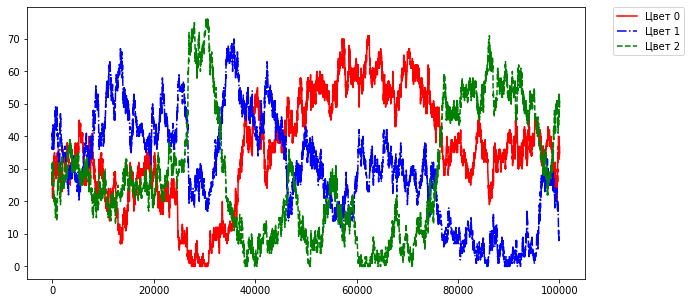

p = [35, 8, 51]
zero point
transp Y = [[-0.6819902  -0.6819902  -0.6819902  ...  0.         -0.6819902
  -0.6819902 ]
 [-0.26863869 -0.26863869 -0.26863869 ...  0.98005494 -0.26863869
  -0.26863869]]


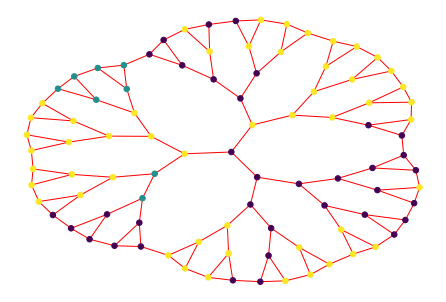

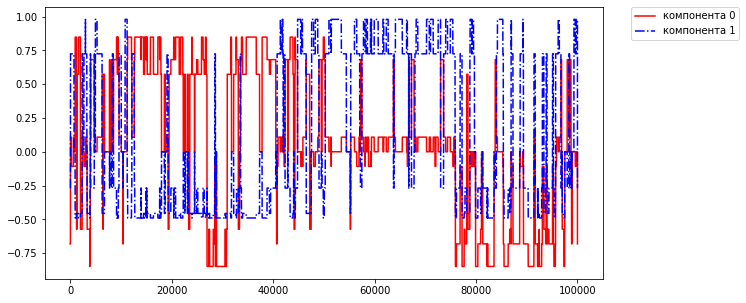

colors of branches
epoch = 0


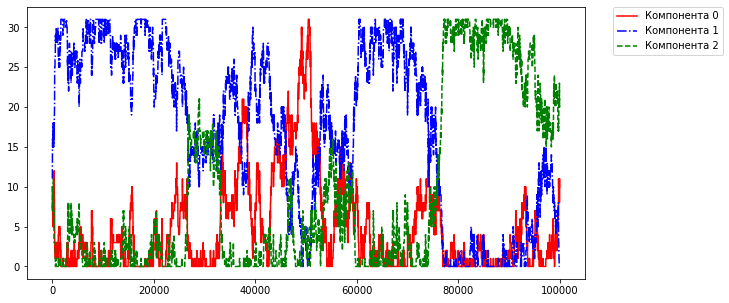

epoch = 1


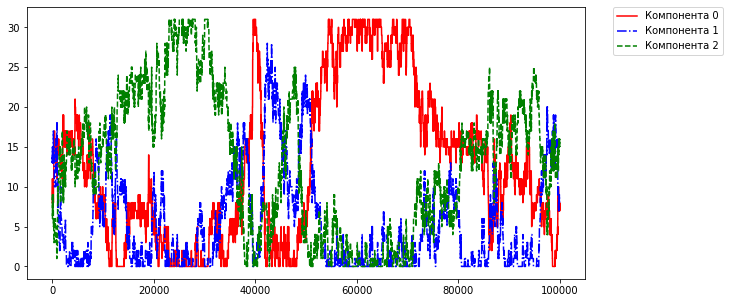

epoch = 2


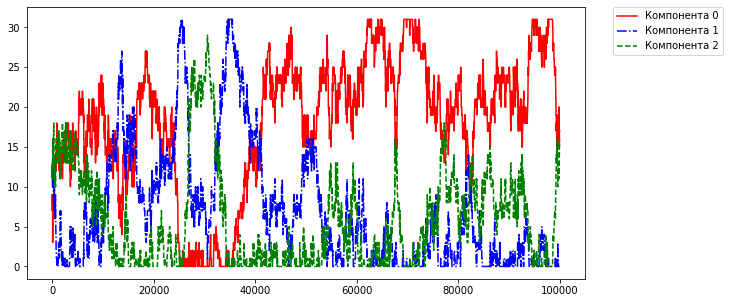

Branches
epoch = 0


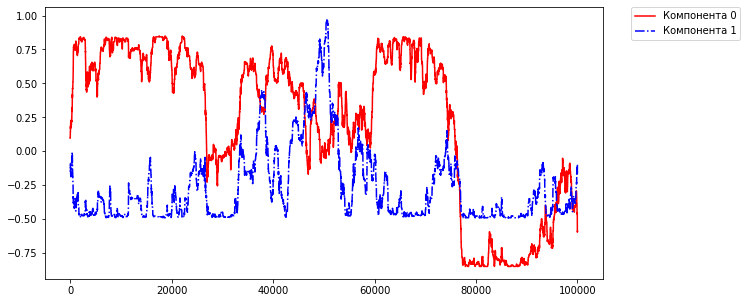

epoch = 1


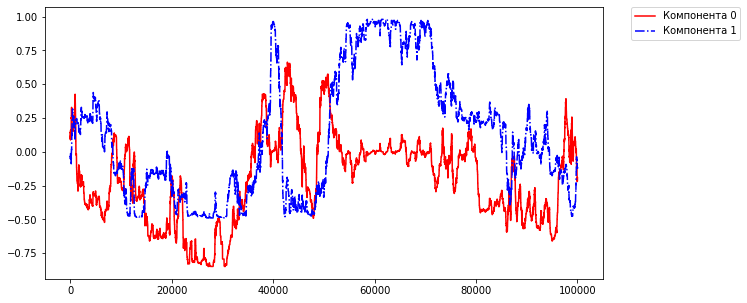

epoch = 2


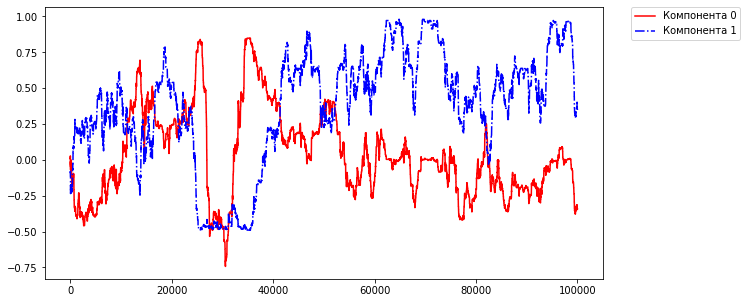

Circles
epoch = 0


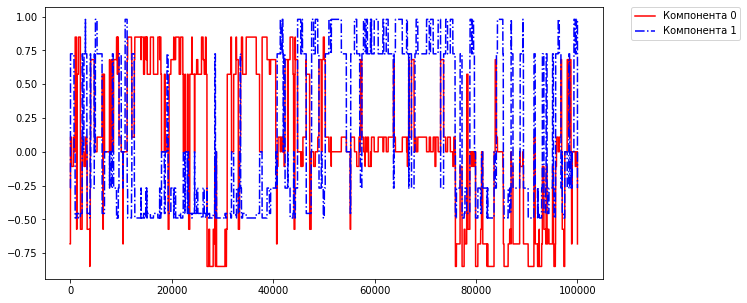

epoch = 1


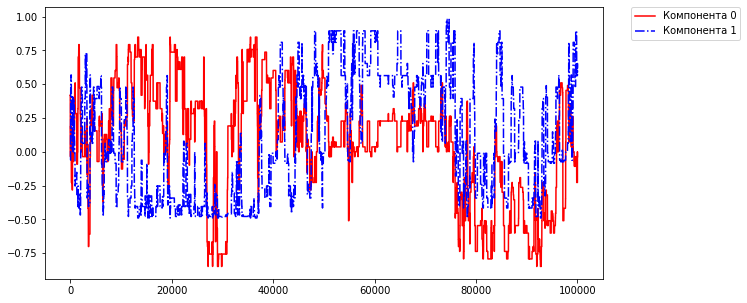

epoch = 2


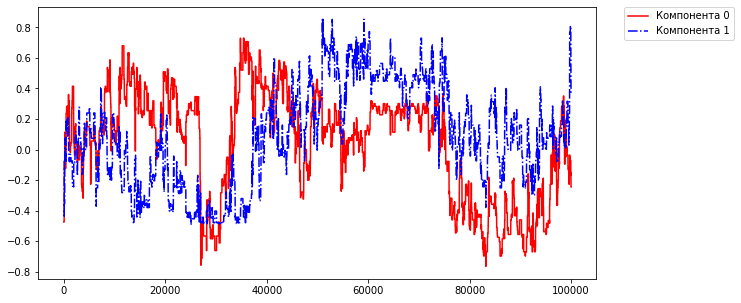

epoch = 3


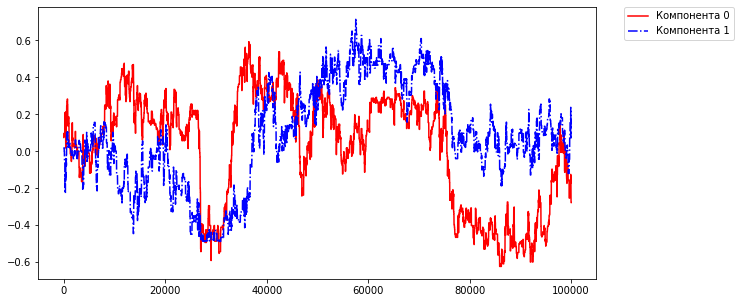

epoch = 4


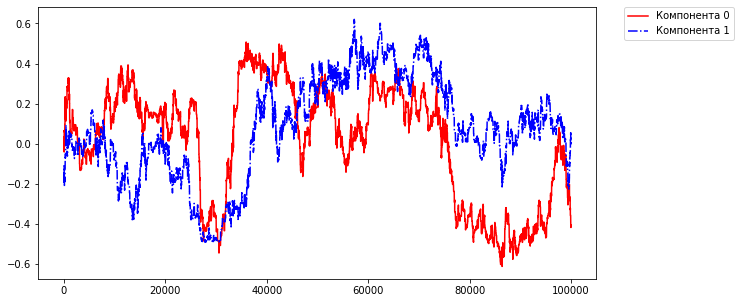

epoch = 5


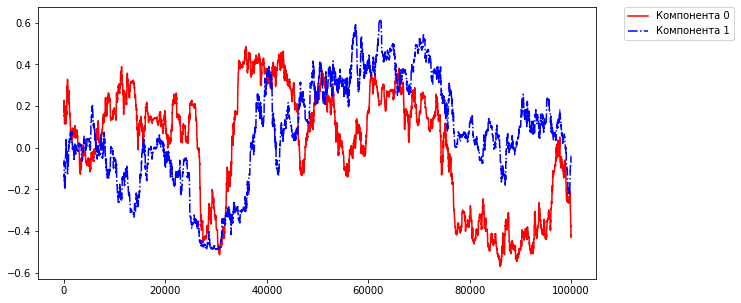

debug zero pre = 1
p = [32, 31, 31]
debug zero past = 2
without cycle, beta = 0.4


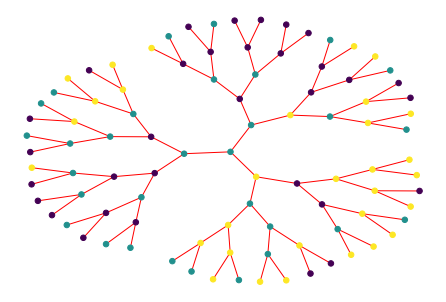

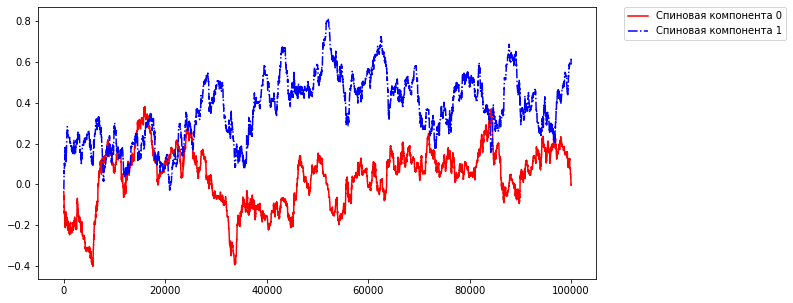

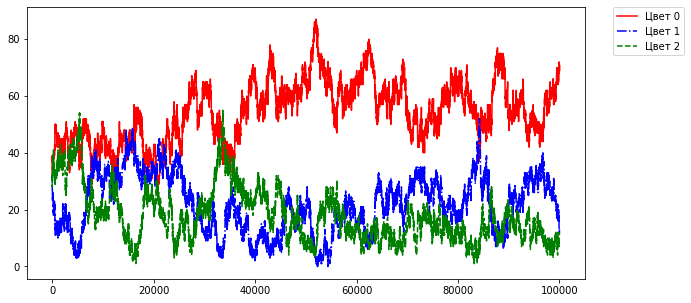

p = [69, 13, 12]
zero point
transp Y = [[ 0.73008905  0.73008905  0.73008905 ... -0.05992936 -0.05992936
  -0.05992936]
 [-0.49071757 -0.49071757 -0.49071757 ...  0.87763445  0.87763445
   0.87763445]]


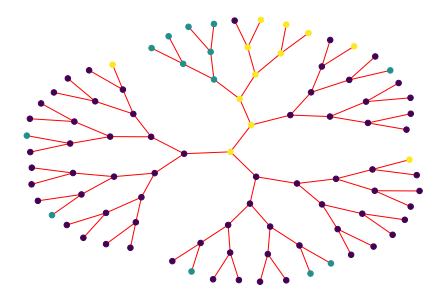

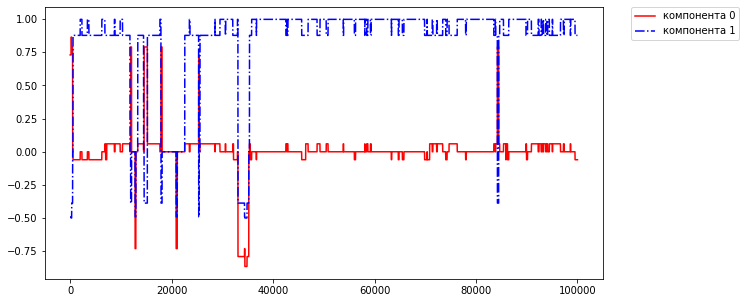

colors of branches
epoch = 0


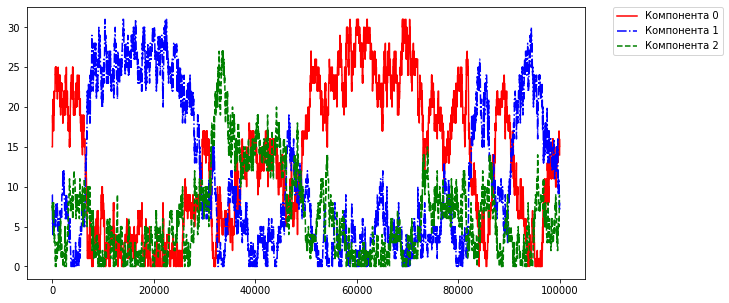

epoch = 1


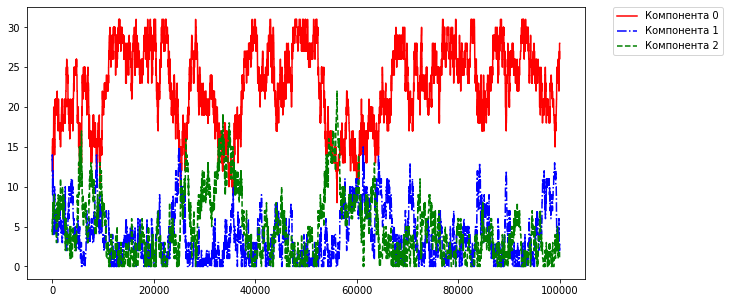

epoch = 2


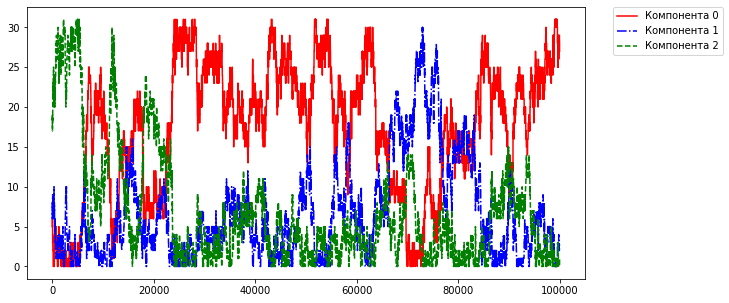

Branches
epoch = 0


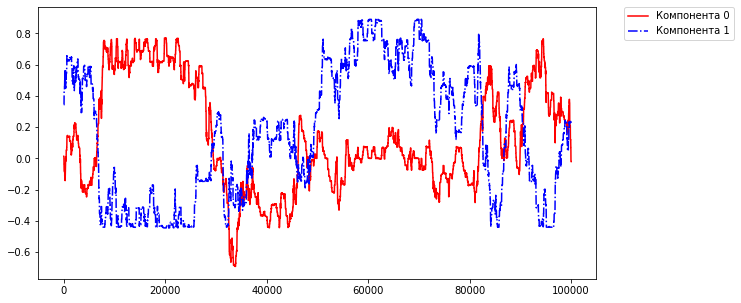

epoch = 1


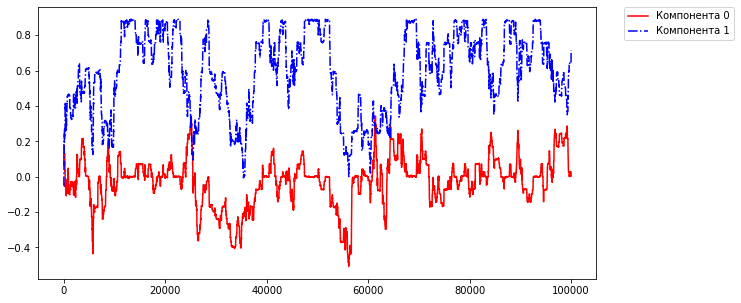

epoch = 2


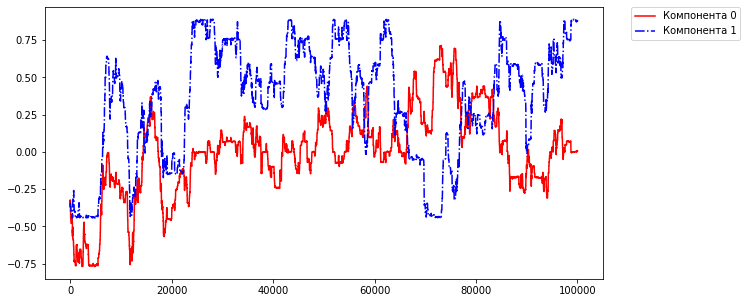

Circles
epoch = 0


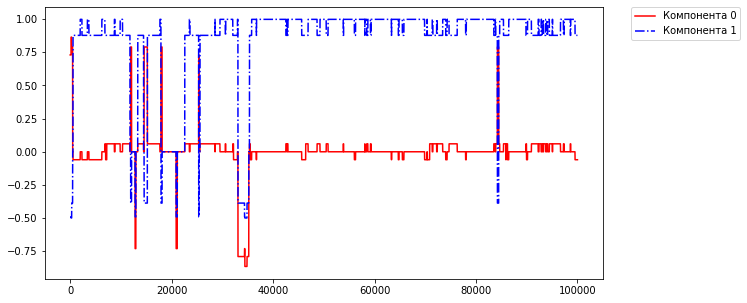

epoch = 1


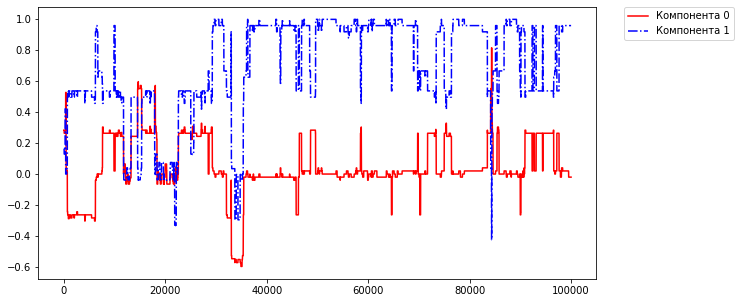

epoch = 2


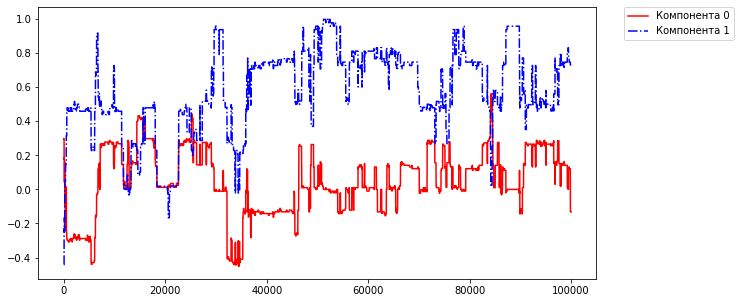

epoch = 3


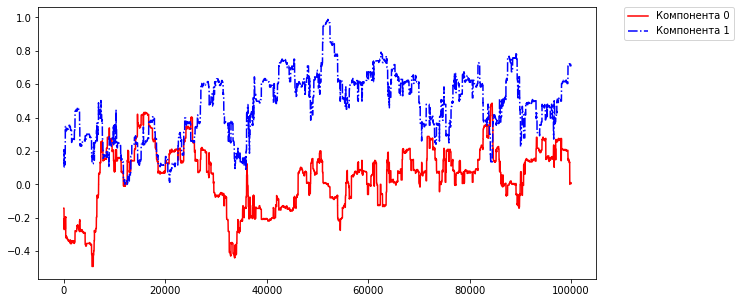

epoch = 4


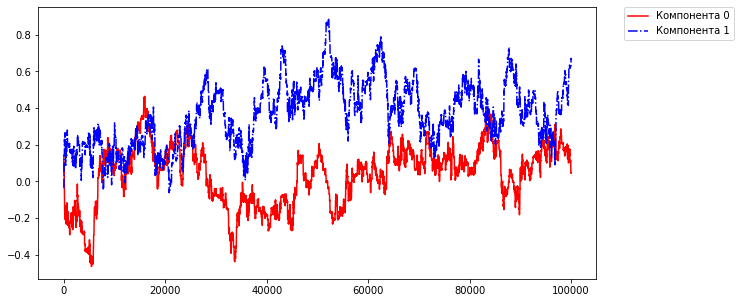

epoch = 5


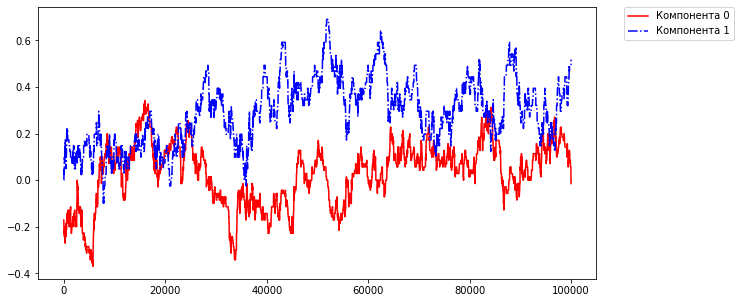

p = [29, 31, 34]
with cycle, beta = 0.4


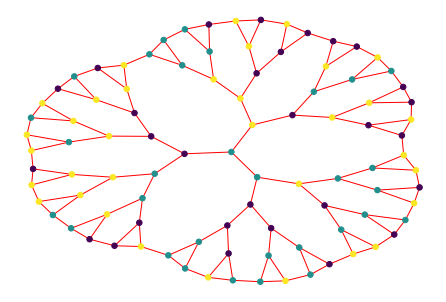

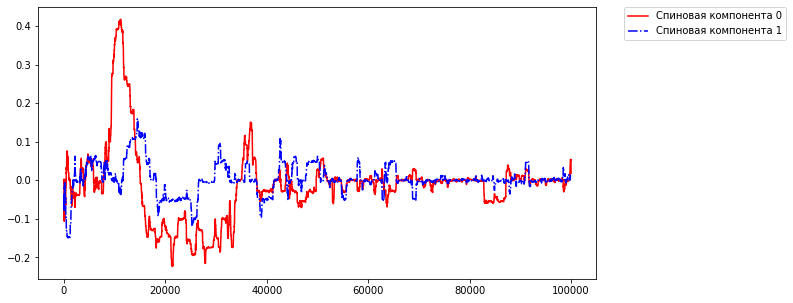

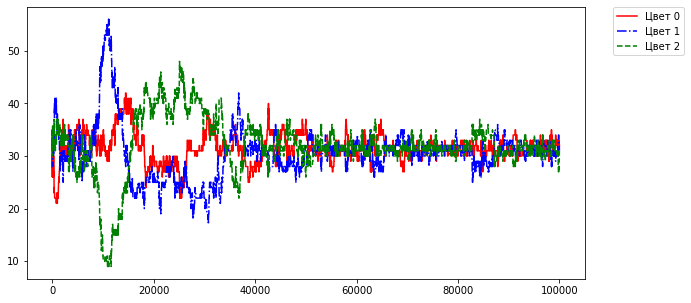

p = [32, 31, 31]
zero point
transp Y = [[0.         0.         0.         ... 0.05992936 0.05992936 0.05992936]
 [0.         0.         0.         ... 0.87763445 0.87763445 0.87763445]]


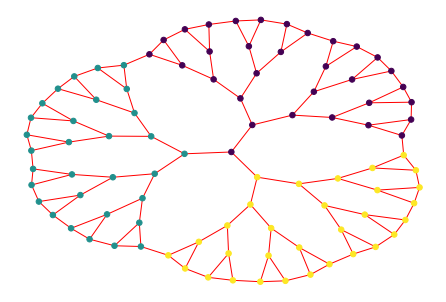

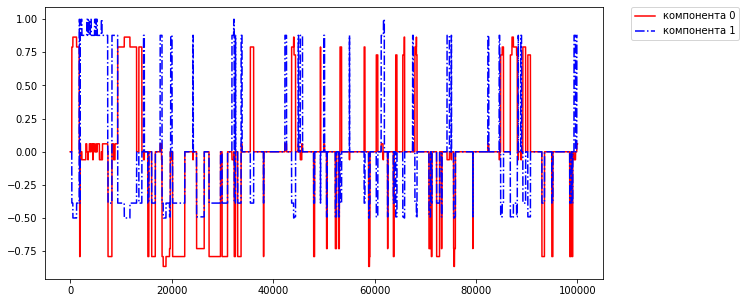

colors of branches
epoch = 0


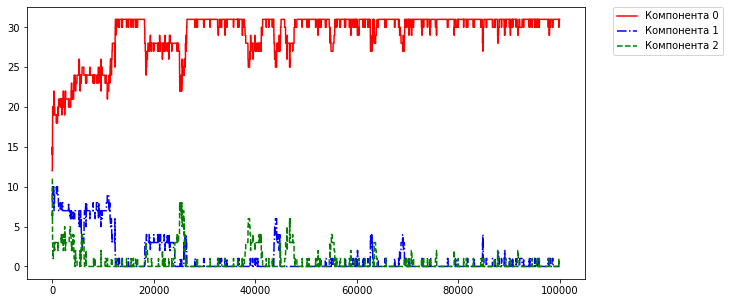

epoch = 1


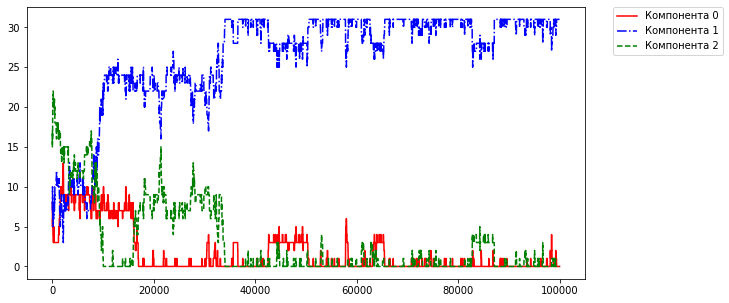

epoch = 2


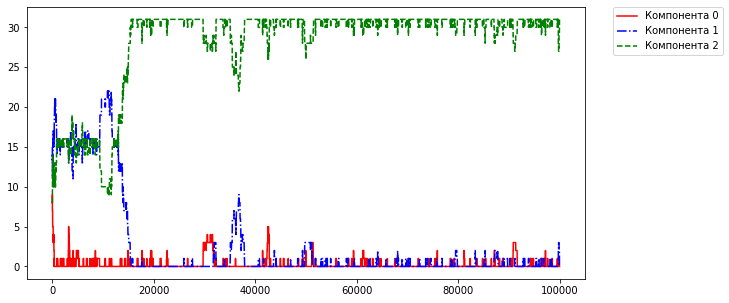

Branches
epoch = 0


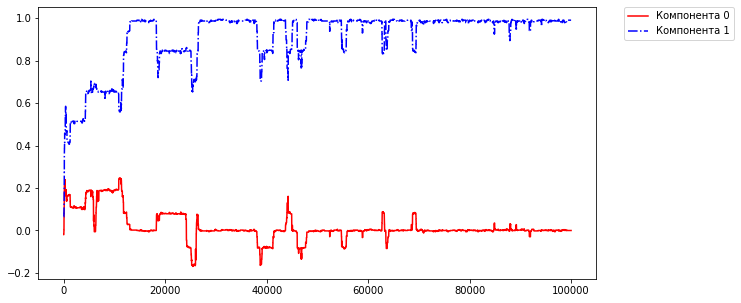

epoch = 1


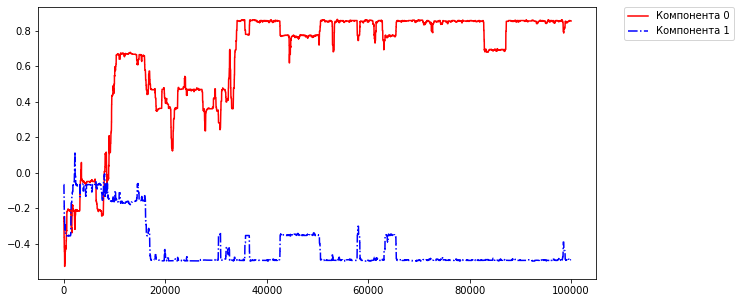

epoch = 2


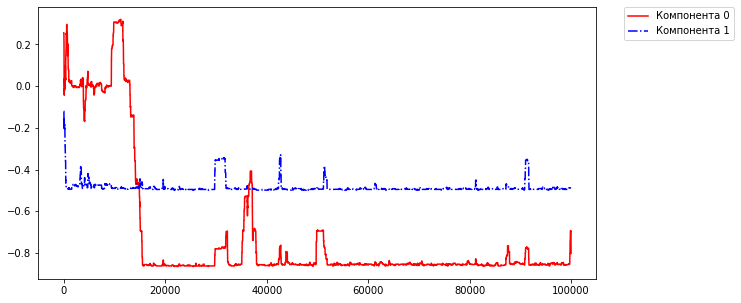

Circles
epoch = 0


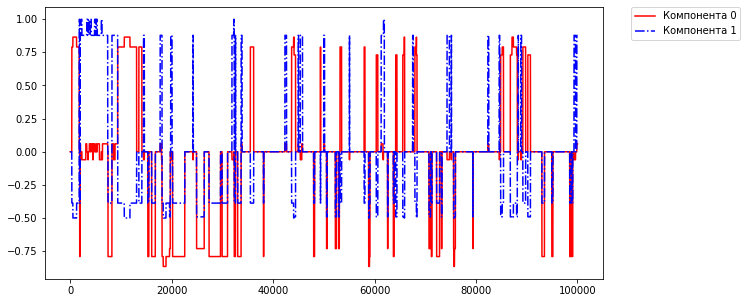

epoch = 1


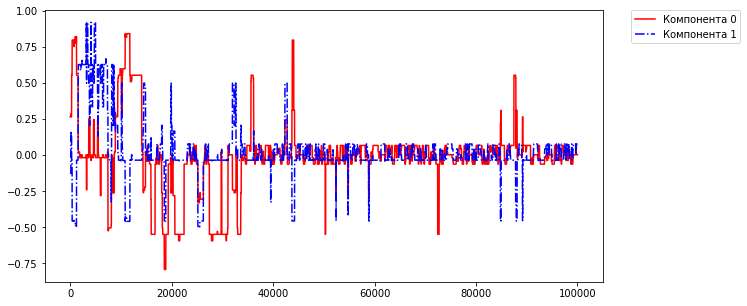

epoch = 2


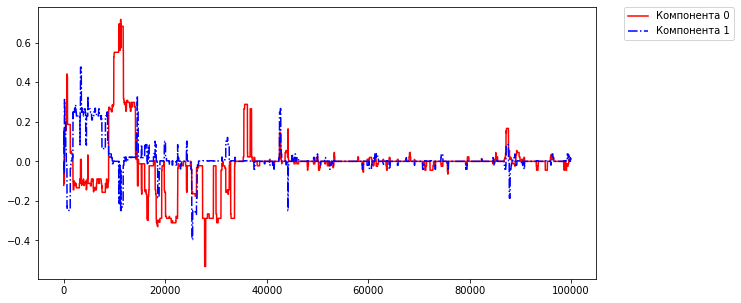

epoch = 3


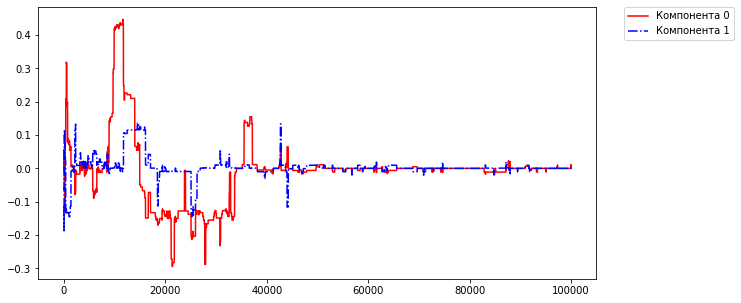

epoch = 4


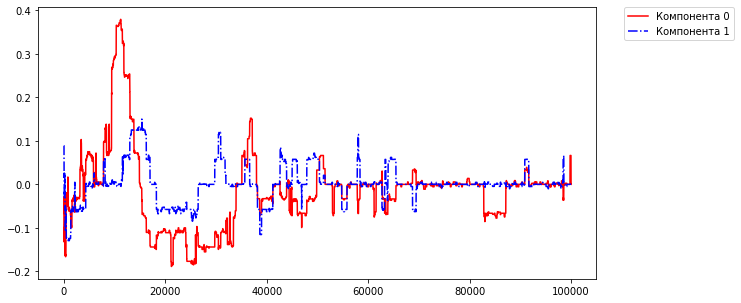

epoch = 5


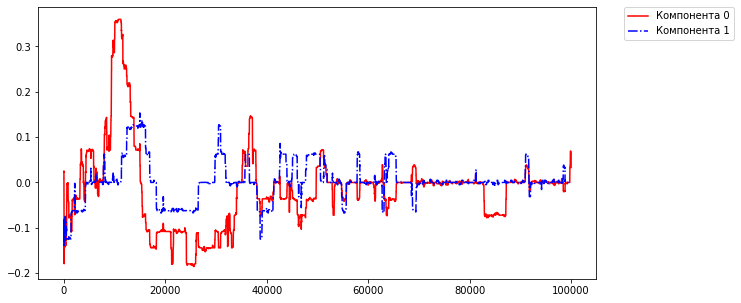

debug zero pre = 0
p = [34, 23, 37]
debug zero past = 0
without cycle, beta = 0.2


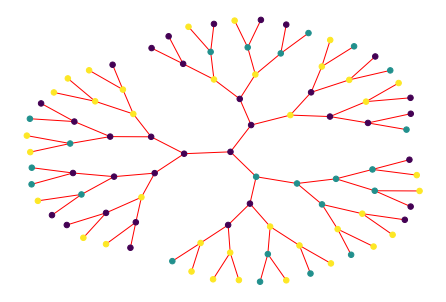

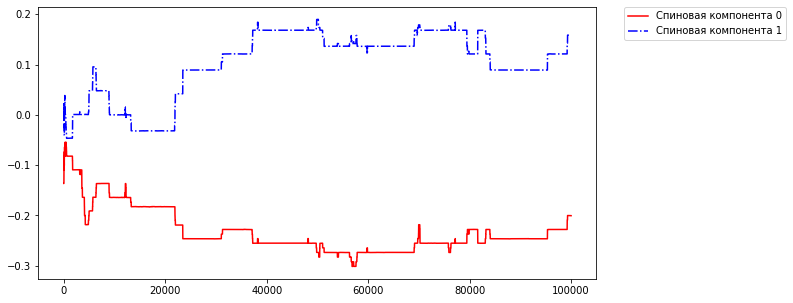

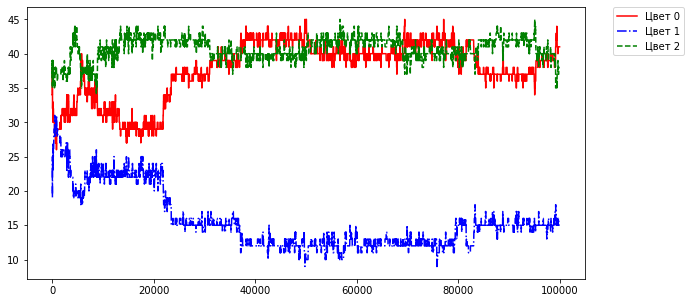

p = [41, 15, 38]
zero point
transp Y = [[ 0.00575686  0.00575686  0.00575686 ... -0.00575686 -0.00575686
  -0.00575686]
 [ 0.98989354  0.98989354  0.98989354 ...  0.98989354  0.98989354
   0.98989354]]


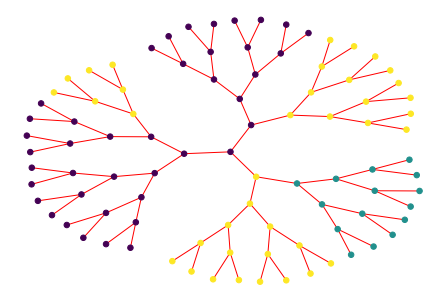

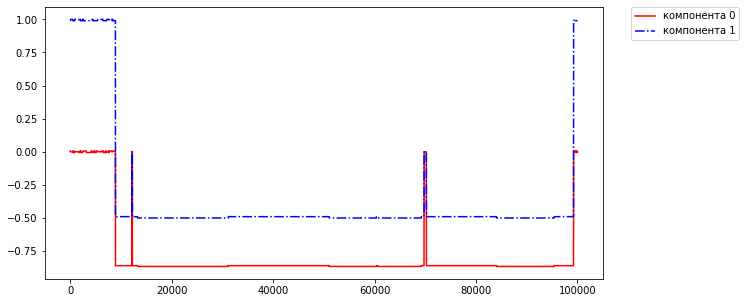

colors of branches
epoch = 0


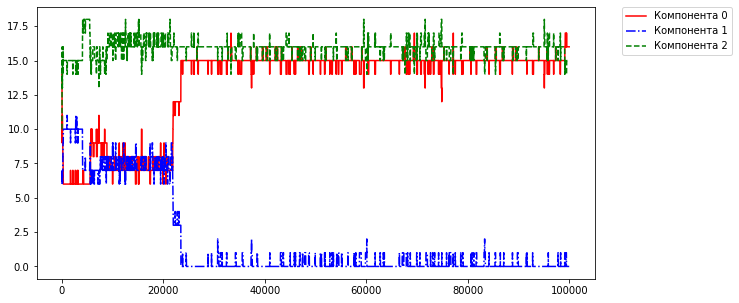

epoch = 1


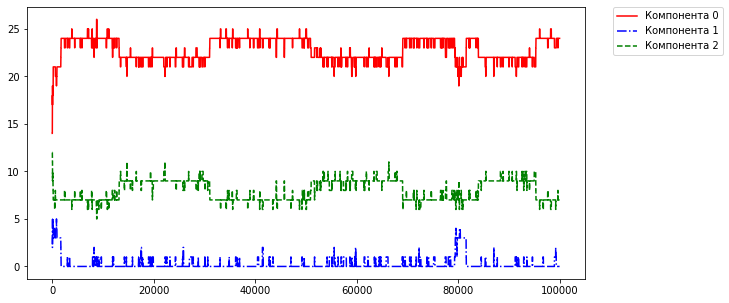

epoch = 2


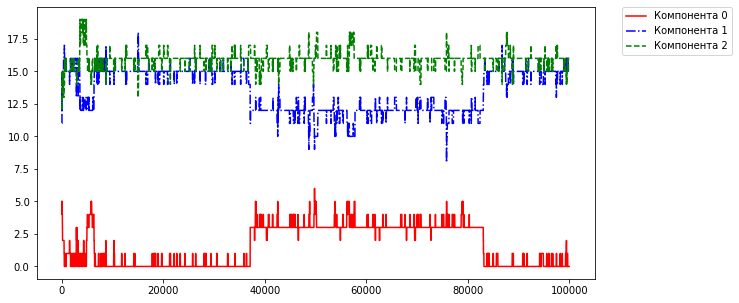

Branches
epoch = 0


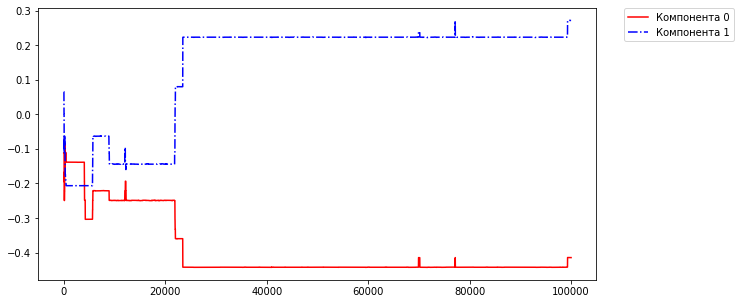

epoch = 1


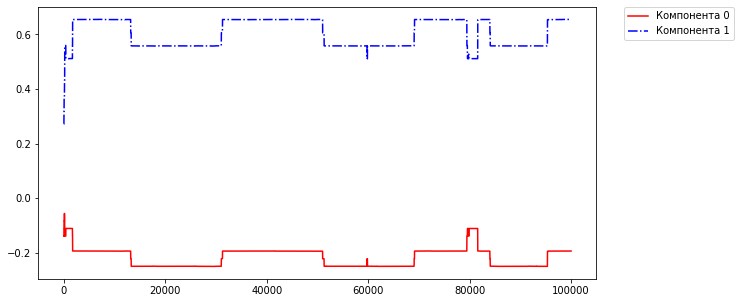

epoch = 2


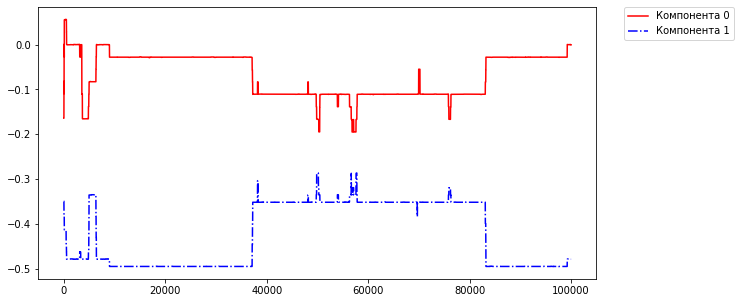

Circles
epoch = 0


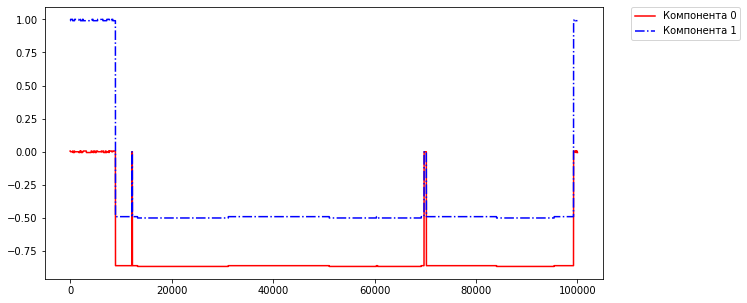

epoch = 1


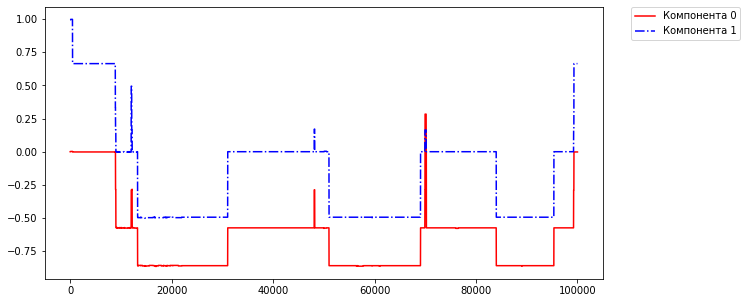

epoch = 2


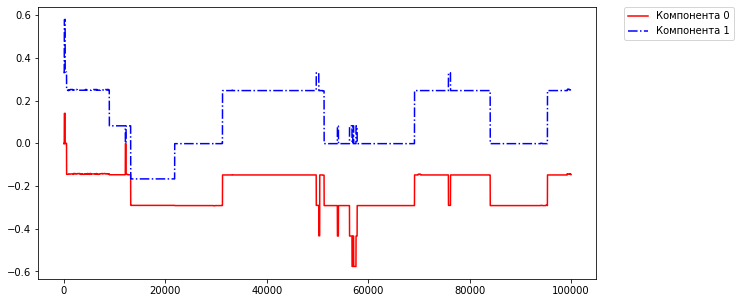

epoch = 3


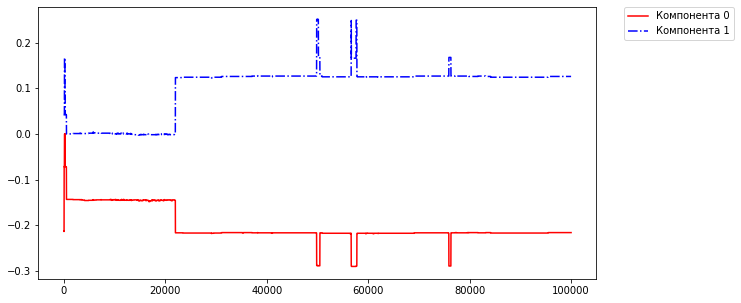

epoch = 4


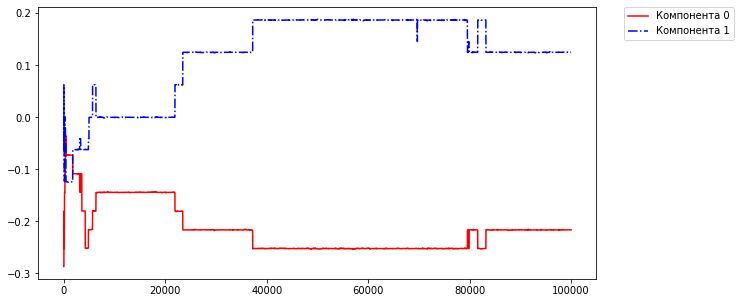

epoch = 5


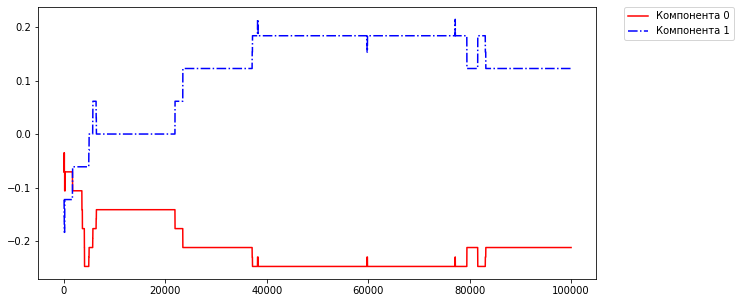

p = [30, 36, 28]
with cycle, beta = 0.2


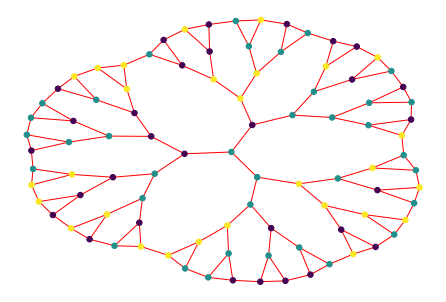

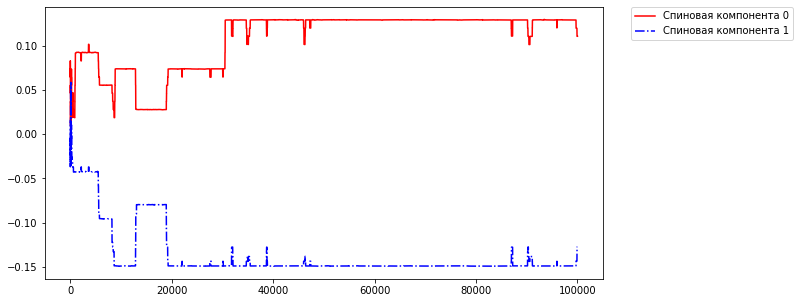

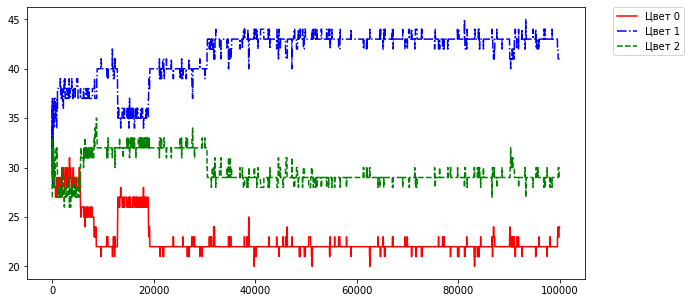

p = [24, 41, 29]
zero point
transp Y = [[ 0.00575686  0.00575686  0.00575686 ...  0.86015138  0.86015138
   0.86015138]
 [ 0.98989354  0.98989354  0.98989354 ... -0.48996118 -0.48996118
  -0.48996118]]


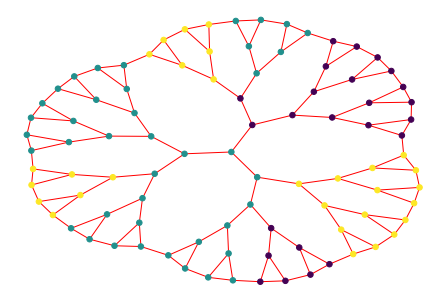

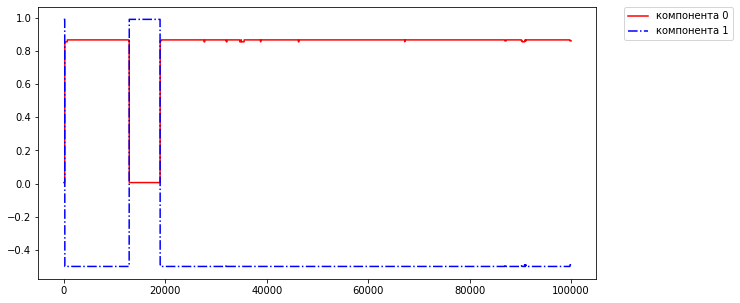

colors of branches
epoch = 0


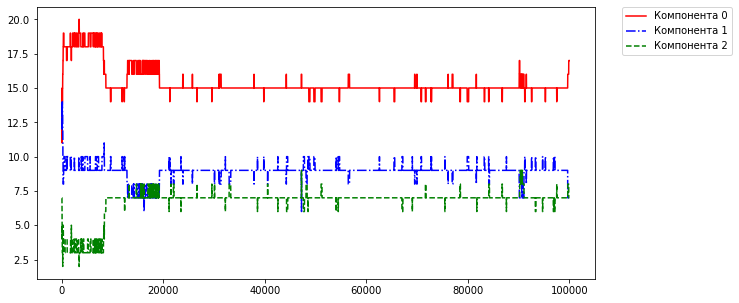

epoch = 1


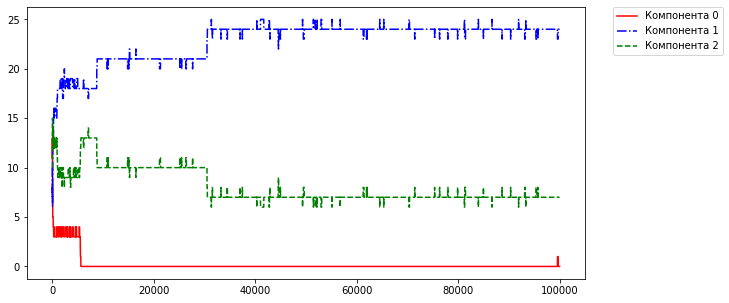

epoch = 2


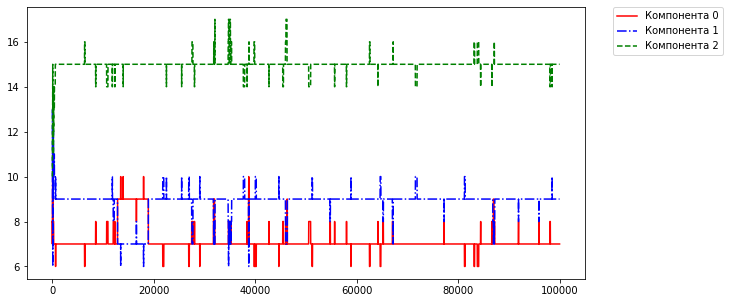

Branches
epoch = 0


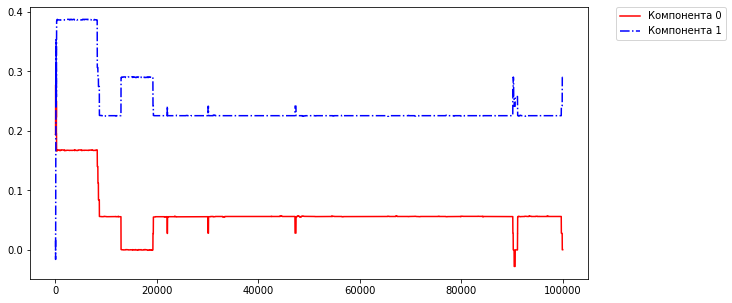

epoch = 1


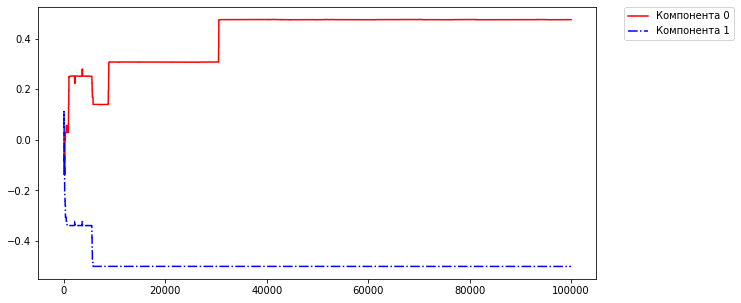

epoch = 2


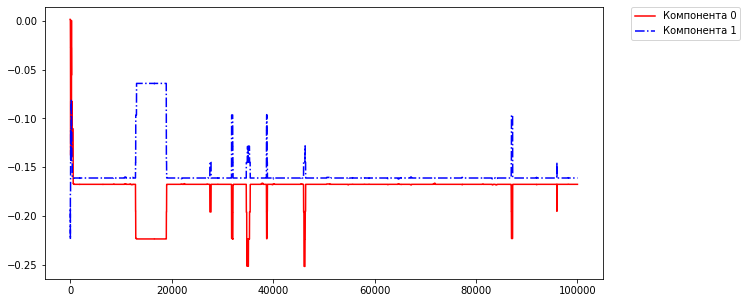

Circles
epoch = 0


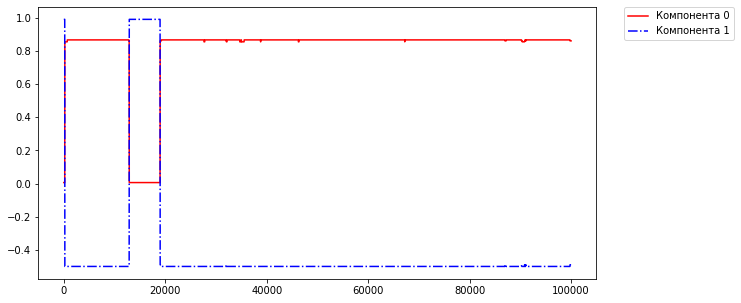

epoch = 1


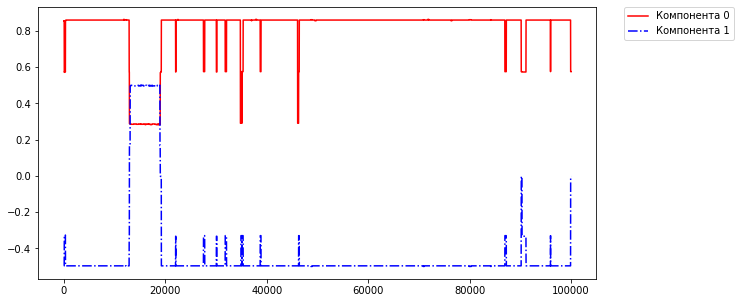

epoch = 2


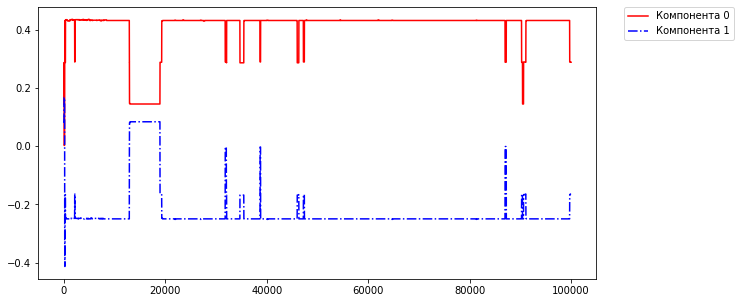

epoch = 3


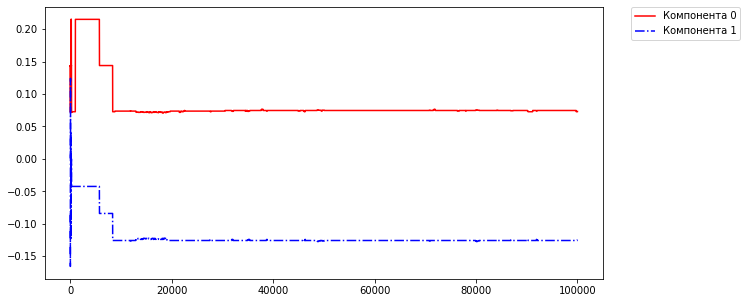

epoch = 4


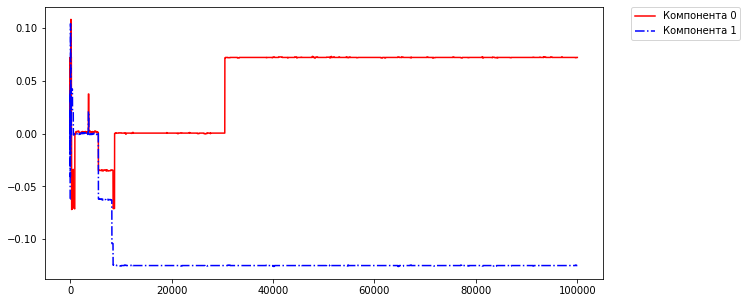

epoch = 5


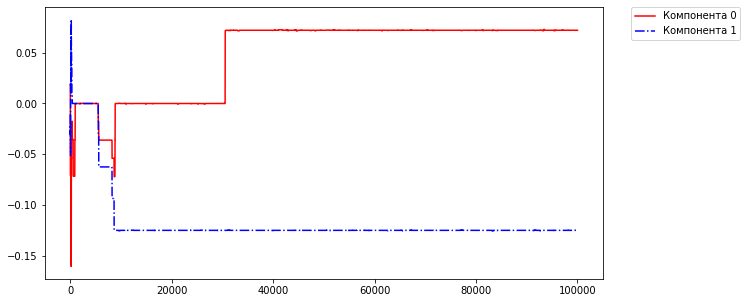

debug zero pre = 2
p = [28, 31, 35]
debug zero past = 1
without cycle, beta = 0.1


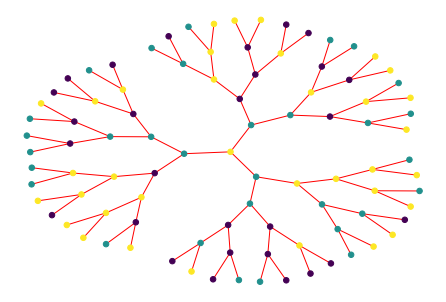

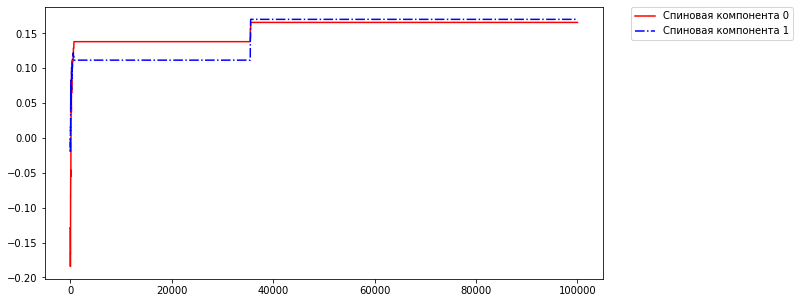

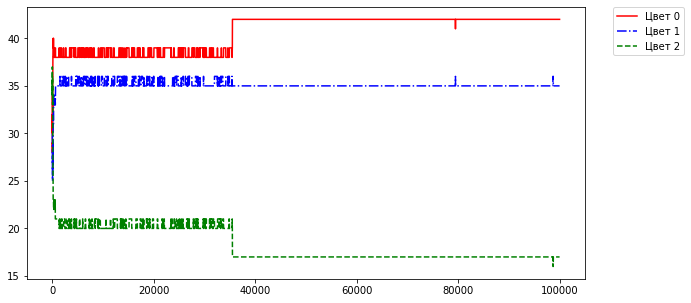

p = [42, 35, 17]
zero point
transp Y = [[ 0.8660254  0.8660254  0.8660254 ...  0.8660254  0.8660254  0.8660254]
 [-0.5       -0.5       -0.5       ... -0.5       -0.5       -0.5      ]]


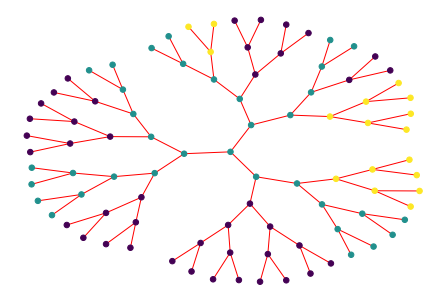

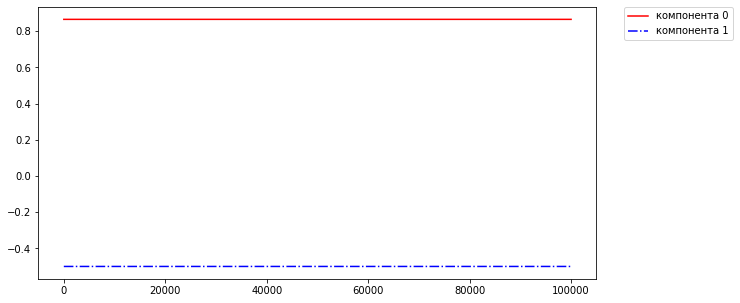

colors of branches
epoch = 0


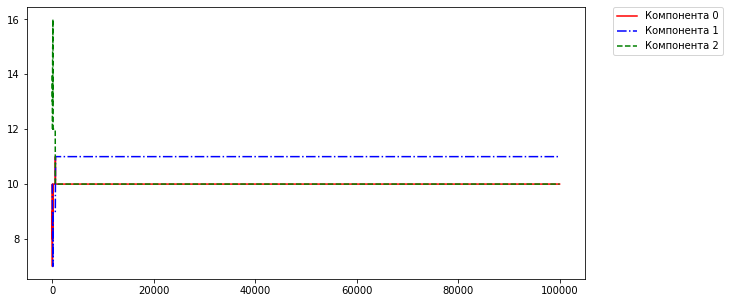

epoch = 1


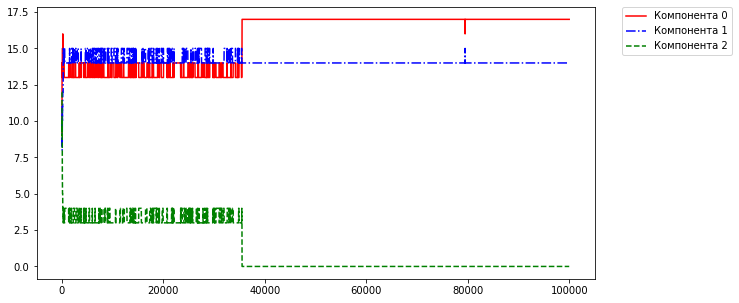

epoch = 2


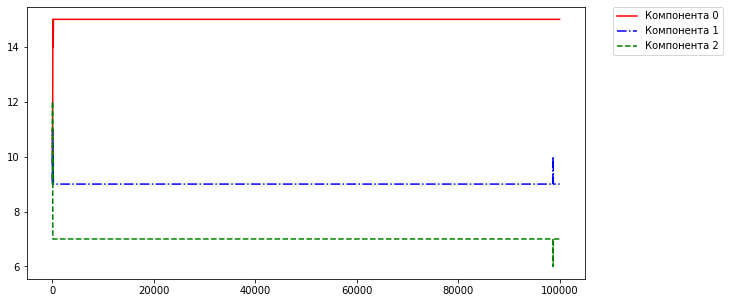

Branches
epoch = 0


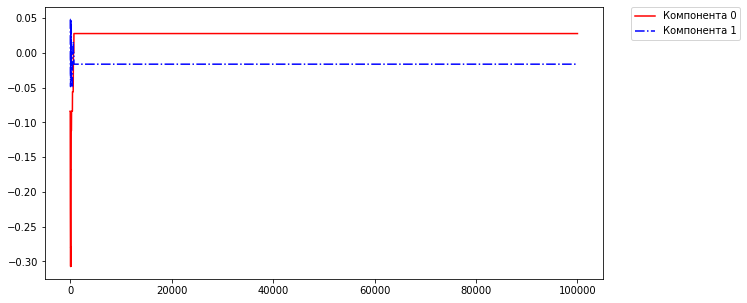

epoch = 1


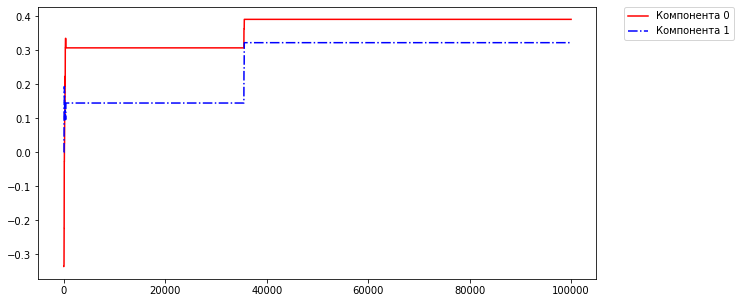

epoch = 2


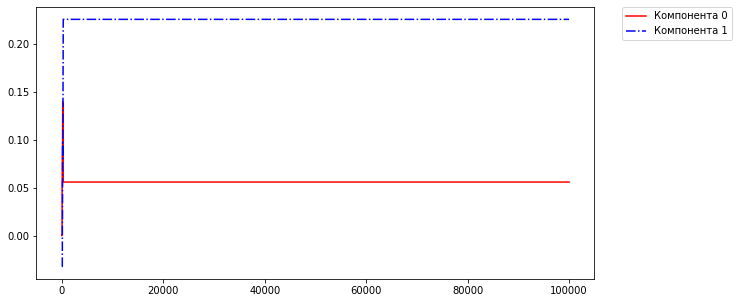

Circles
epoch = 0


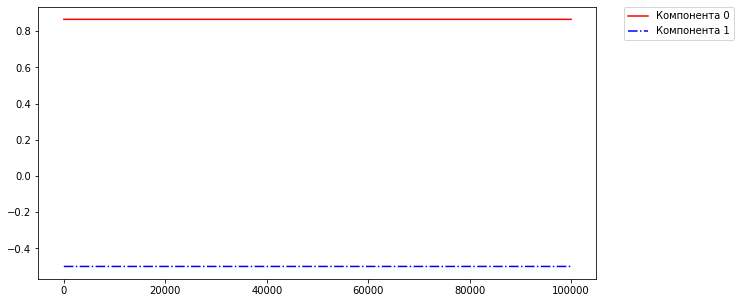

epoch = 1


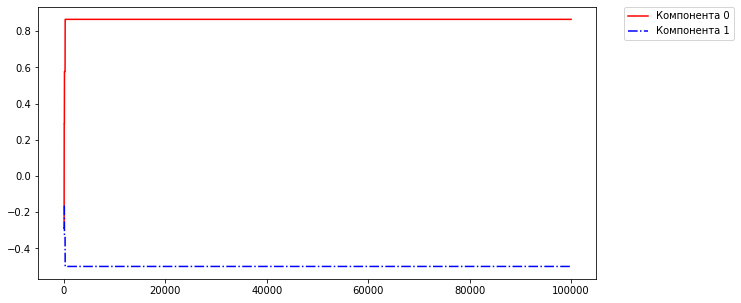

epoch = 2


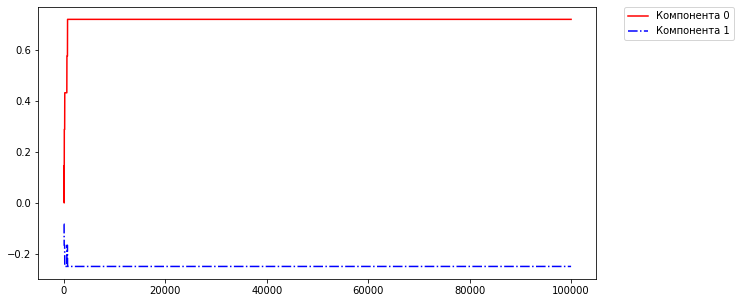

epoch = 3


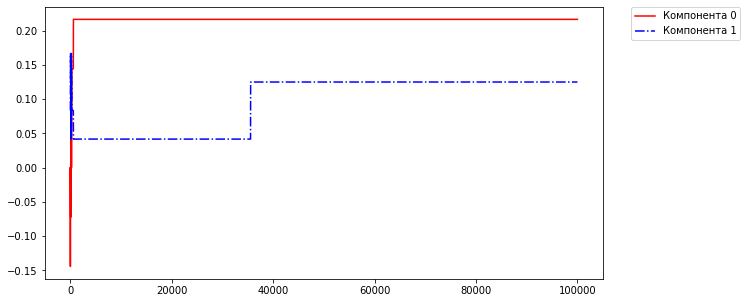

epoch = 4


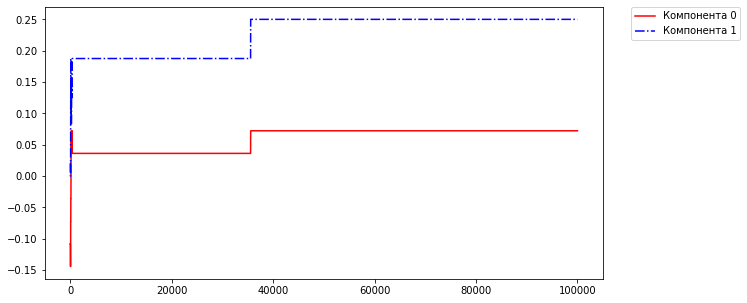

epoch = 5


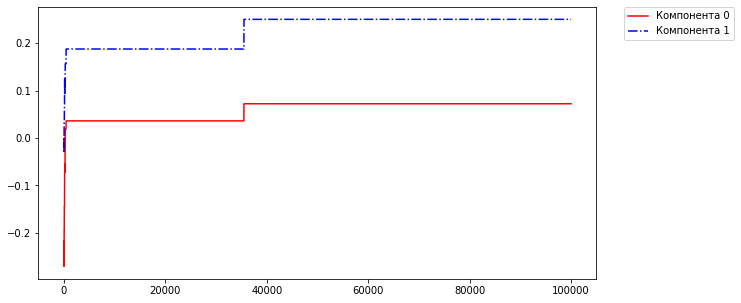

p = [32, 30, 32]
with cycle, beta = 0.1


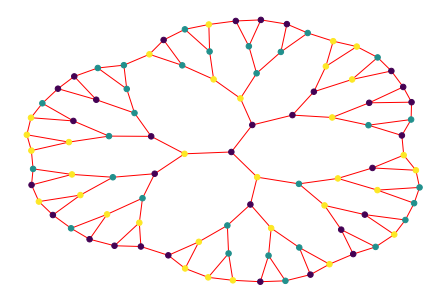

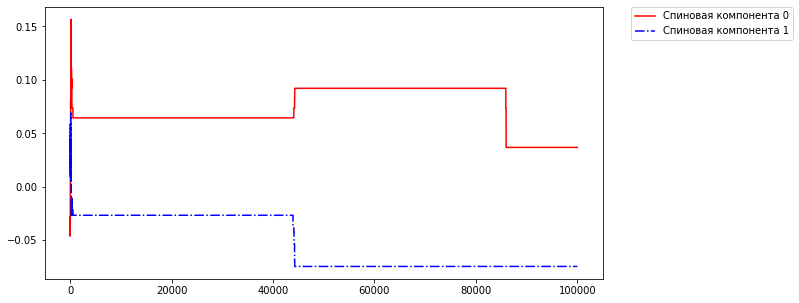

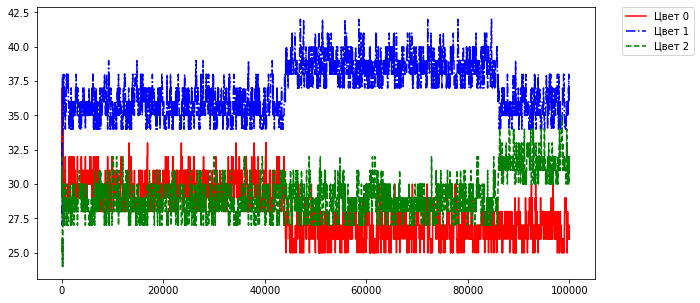

p = [26, 37, 31]
zero point
transp Y = [[-0.86598608 -0.86598608 -0.86598608 ... -0.86594677 -0.86594677
  -0.86594677]
 [-0.4999319  -0.4999319  -0.4999319  ... -0.5        -0.5
  -0.5       ]]


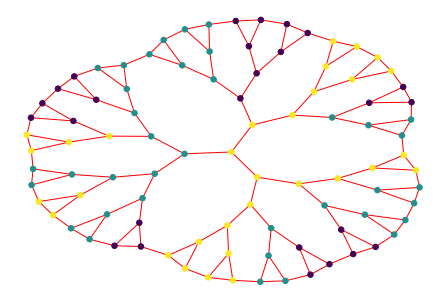

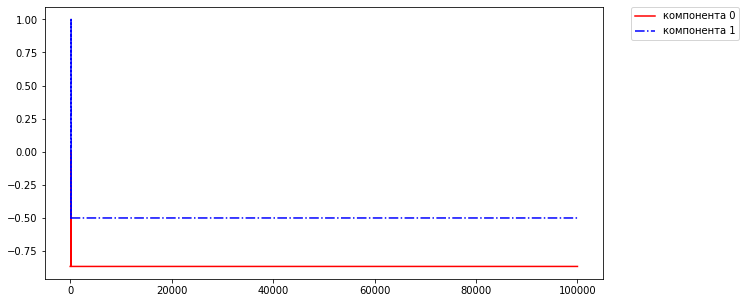

colors of branches
epoch = 0


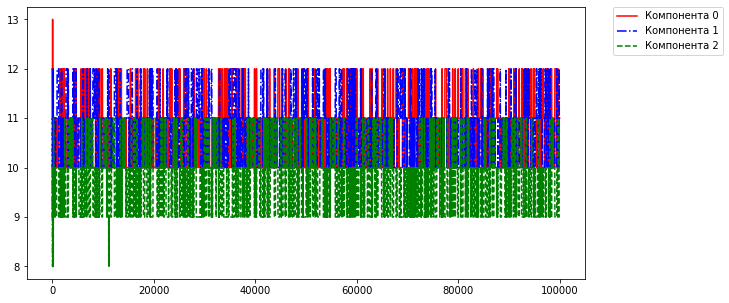

epoch = 1


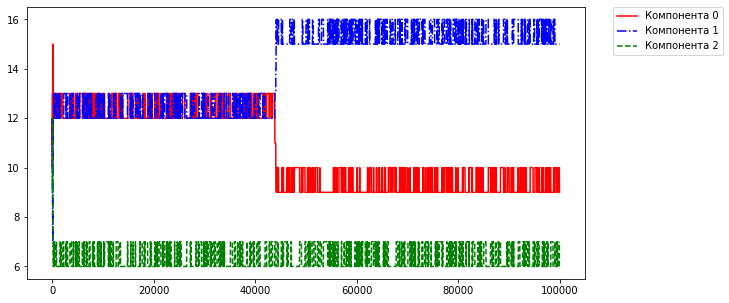

epoch = 2


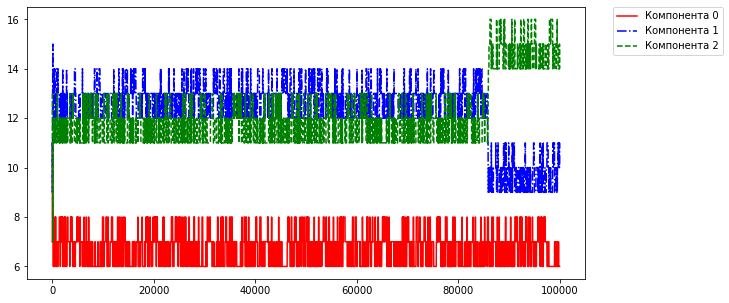

Branches
epoch = 0


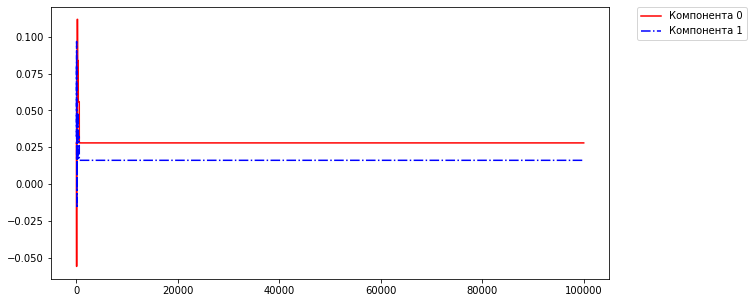

epoch = 1


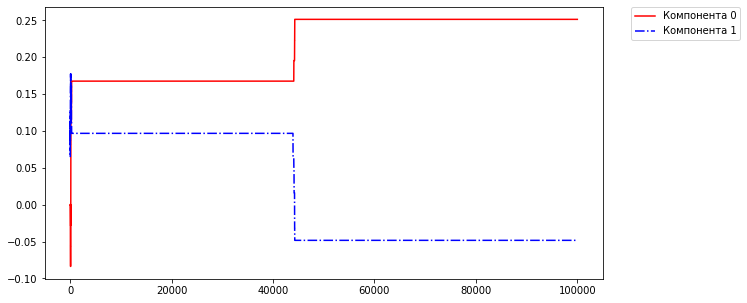

epoch = 2


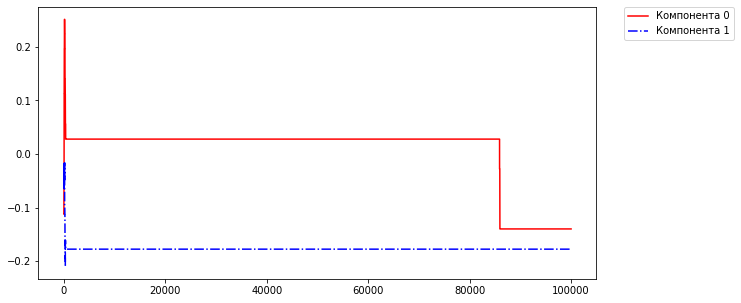

Circles
epoch = 0


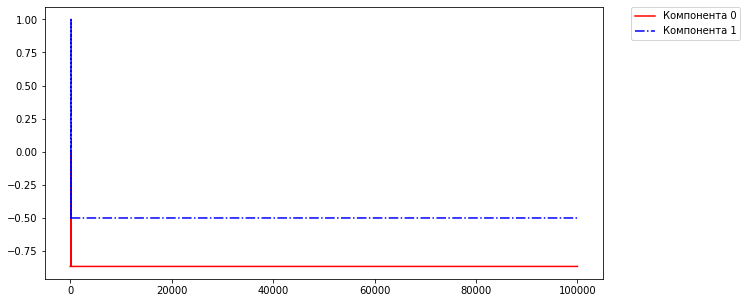

epoch = 1


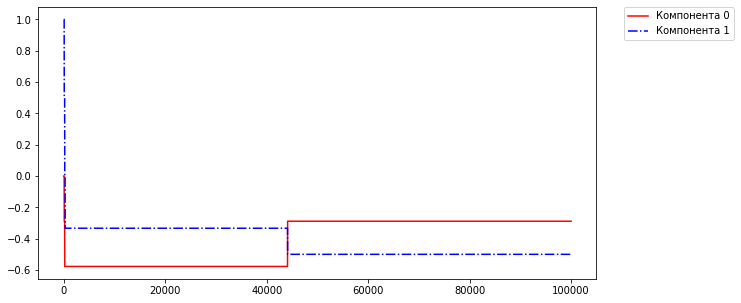

epoch = 2


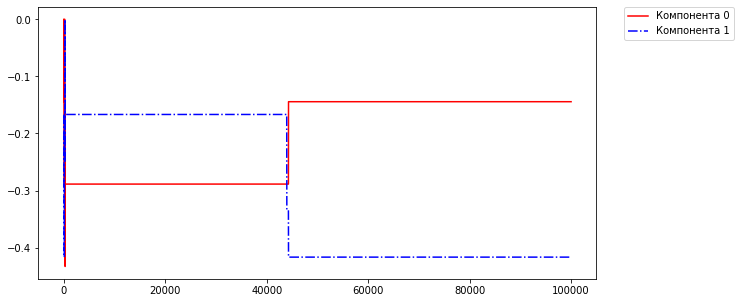

epoch = 3


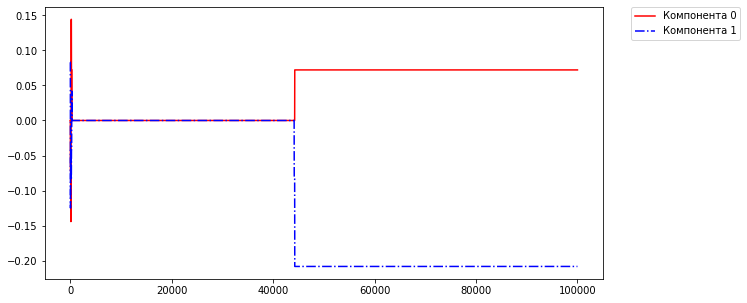

epoch = 4


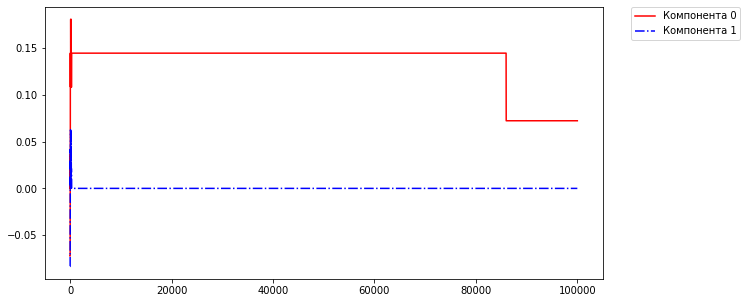

epoch = 5


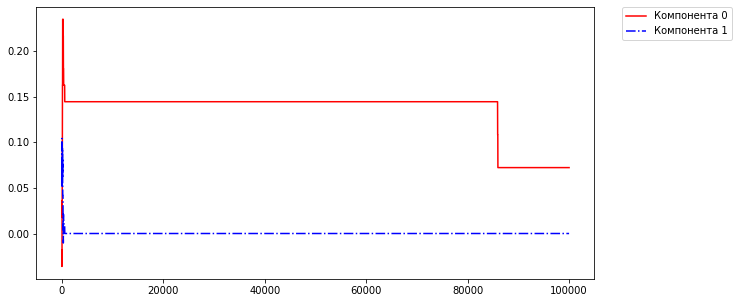

debug zero pre = 0
p = [30, 29, 35]
debug zero past = 2
without cycle, beta = 0.01


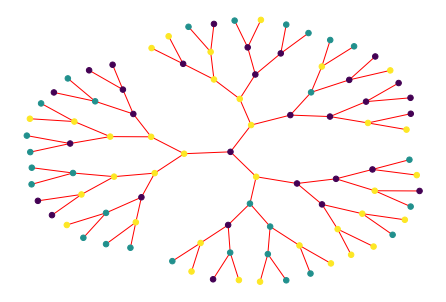

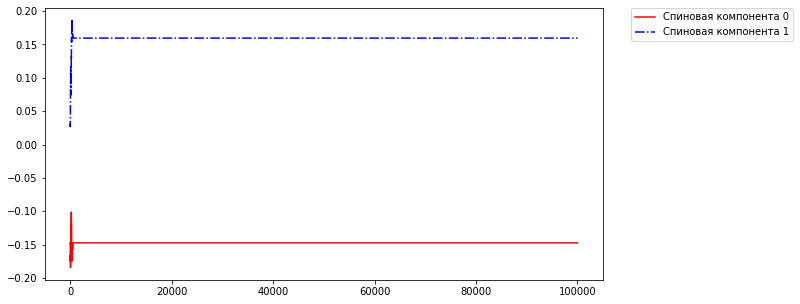

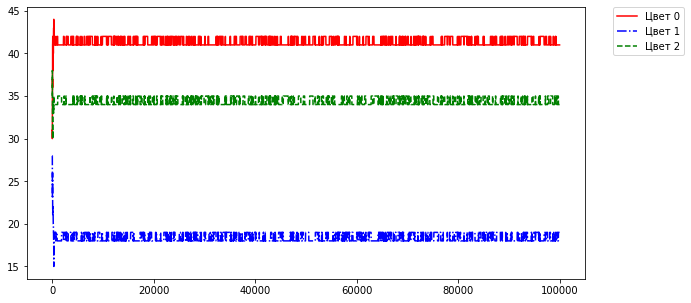

p = [41, 19, 34]
zero point
transp Y = [[-0.8660254 -0.8660254 -0.8660254 ... -0.8660254 -0.8660254 -0.8660254]
 [-0.5       -0.5       -0.5       ... -0.5       -0.5       -0.5      ]]


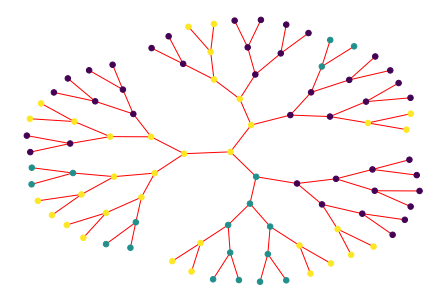

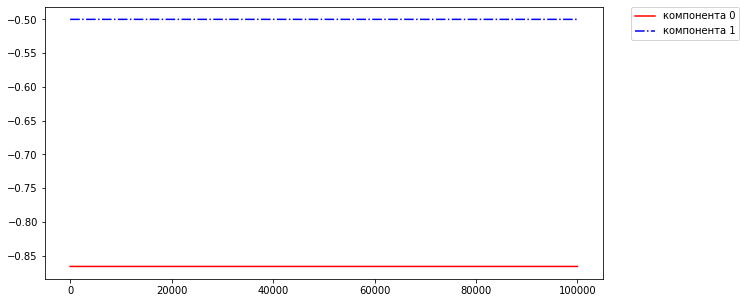

colors of branches
epoch = 0


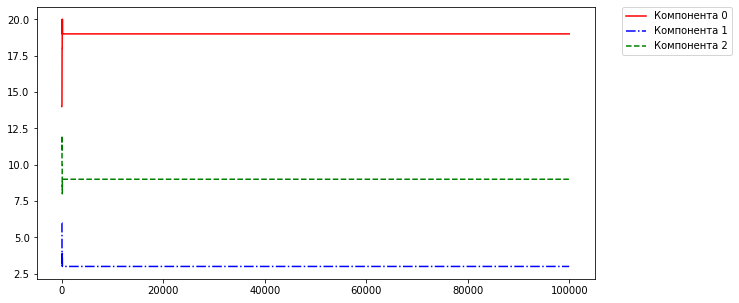

epoch = 1


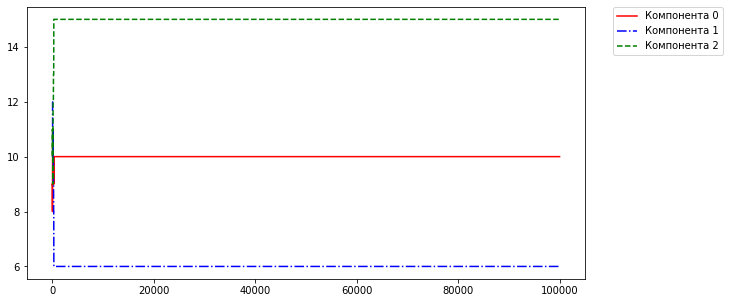

epoch = 2


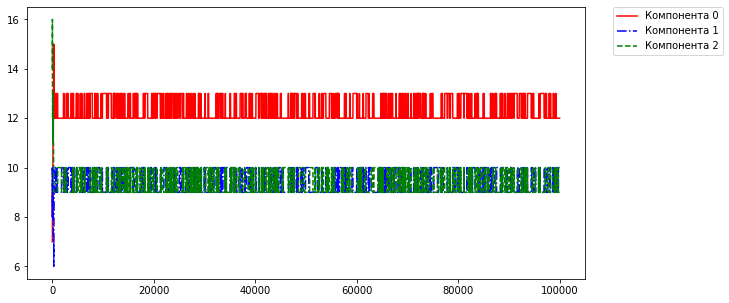

Branches
epoch = 0


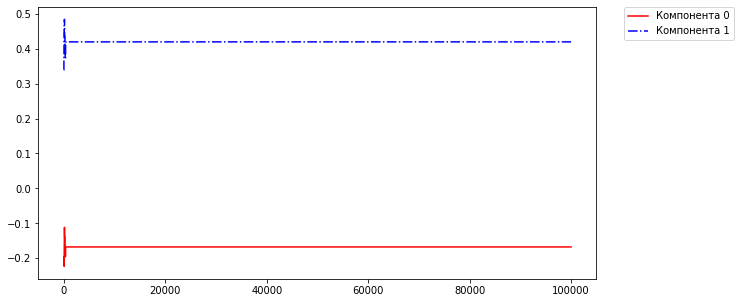

epoch = 1


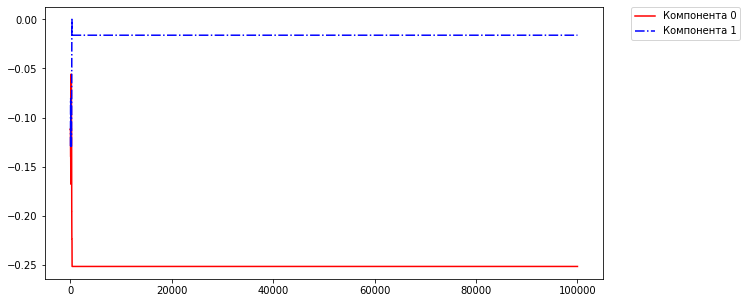

epoch = 2


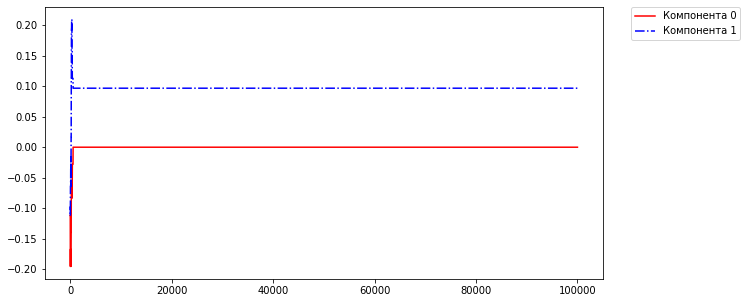

Circles
epoch = 0


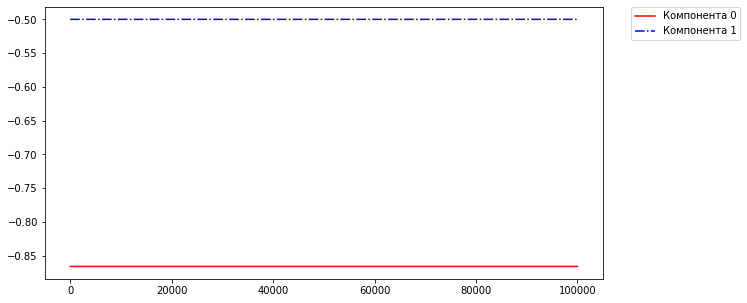

epoch = 1


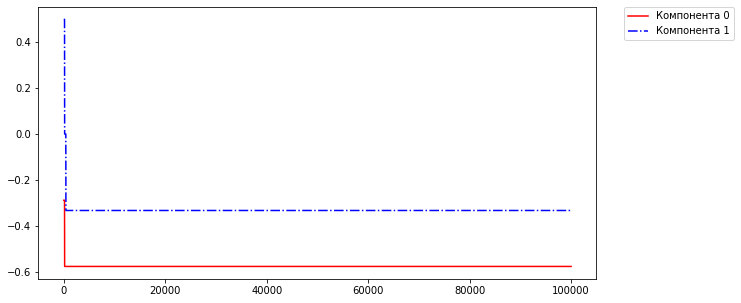

epoch = 2


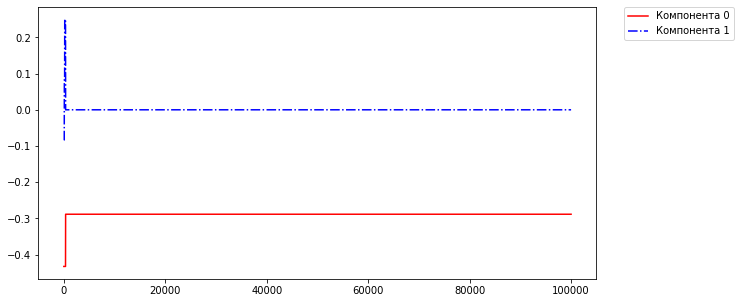

epoch = 3


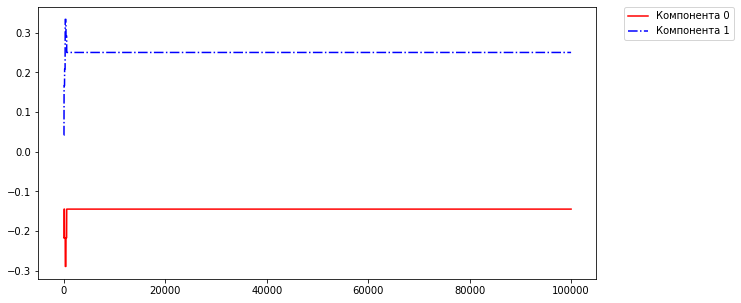

epoch = 4


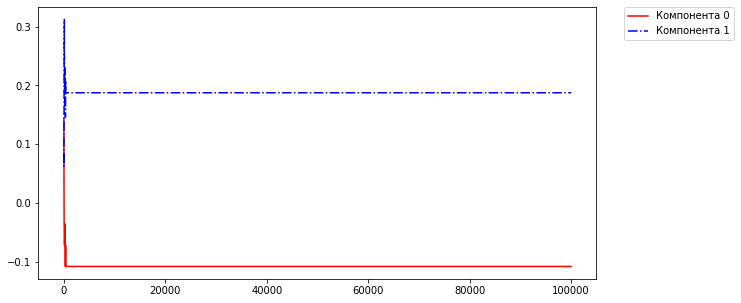

epoch = 5


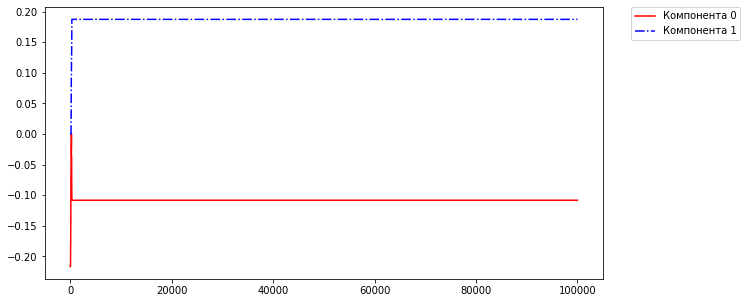

p = [29, 31, 34]
with cycle, beta = 0.01


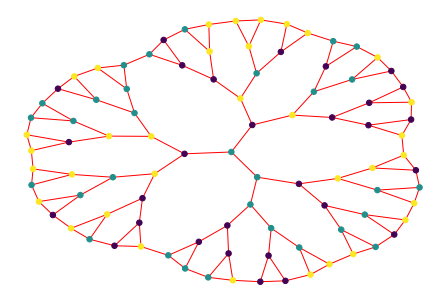

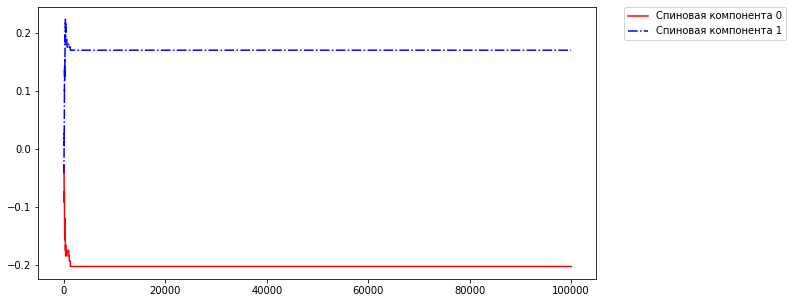

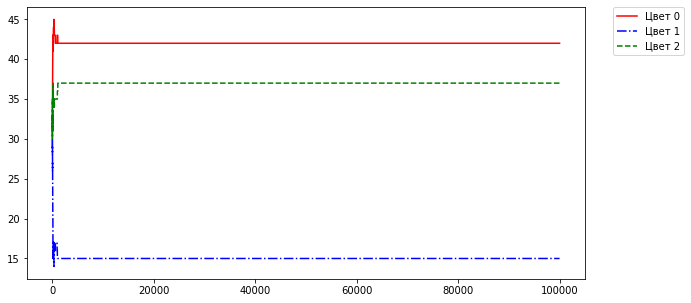

p = [42, 15, 37]
zero point
transp Y = [[3.2216803e-44 3.2216803e-44 3.2216803e-44 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [1.0000000e+00 1.0000000e+00 1.0000000e+00 ... 1.0000000e+00
  1.0000000e+00 1.0000000e+00]]


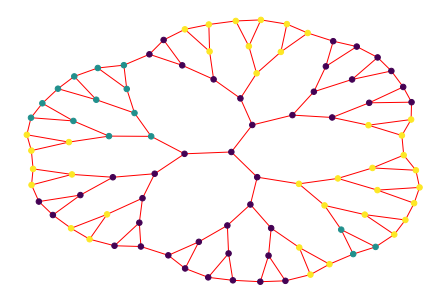

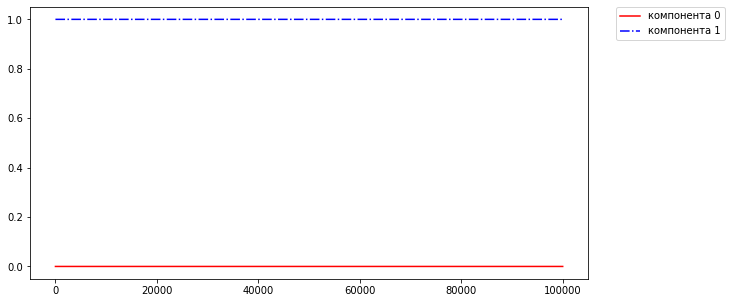

colors of branches
epoch = 0


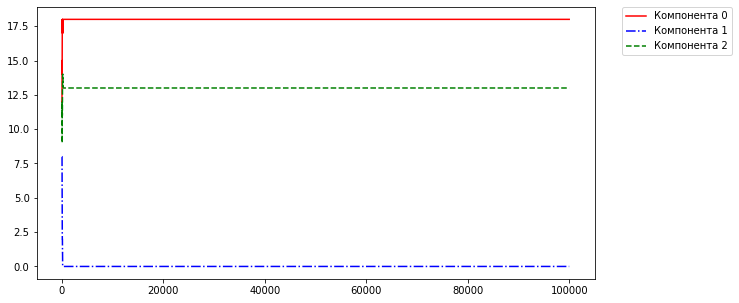

epoch = 1


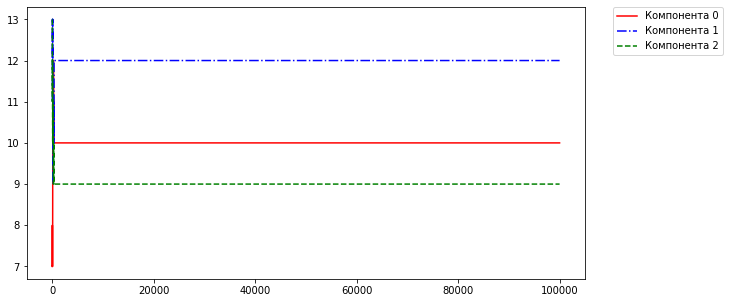

epoch = 2


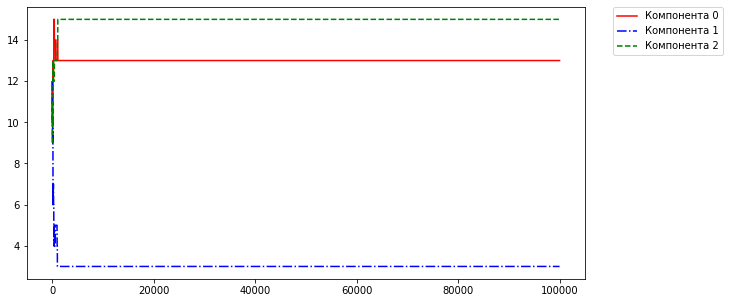

Branches
epoch = 0


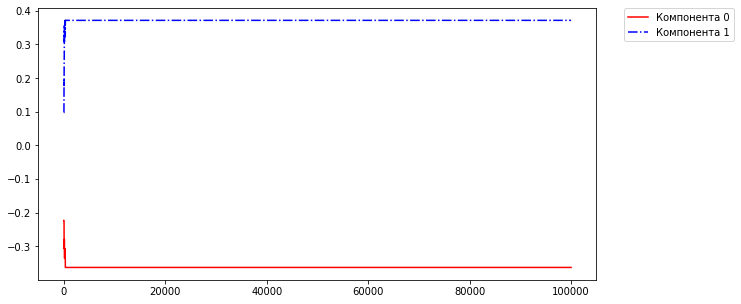

epoch = 1


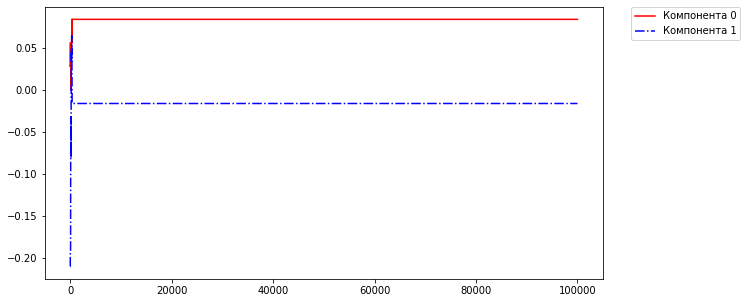

epoch = 2


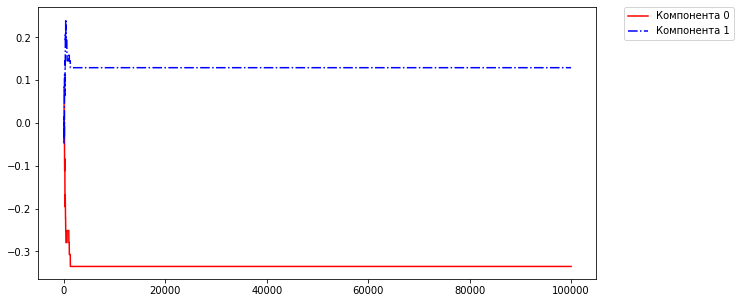

Circles
epoch = 0


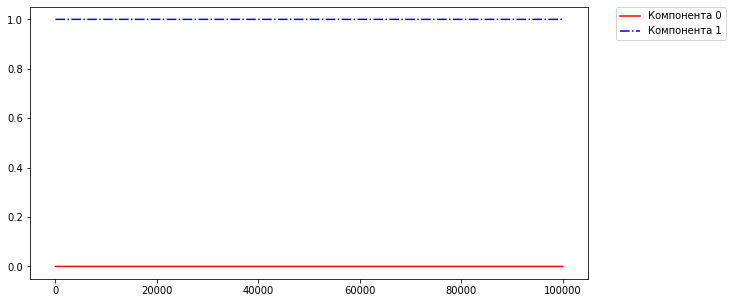

epoch = 1


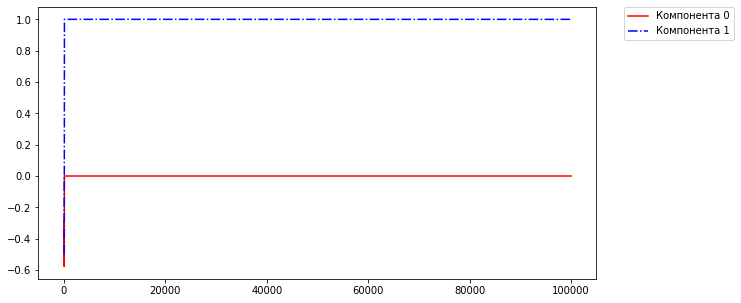

epoch = 2


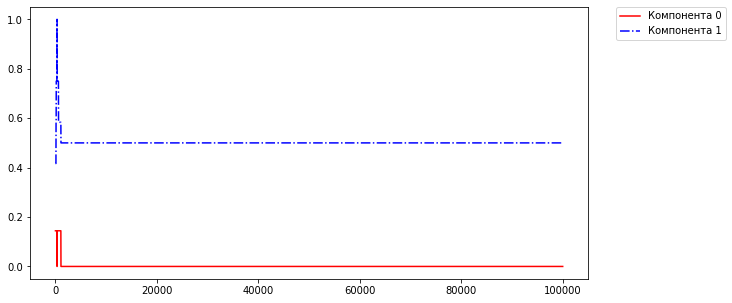

epoch = 3


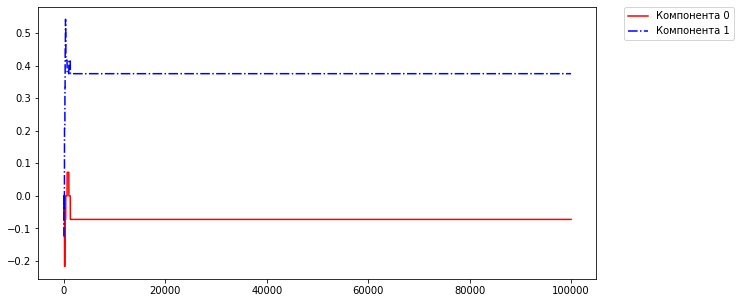

epoch = 4


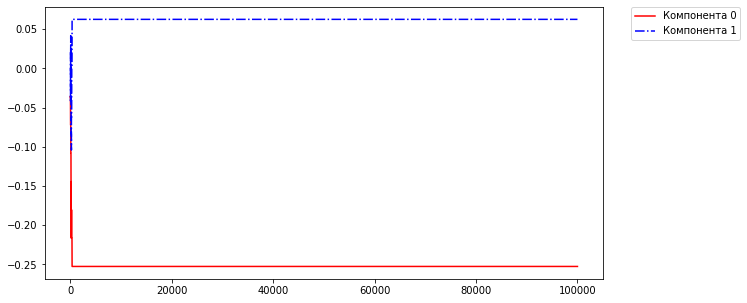

epoch = 5


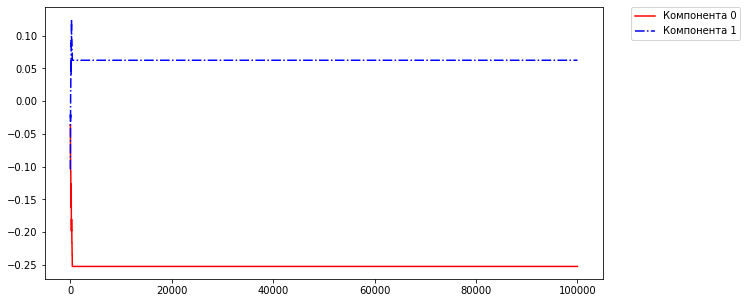

In [ ]:
stat2(100000)

p = [34, 27, 33]


No handles with labels found to put in legend.


debug zero past = 0


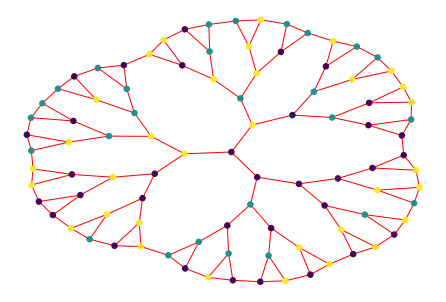

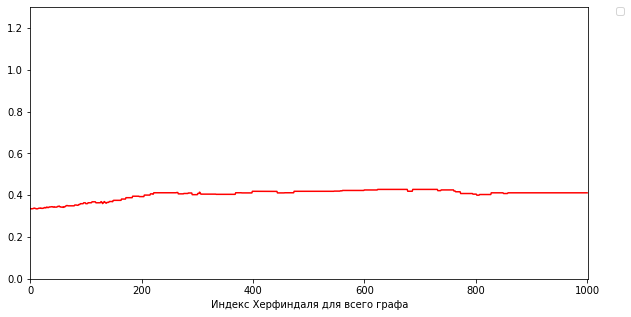

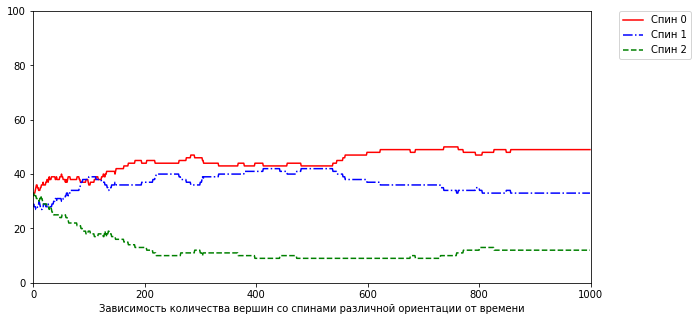

No handles with labels found to put in legend.


p = [49, 33, 12]
zero point


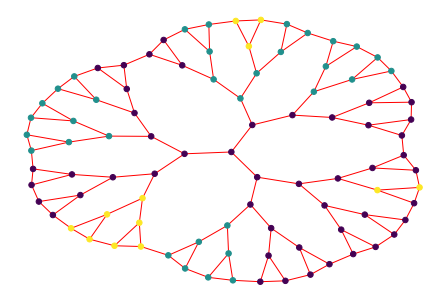

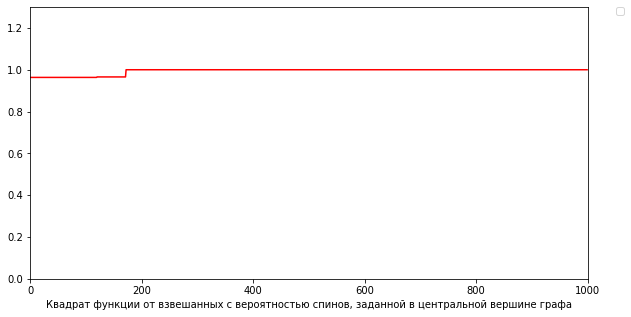

colors of branches
epoch = 0


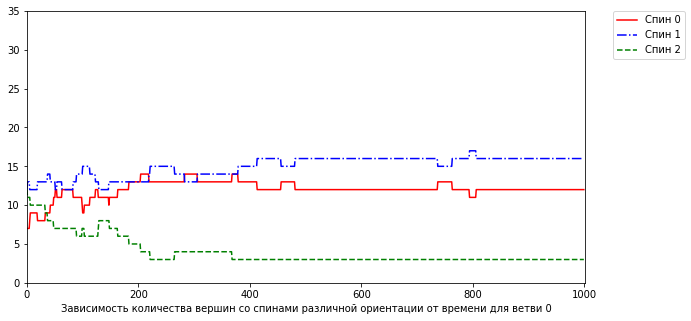

epoch = 1


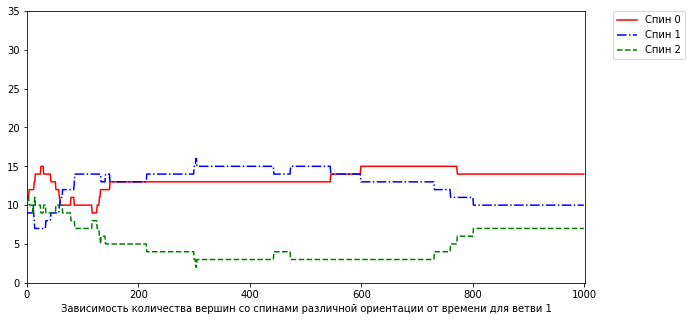

epoch = 2


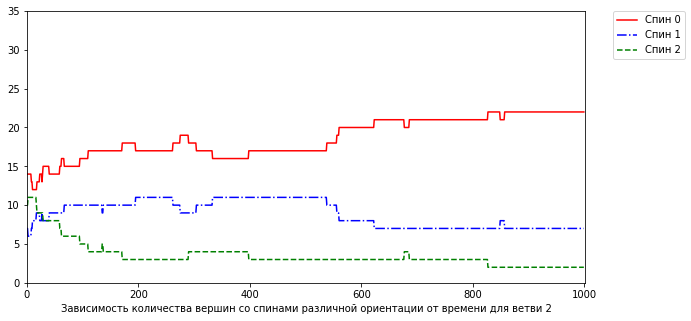

No handles with labels found to put in legend.


Branches
Ветвь 0


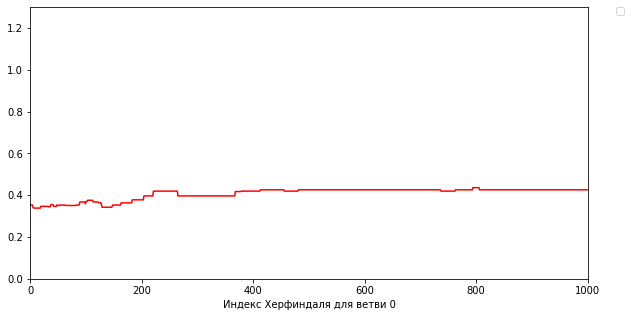

Ветвь 1


No handles with labels found to put in legend.


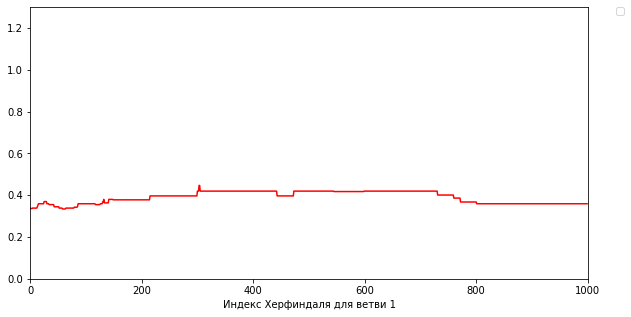

Ветвь 2


No handles with labels found to put in legend.


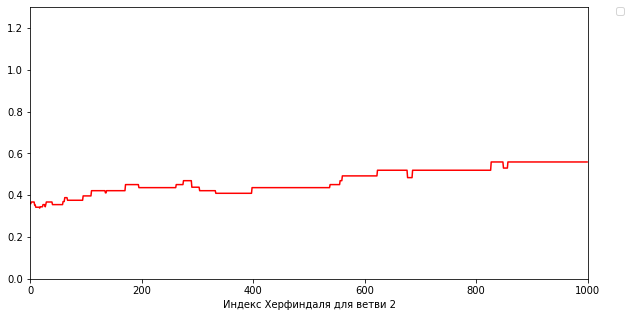

No handles with labels found to put in legend.


Circles
Окружность 0


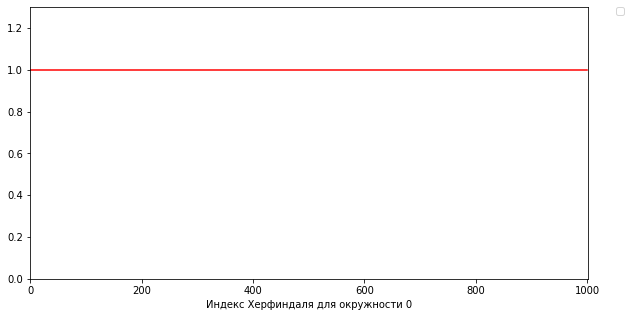

No handles with labels found to put in legend.


Окружность 1


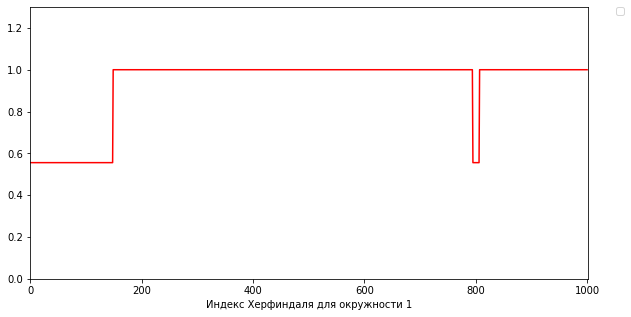

Окружность 2


No handles with labels found to put in legend.


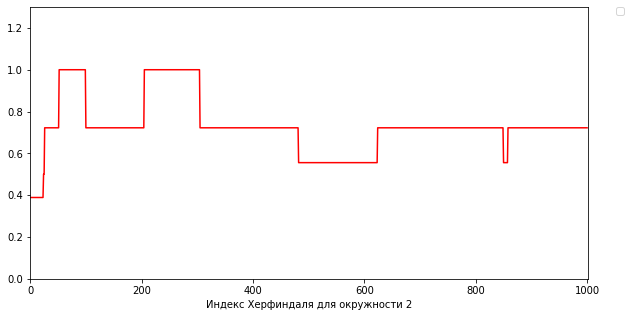

Окружность 3


No handles with labels found to put in legend.


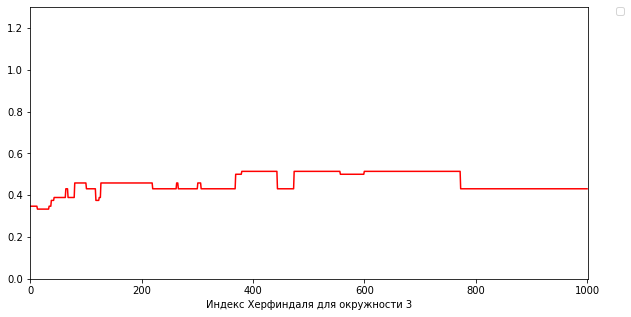

No handles with labels found to put in legend.


Окружность 4


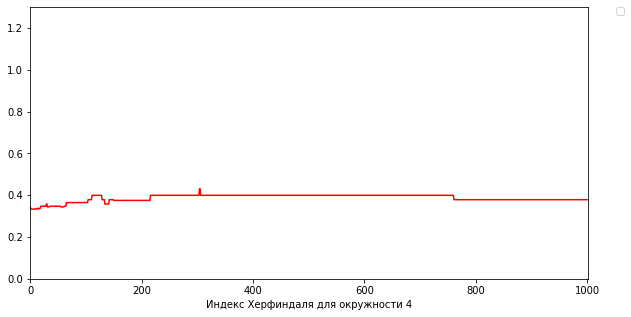

No handles with labels found to put in legend.


Окружность 5


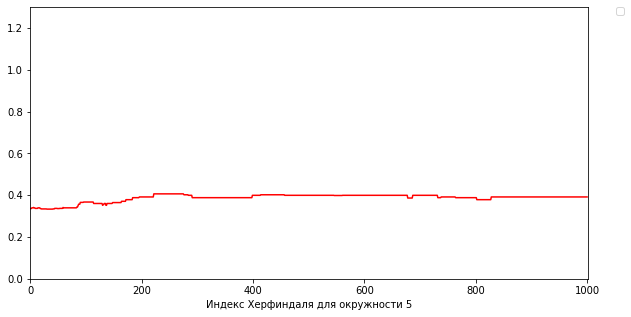

In [ ]:
M1 = potts(1, 5, 3, 0.3, 3, 1000, 1, 1)
color(M1)
Mss11 = M1.evolve()
Mss1 = Mss11.copy()
#    Mass1 = Mss1[0]
print('debug zero past = %s' %M1.N[0])
herfendale_for_all_graph(Mss1[1], 1) #1 = весь граф, 0 = нулевой узел
find_dynamics_of_colors(Mss1[5])
color(M1)
print('zero point')
herfendale_for_all_graph(Mss1[6], 0)
print('colors of branches')
result_graph3(Mss1[4])
print('Branches')
result_graph_for_branches(Mss1[3])
print('Circles')
result_graph_for_branches(Mss1[0])

In [ ]:
def stat3(t):
#  k = [0.001, 0.01, 0.1, 1, 10, 100, 1000]
  k = [10, 1, 0.8, 0.6, 0.4, 0.2, 0.01]
  for i in k:
    for z in [0, 1]:
      M1 = potts(1, 5, 3, i, 3, t, 1, z)
      color(M1)
      Mss11 = M1.evolve()
      Mss1 = Mss11.copy()
      #    Mass1 = Mss1[0]
      print('debug zero past = %s' %M1.N[0])
      herfendale_for_all_graph(Mss1[1], 1) #1 = весь граф, 0 = нулевой узел
      find_dynamics_of_colors(Mss1[5])
      color(M1)
      print('zero point')
      herfendale_for_all_graph(Mss1[6], 0)
      print('colors of branches')
      result_graph3(Mss1[4])
      print('Branches')
      result_graph_for_branches(Mss1[3])
      print('Circles')
      result_graph_for_branches(Mss1[0])

p = [32, 35, 27]


No handles with labels found to put in legend.


debug zero past = 0


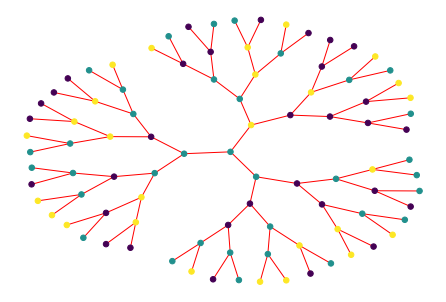

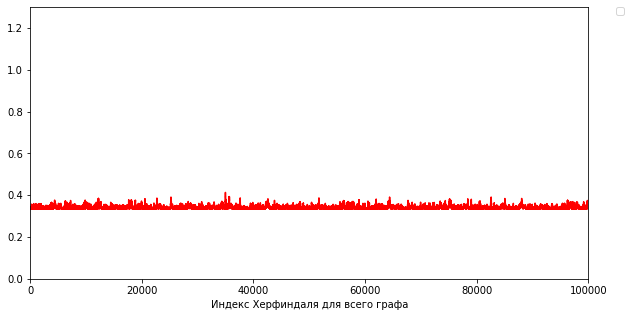

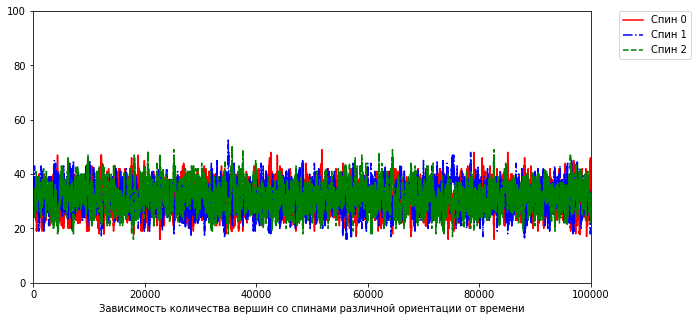

No handles with labels found to put in legend.


p = [36, 30, 28]
zero point


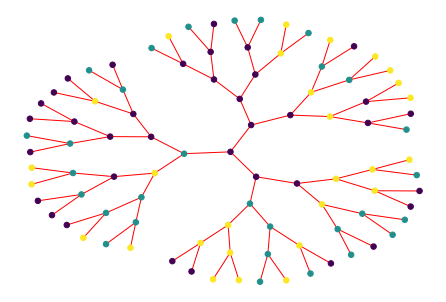

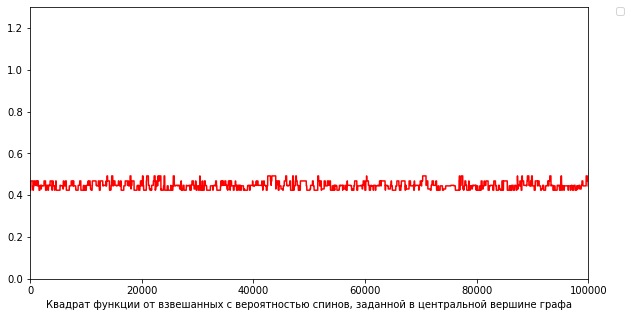

colors of branches
epoch = 0


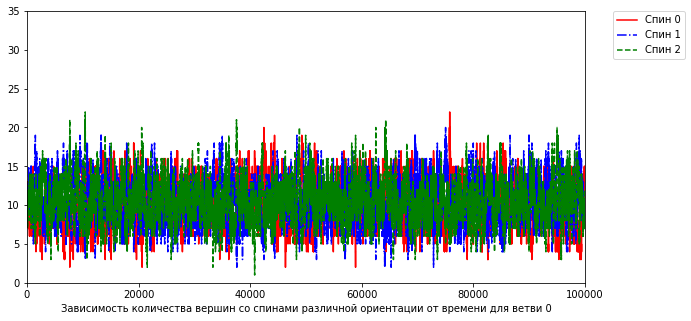

epoch = 1


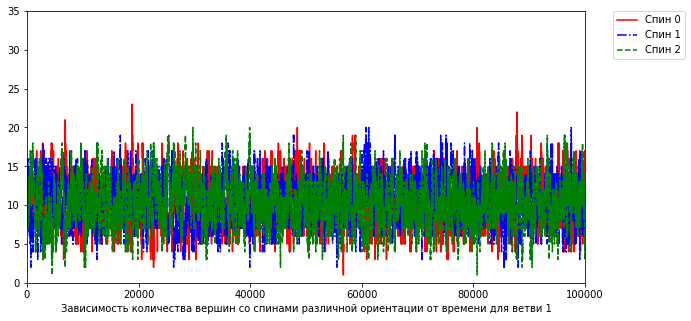

epoch = 2


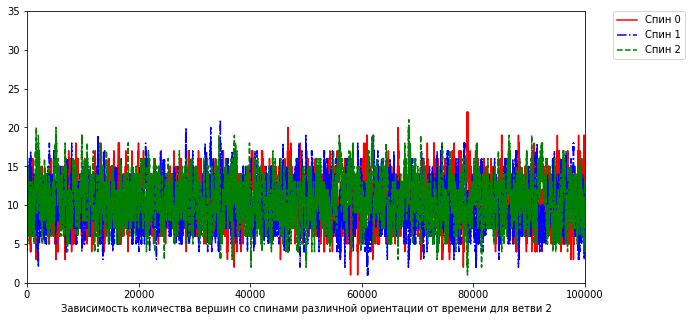

No handles with labels found to put in legend.


Branches
Ветвь 0


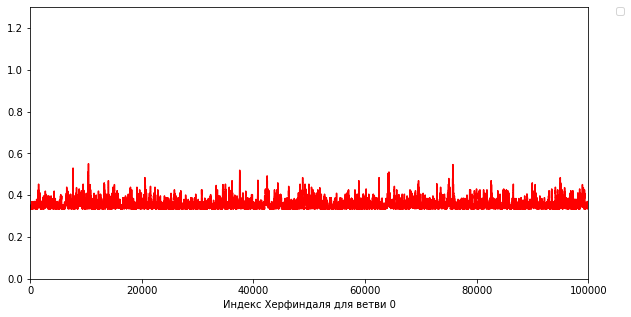

No handles with labels found to put in legend.


Ветвь 1


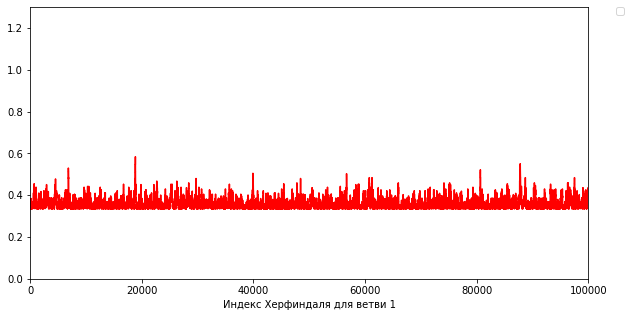

No handles with labels found to put in legend.


Ветвь 2


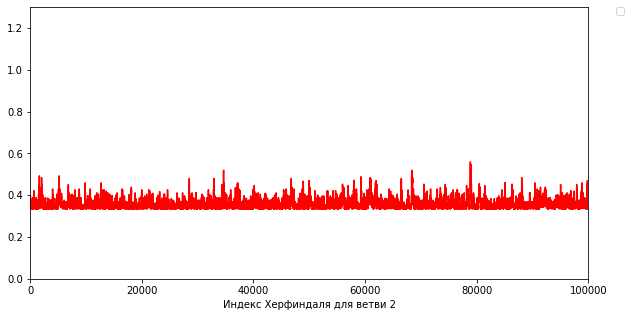

No handles with labels found to put in legend.


Circles
Окружность 0


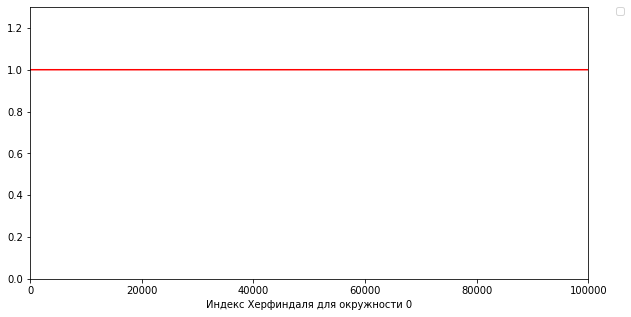

No handles with labels found to put in legend.


Окружность 1


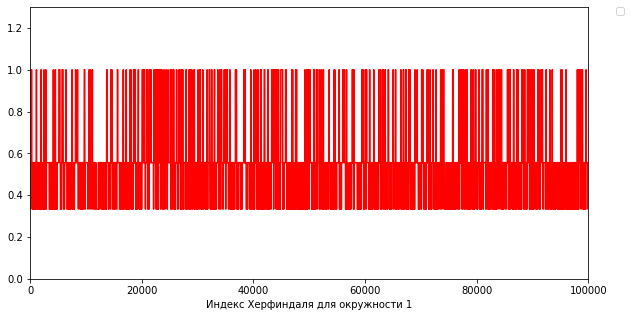

No handles with labels found to put in legend.


Окружность 2


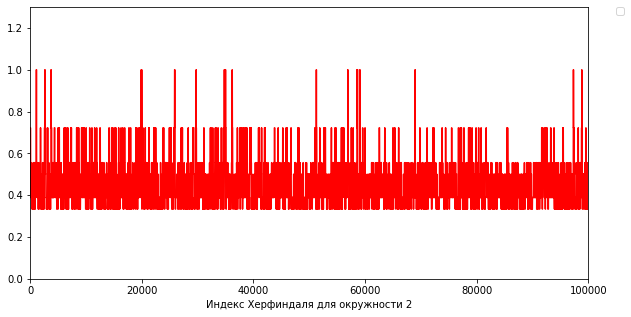

No handles with labels found to put in legend.


Окружность 3


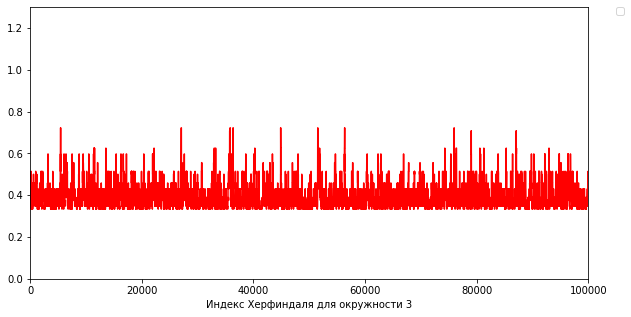

No handles with labels found to put in legend.


Окружность 4


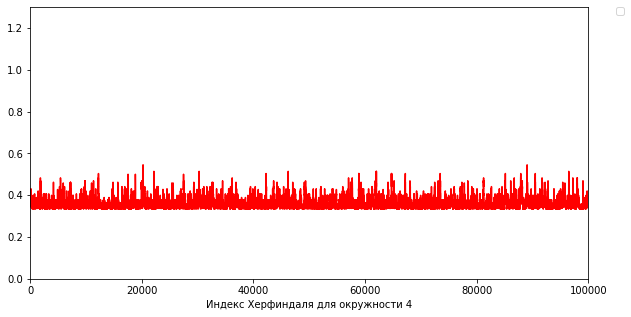

No handles with labels found to put in legend.


Окружность 5


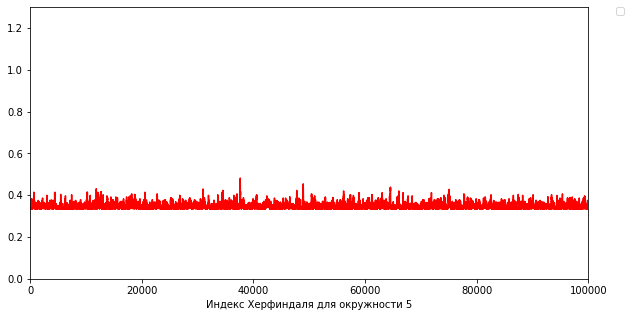

p = [34, 33, 27]


No handles with labels found to put in legend.


debug zero past = 2


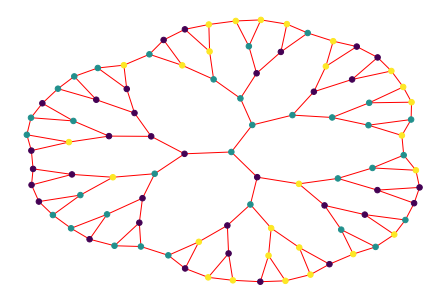

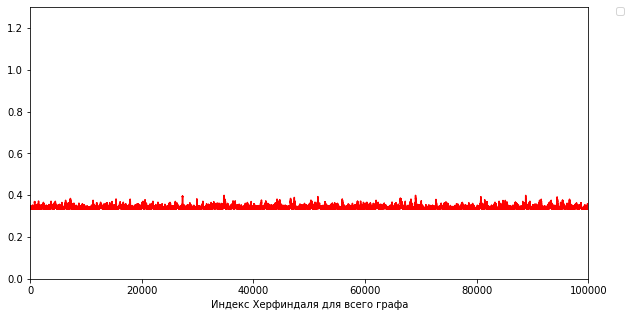

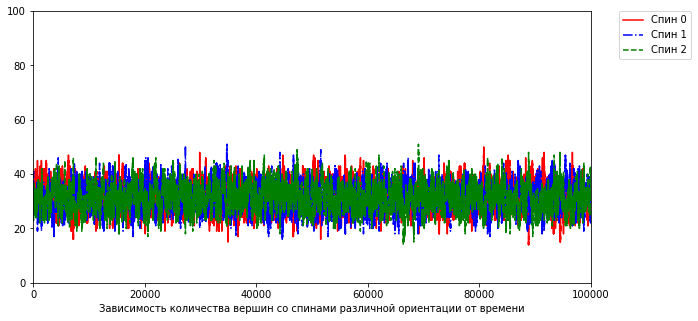

No handles with labels found to put in legend.


p = [31, 33, 30]
zero point


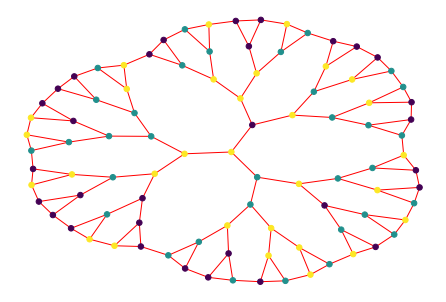

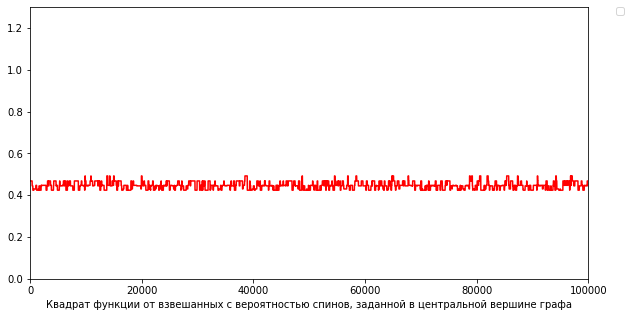

colors of branches
epoch = 0


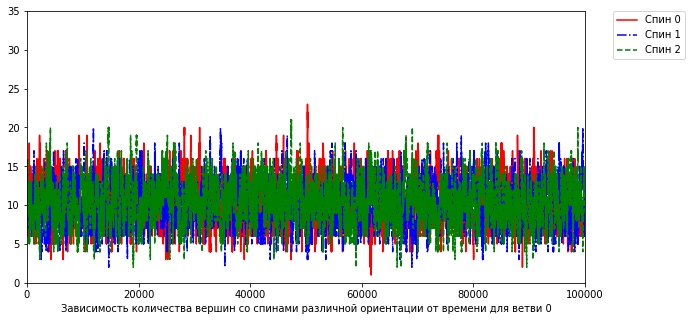

epoch = 1


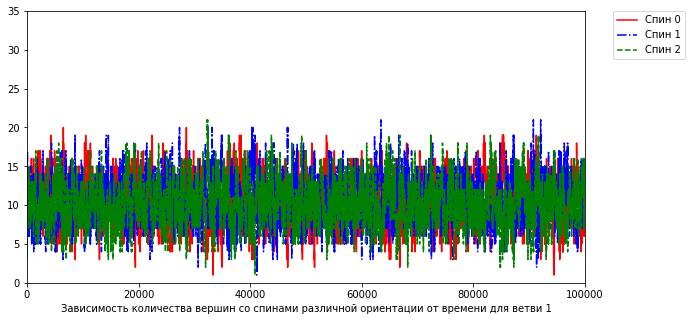

epoch = 2


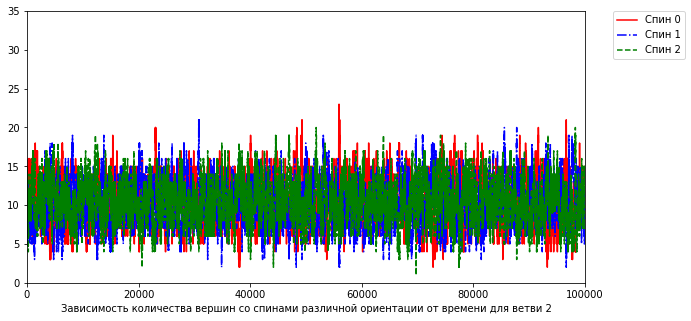

No handles with labels found to put in legend.


Branches
Ветвь 0


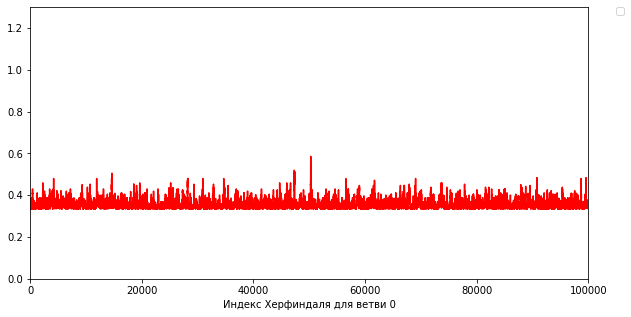

Ветвь 1


No handles with labels found to put in legend.


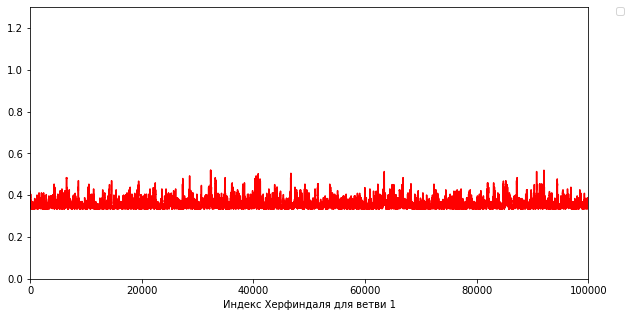

No handles with labels found to put in legend.


Ветвь 2


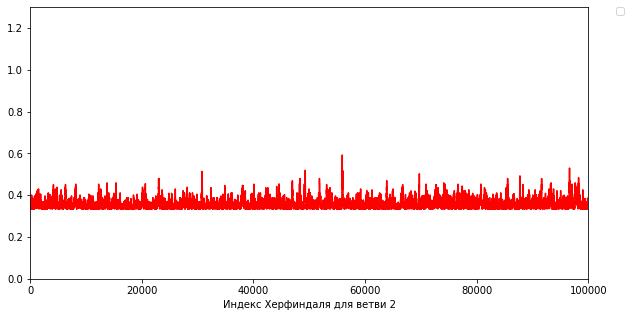

No handles with labels found to put in legend.


Circles
Окружность 0


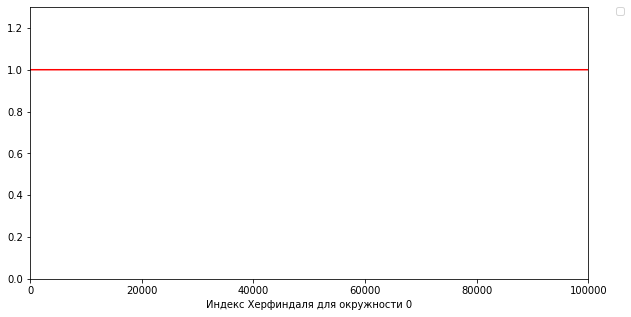

No handles with labels found to put in legend.


Окружность 1


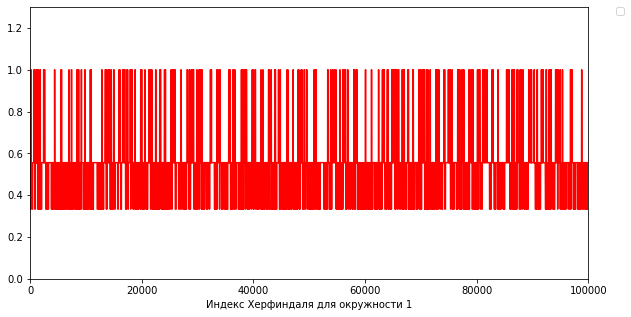

No handles with labels found to put in legend.


Окружность 2


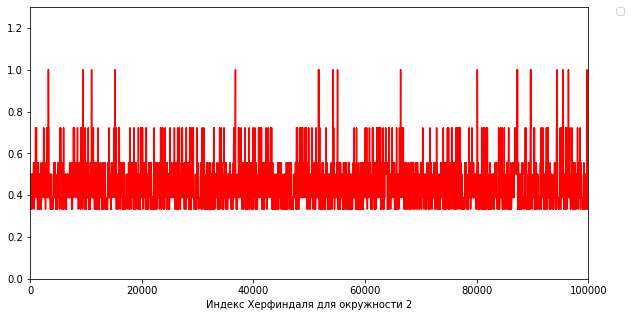

No handles with labels found to put in legend.


Окружность 3


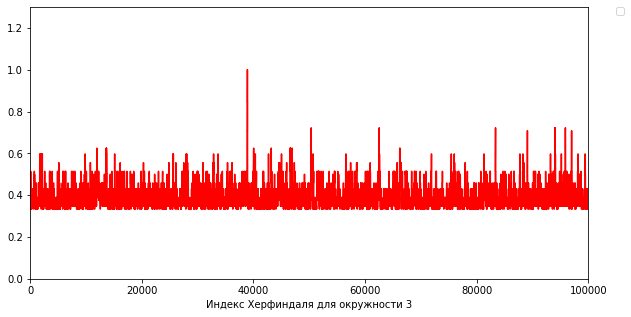

No handles with labels found to put in legend.


Окружность 4


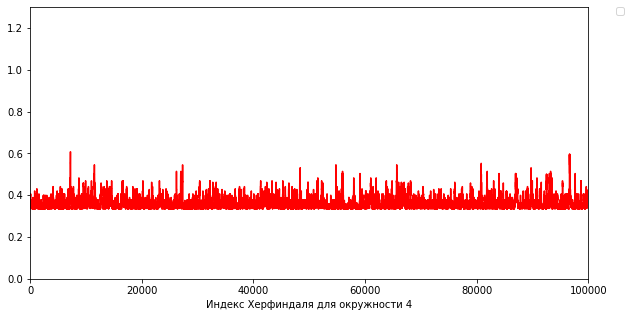

No handles with labels found to put in legend.


Окружность 5


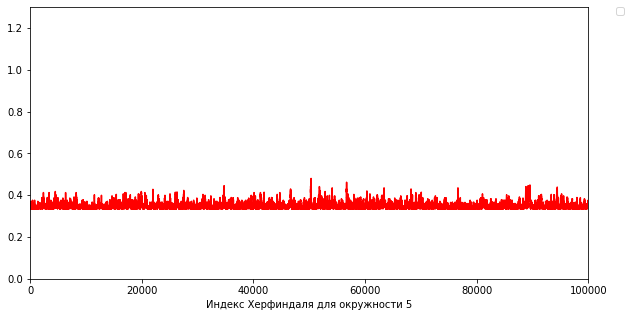

p = [28, 25, 41]


No handles with labels found to put in legend.


debug zero past = 2


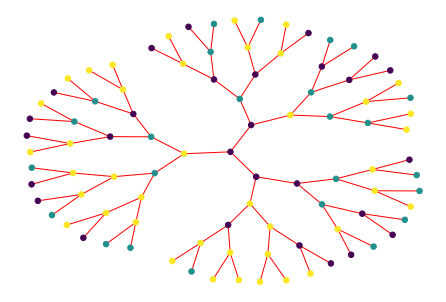

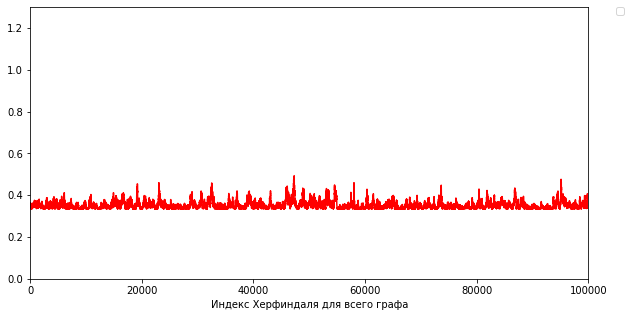

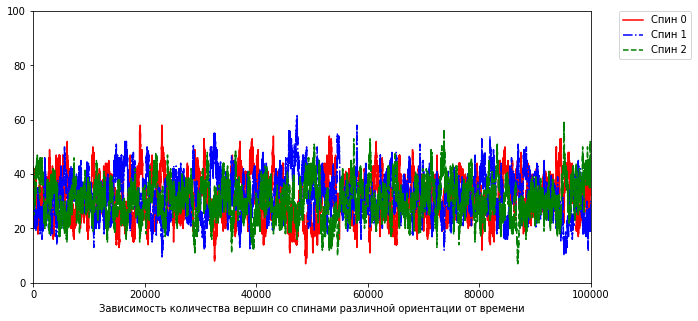

No handles with labels found to put in legend.


p = [21, 27, 46]
zero point


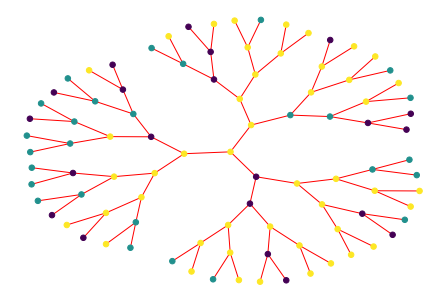

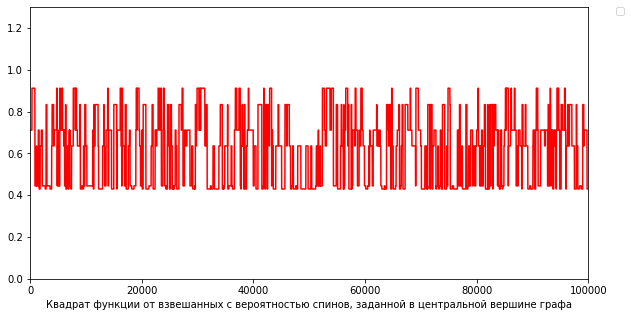

colors of branches
epoch = 0


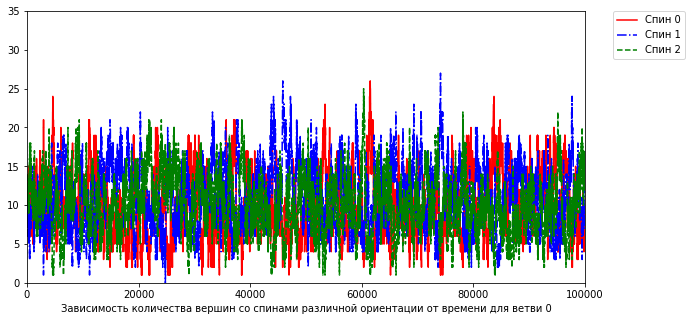

epoch = 1


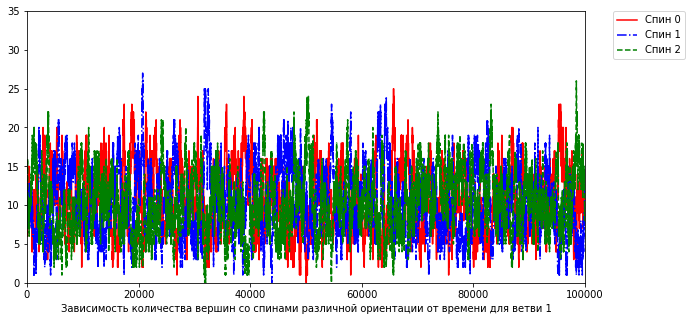

epoch = 2


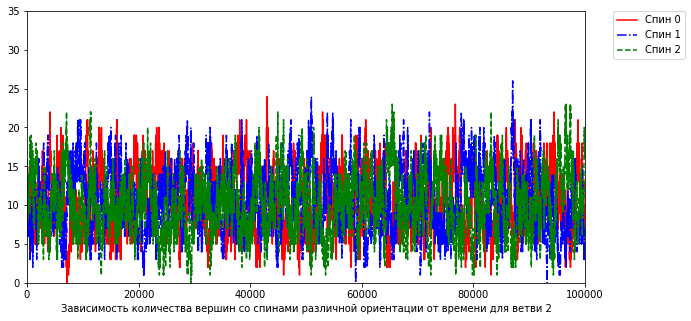

No handles with labels found to put in legend.


Branches
Ветвь 0


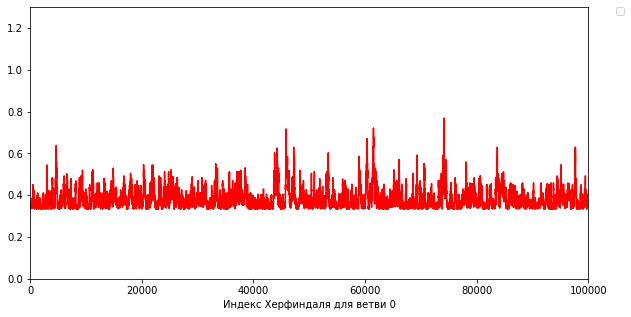

Ветвь 1


No handles with labels found to put in legend.


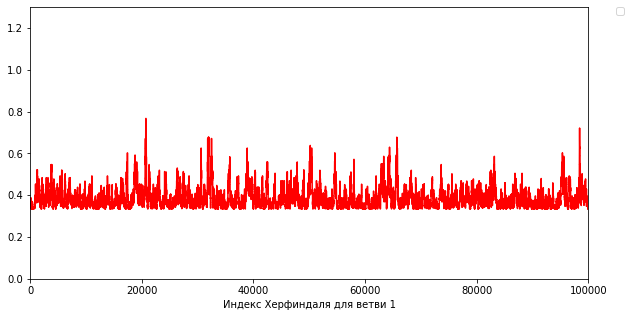

No handles with labels found to put in legend.


Ветвь 2


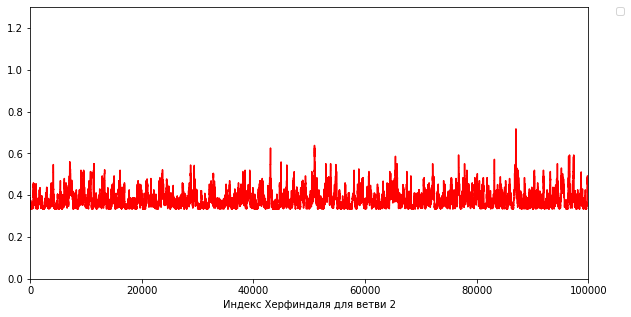

No handles with labels found to put in legend.


Circles
Окружность 0


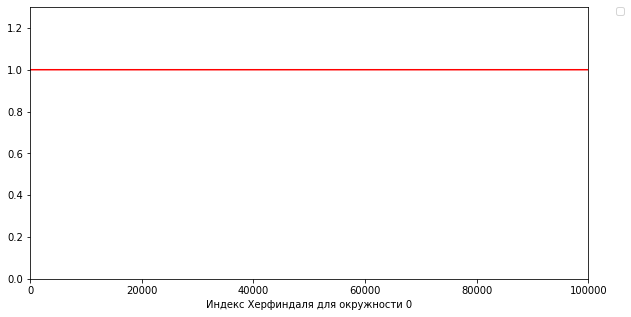

Окружность 1


No handles with labels found to put in legend.


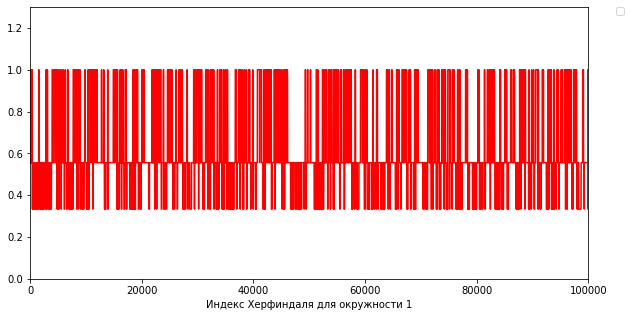

No handles with labels found to put in legend.


Окружность 2


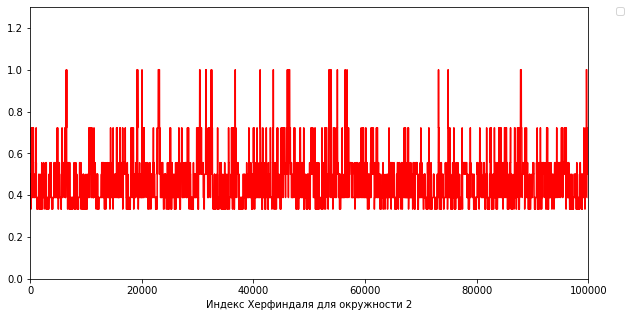

No handles with labels found to put in legend.


Окружность 3


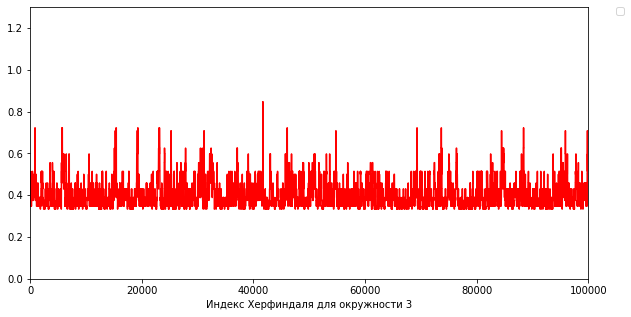

No handles with labels found to put in legend.


Окружность 4


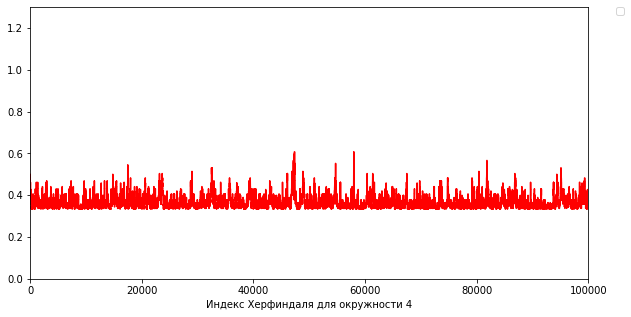

No handles with labels found to put in legend.


Окружность 5


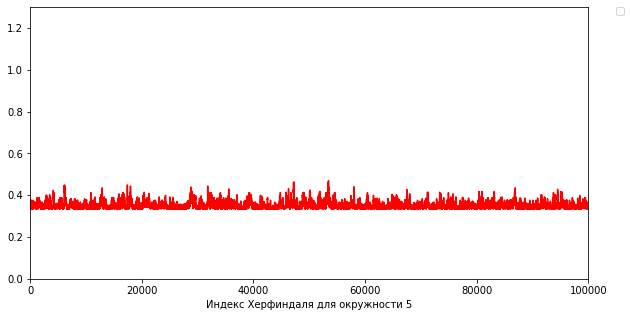

p = [36, 29, 29]


No handles with labels found to put in legend.


debug zero past = 2


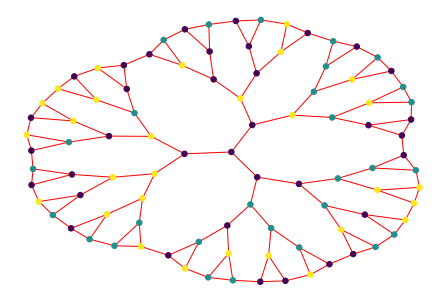

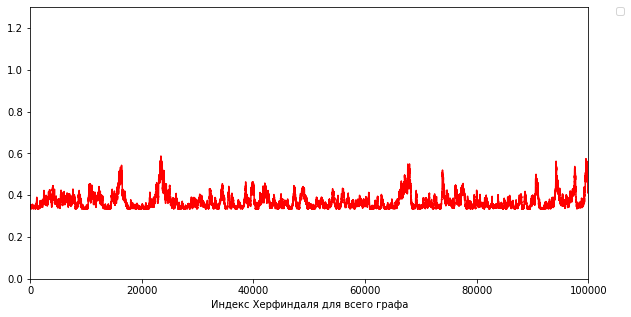

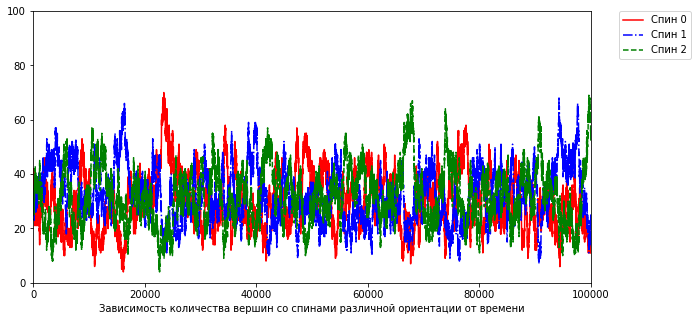

No handles with labels found to put in legend.


p = [14, 24, 56]
zero point


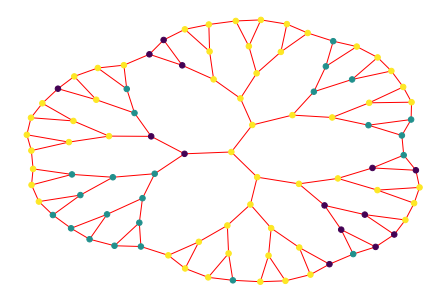

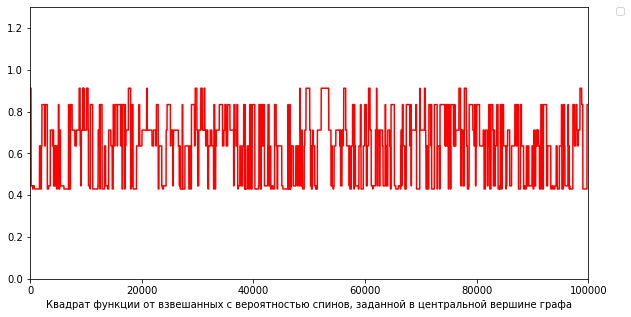

colors of branches
epoch = 0


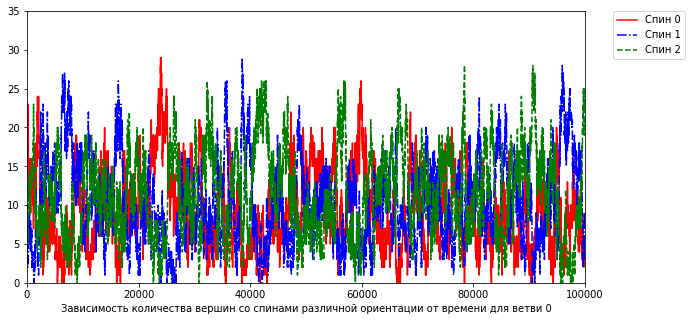

epoch = 1


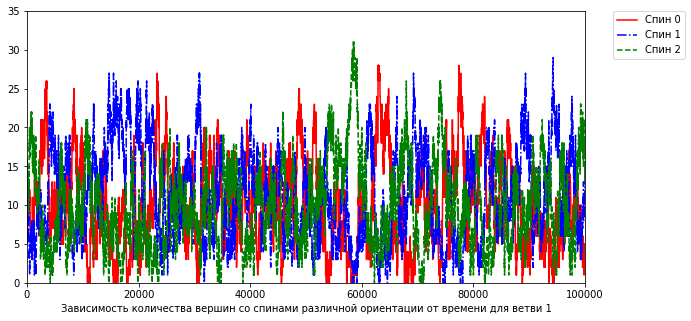

epoch = 2


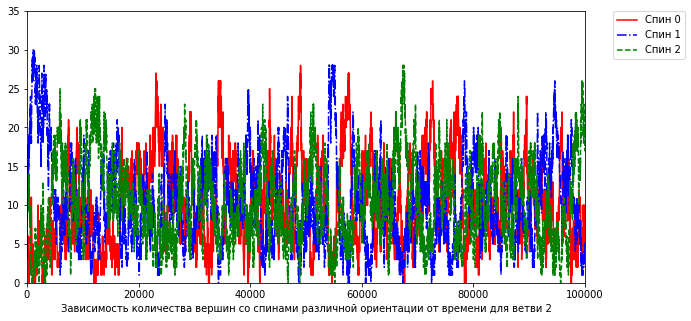

No handles with labels found to put in legend.


Branches
Ветвь 0


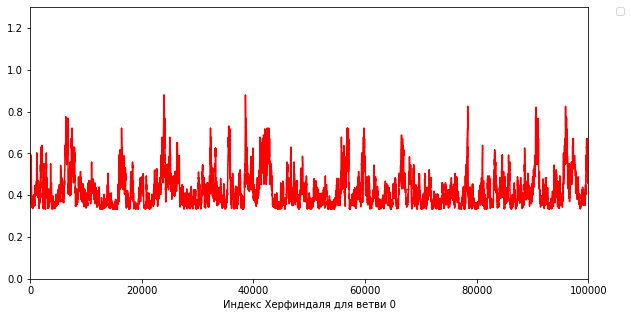

No handles with labels found to put in legend.


Ветвь 1


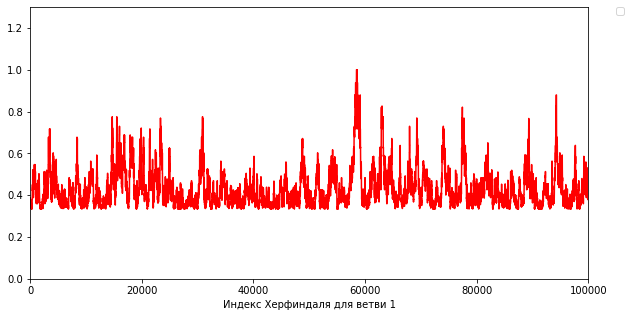

No handles with labels found to put in legend.


Ветвь 2


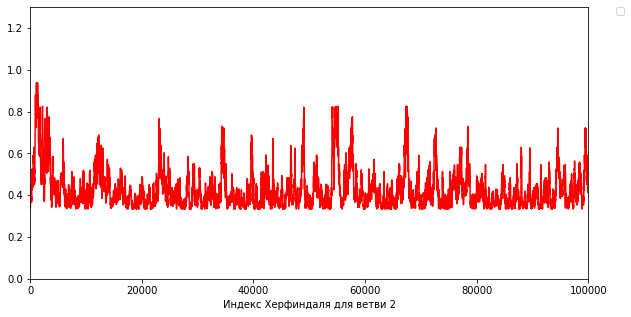

No handles with labels found to put in legend.


Circles
Окружность 0


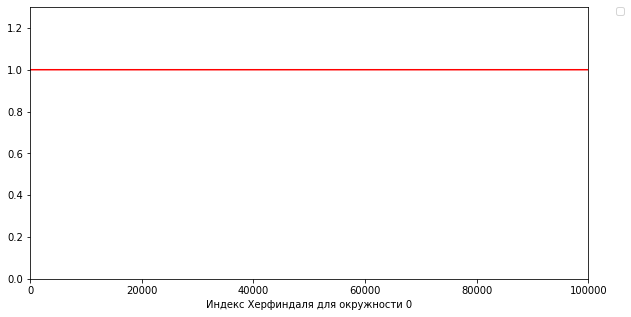

No handles with labels found to put in legend.


Окружность 1


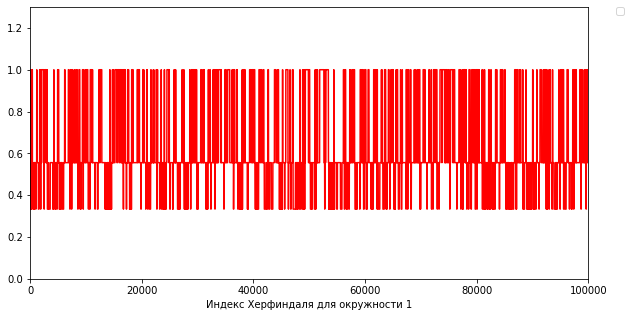

No handles with labels found to put in legend.


Окружность 2


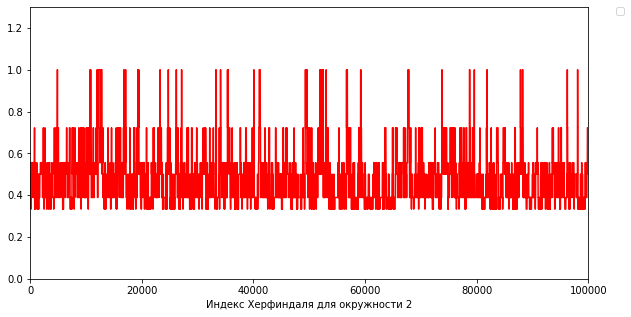

No handles with labels found to put in legend.


Окружность 3


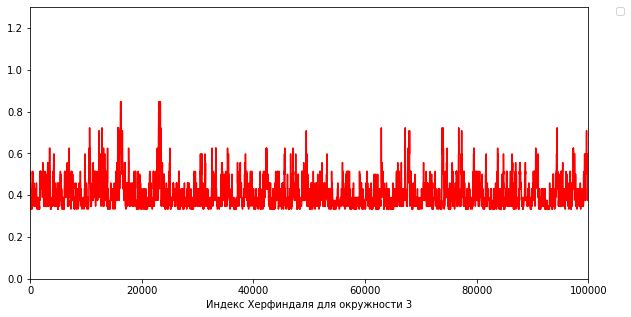

No handles with labels found to put in legend.


Окружность 4


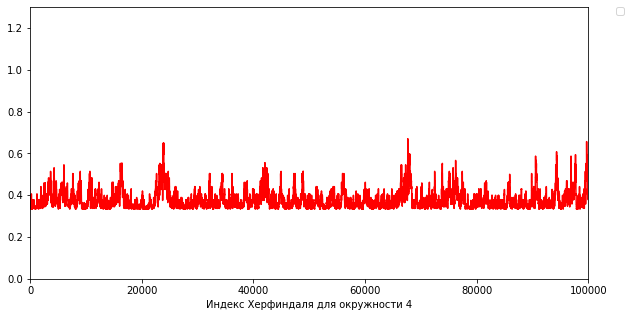

No handles with labels found to put in legend.


Окружность 5


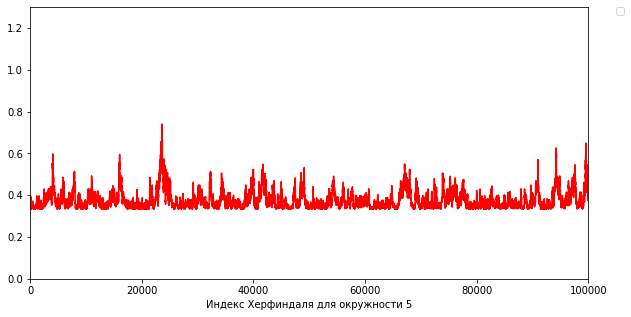

p = [32, 38, 24]


No handles with labels found to put in legend.


debug zero past = 0


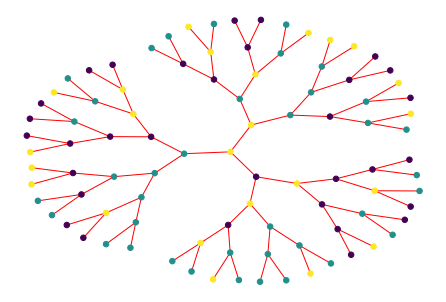

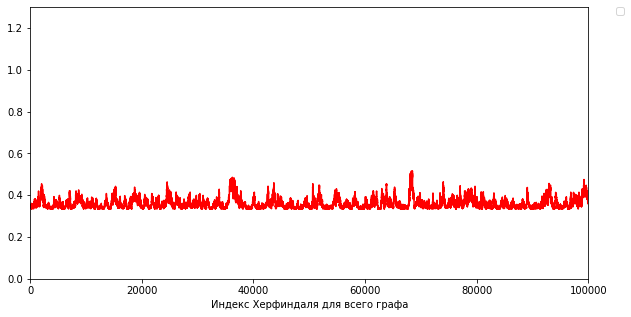

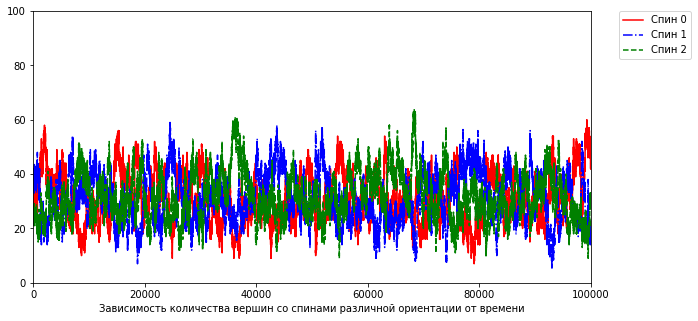

No handles with labels found to put in legend.


p = [42, 20, 32]
zero point


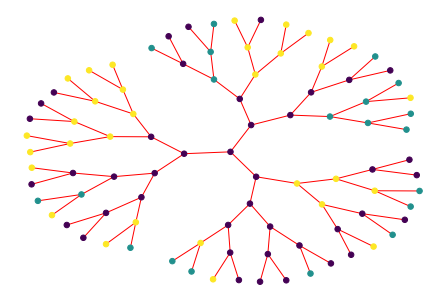

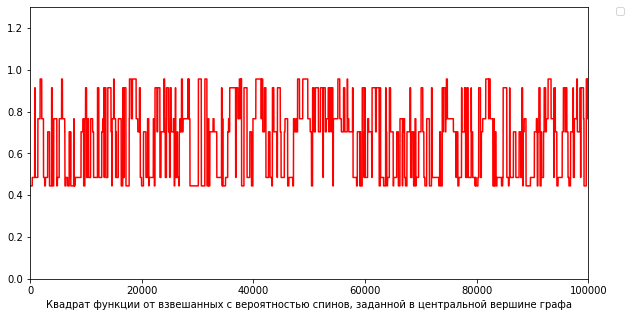

colors of branches
epoch = 0


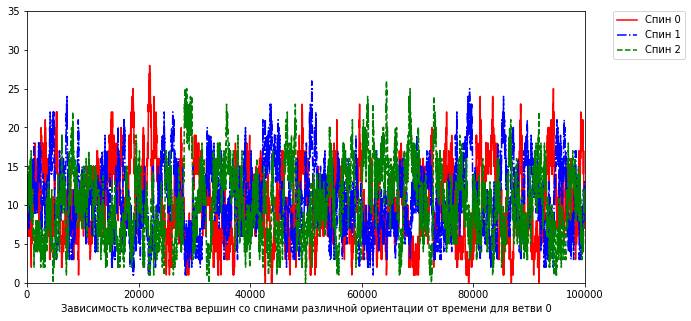

epoch = 1


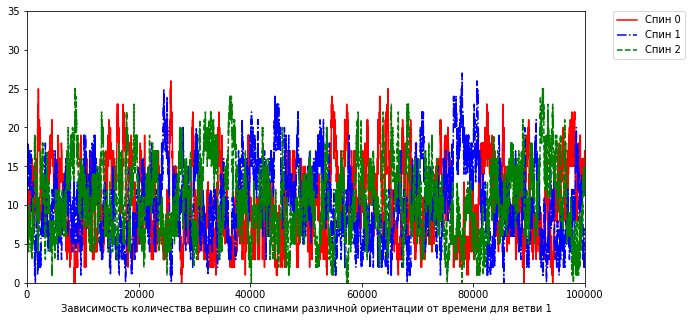

epoch = 2


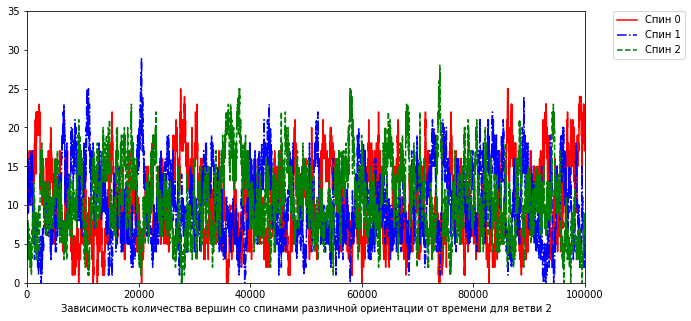

No handles with labels found to put in legend.


Branches
Ветвь 0


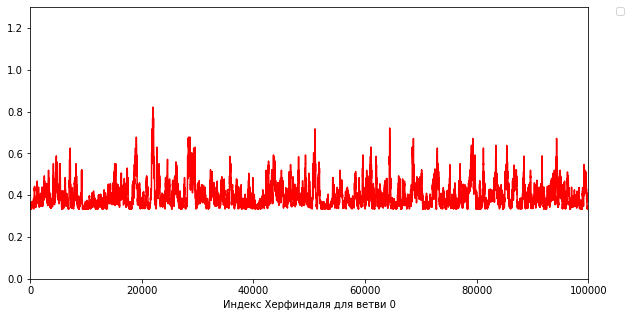

No handles with labels found to put in legend.


Ветвь 1


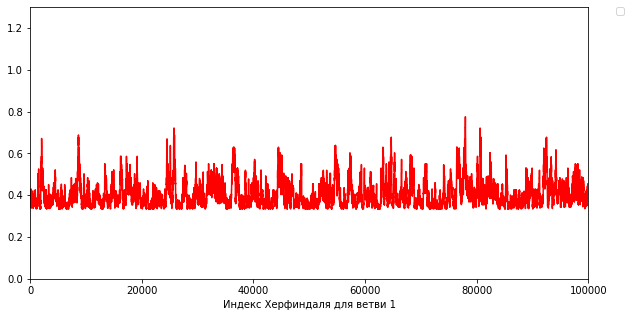

No handles with labels found to put in legend.


Ветвь 2


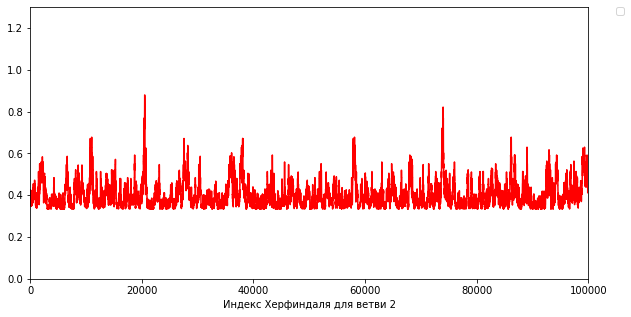

No handles with labels found to put in legend.


Circles
Окружность 0


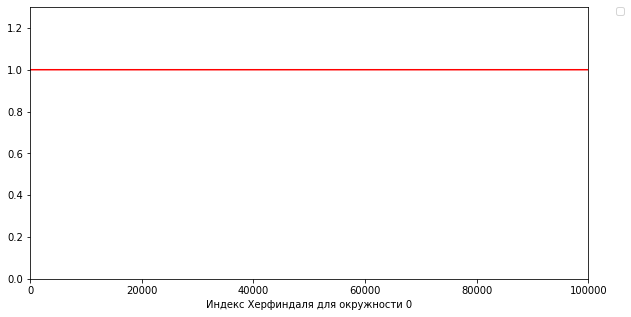

No handles with labels found to put in legend.


Окружность 1


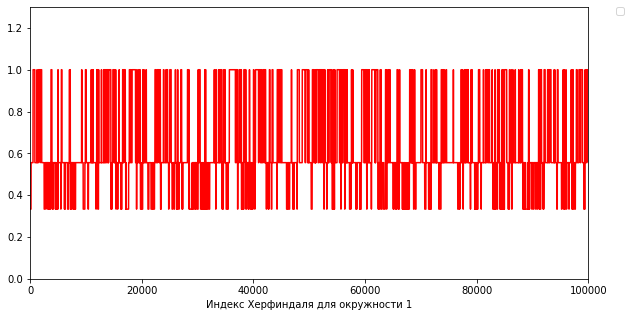

No handles with labels found to put in legend.


Окружность 2


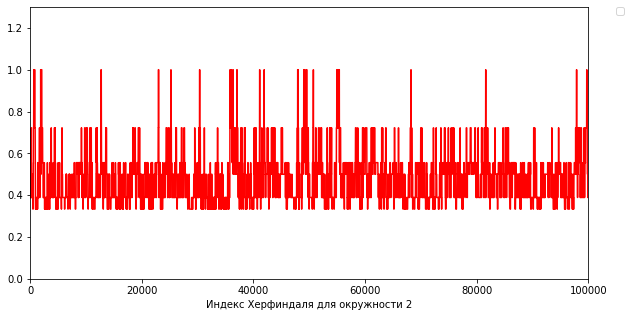

No handles with labels found to put in legend.


Окружность 3


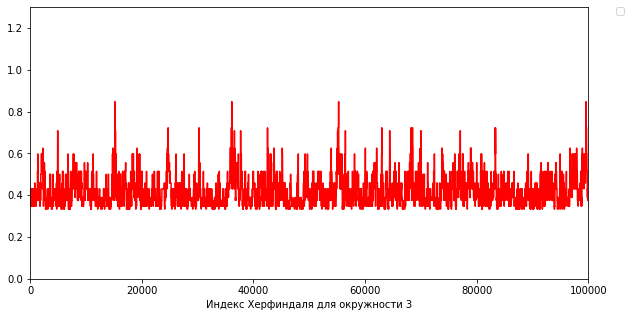

No handles with labels found to put in legend.


Окружность 4


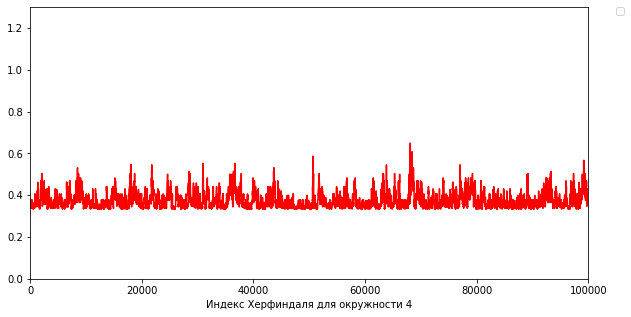

Окружность 5


No handles with labels found to put in legend.


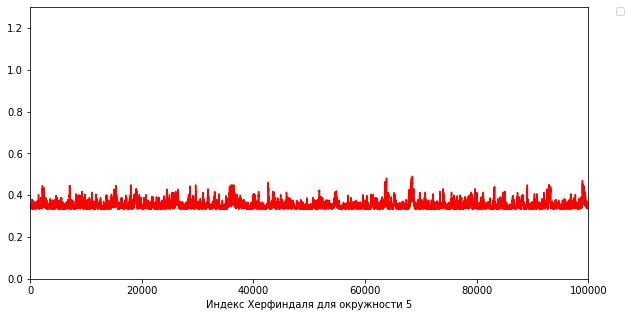

p = [25, 37, 32]


No handles with labels found to put in legend.


debug zero past = 0


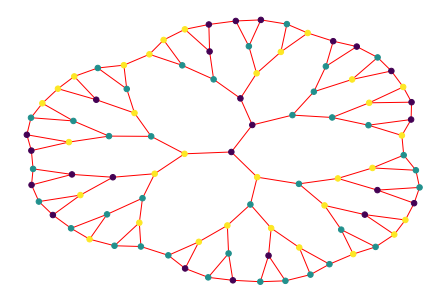

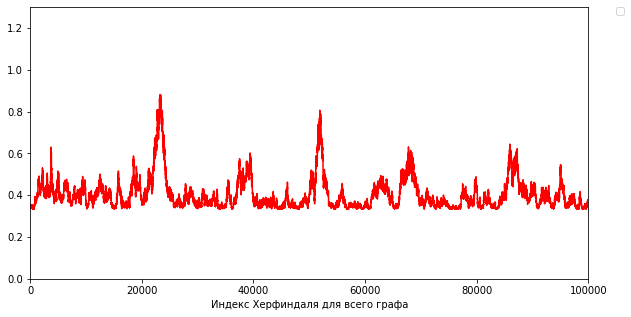

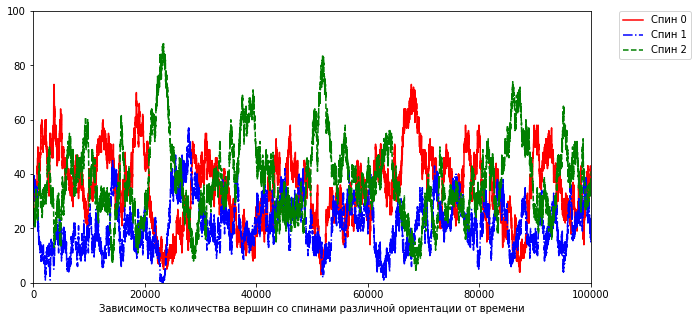

No handles with labels found to put in legend.


p = [37, 16, 41]
zero point


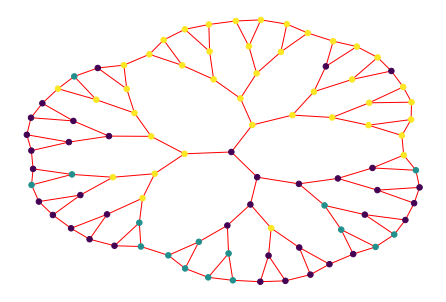

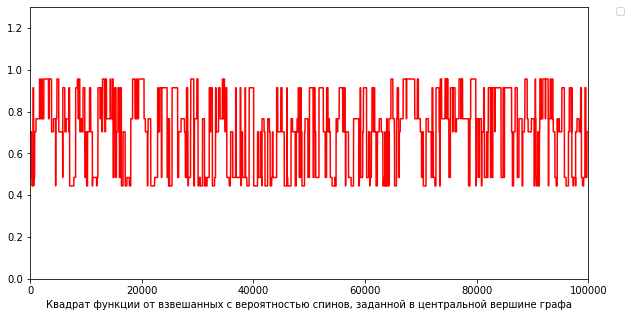

colors of branches
epoch = 0


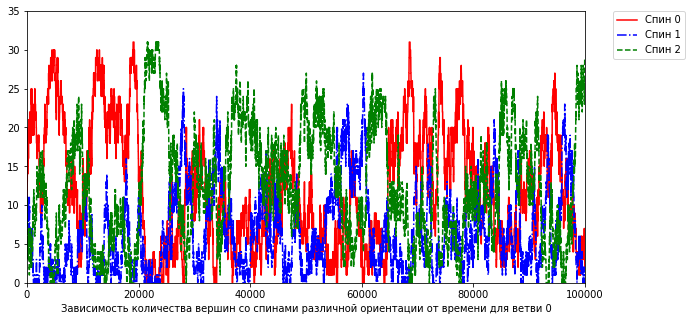

epoch = 1


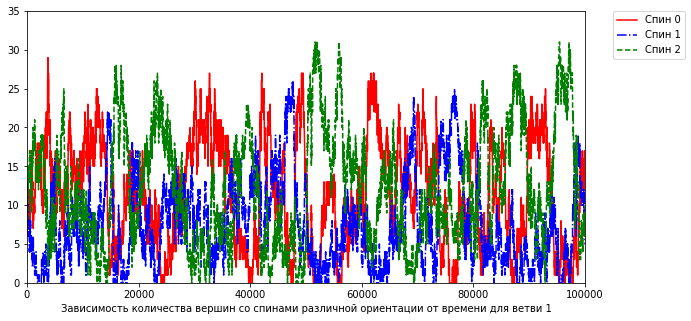

epoch = 2


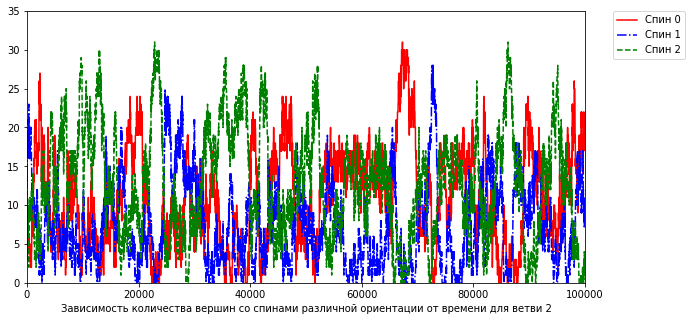

No handles with labels found to put in legend.


Branches
Ветвь 0


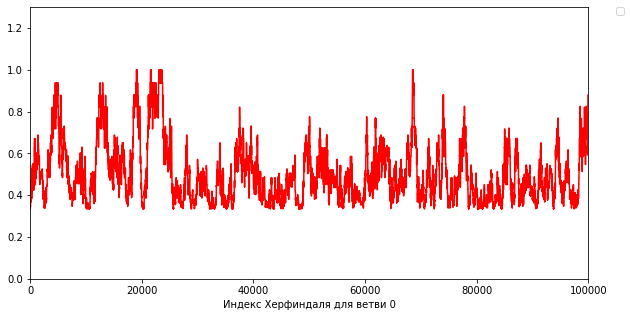

No handles with labels found to put in legend.


Ветвь 1


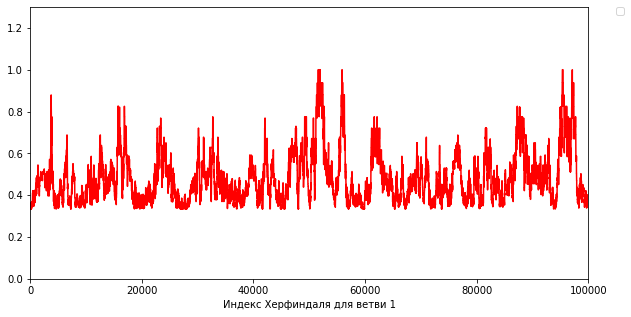

No handles with labels found to put in legend.


Ветвь 2


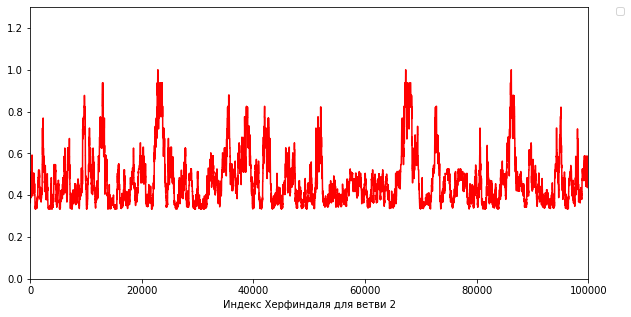

No handles with labels found to put in legend.


Circles
Окружность 0


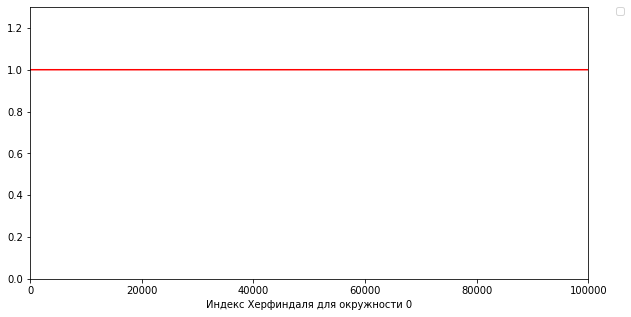

No handles with labels found to put in legend.


Окружность 1


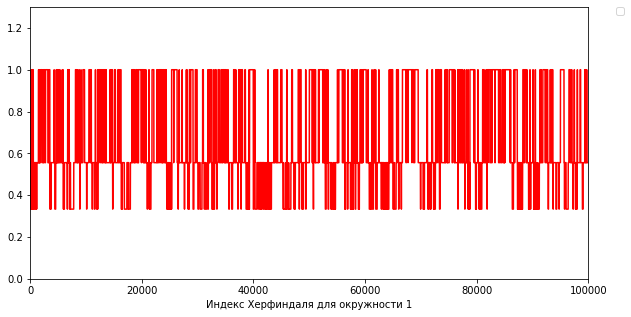

Окружность 2


No handles with labels found to put in legend.


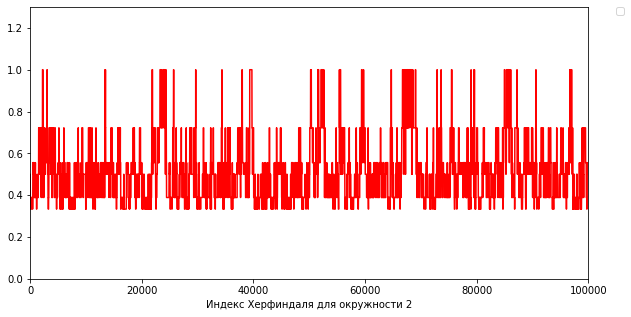

No handles with labels found to put in legend.


Окружность 3


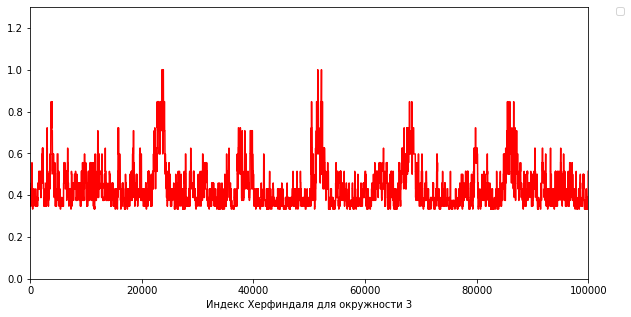

No handles with labels found to put in legend.


Окружность 4


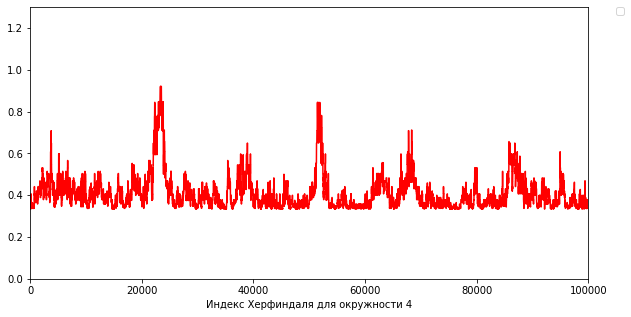

Окружность 5


No handles with labels found to put in legend.


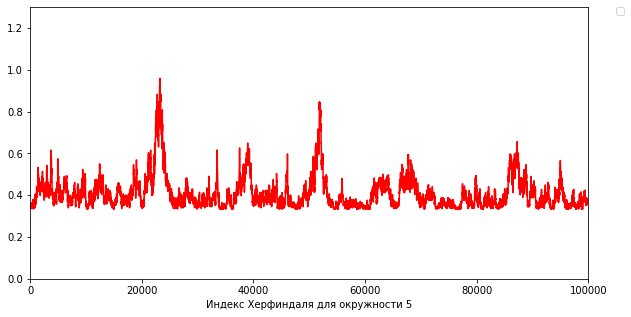

p = [29, 35, 30]


No handles with labels found to put in legend.


debug zero past = 1


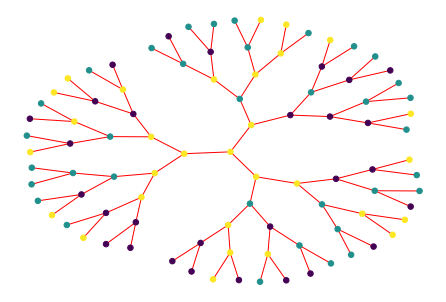

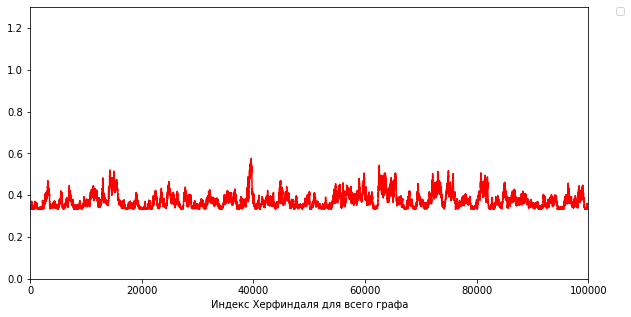

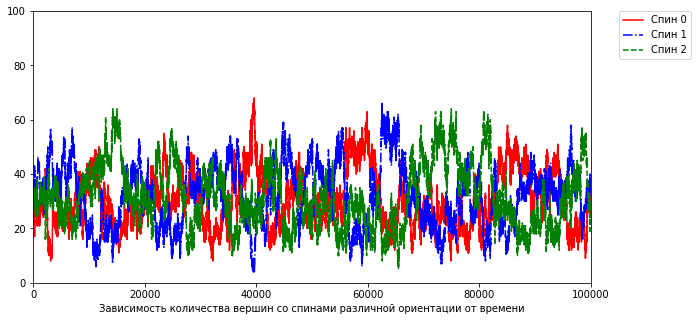

No handles with labels found to put in legend.


p = [33, 37, 24]
zero point


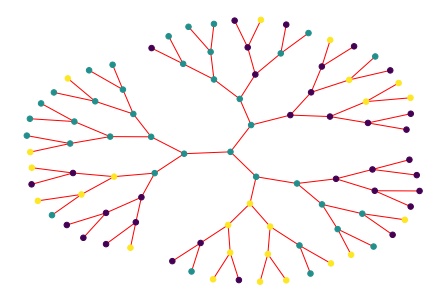

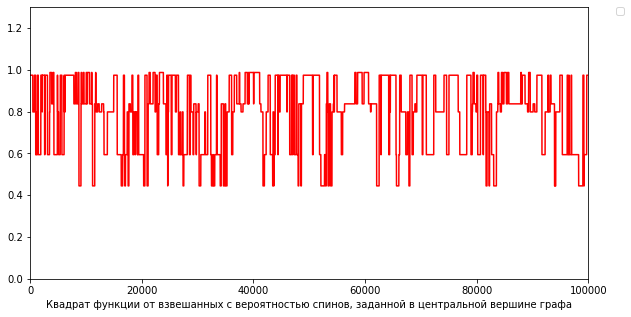

colors of branches
epoch = 0


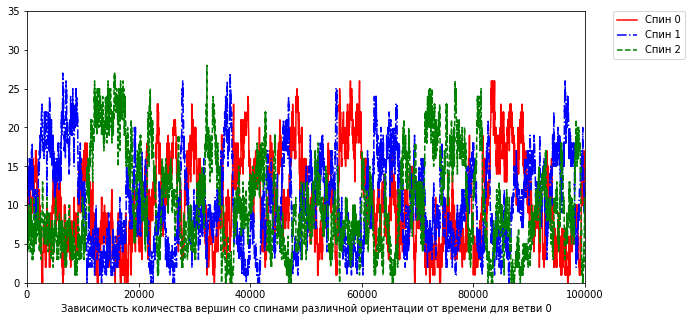

epoch = 1


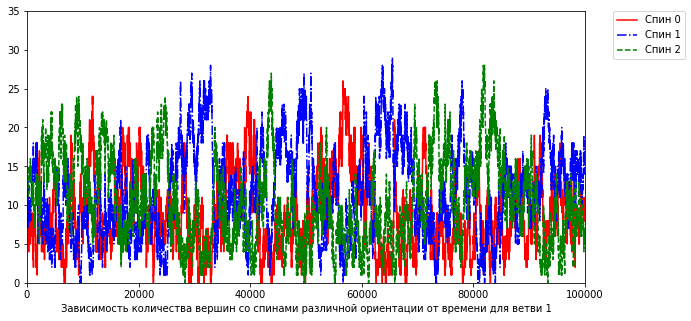

epoch = 2


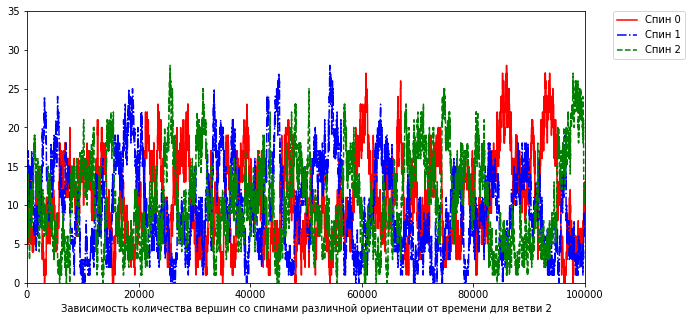

No handles with labels found to put in legend.


Branches
Ветвь 0


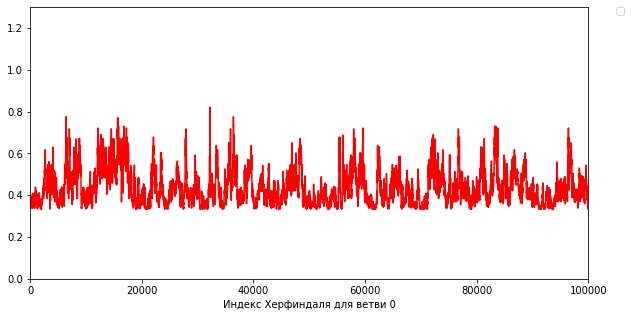

No handles with labels found to put in legend.


Ветвь 1


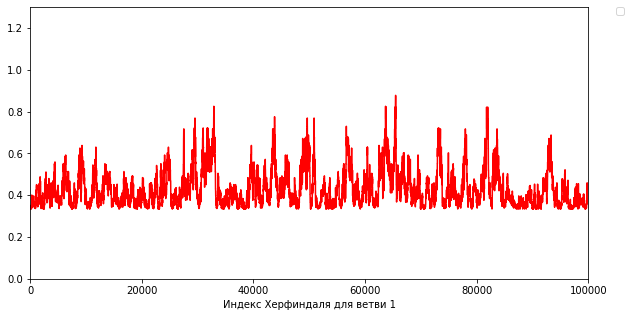

No handles with labels found to put in legend.


Ветвь 2


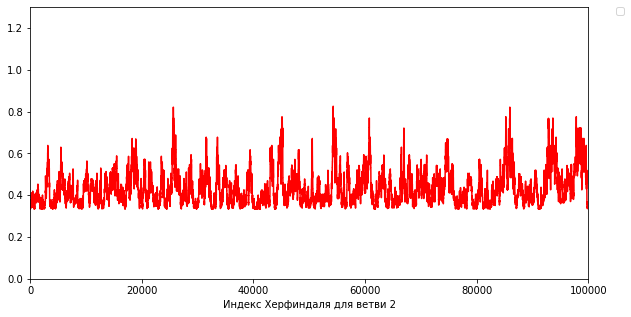

No handles with labels found to put in legend.


Circles
Окружность 0


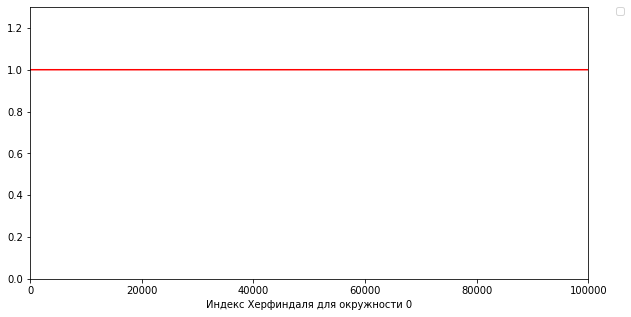

No handles with labels found to put in legend.


Окружность 1


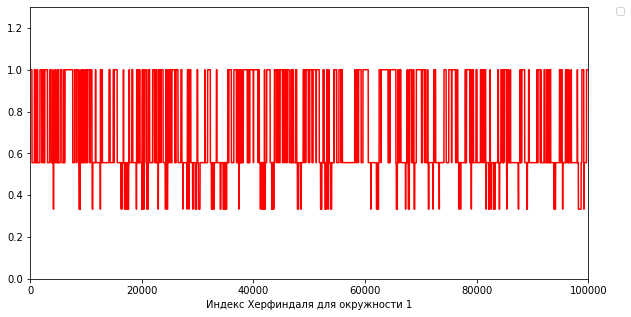

No handles with labels found to put in legend.


Окружность 2


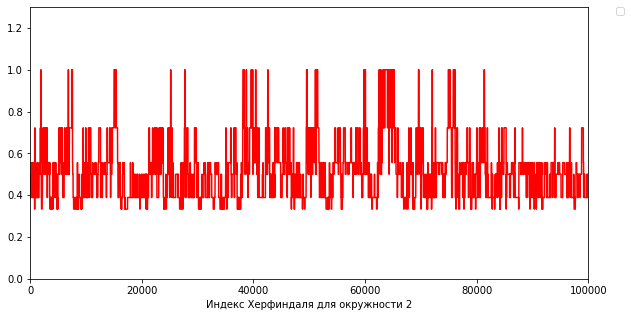

No handles with labels found to put in legend.


Окружность 3


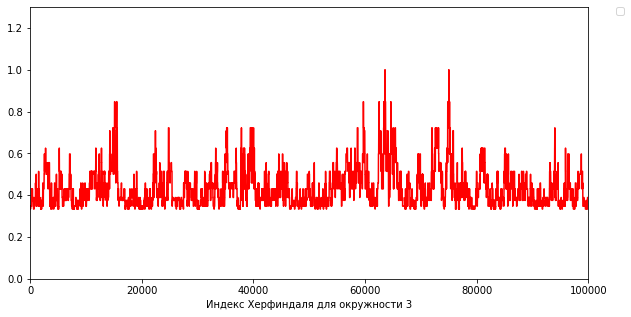

No handles with labels found to put in legend.


Окружность 4


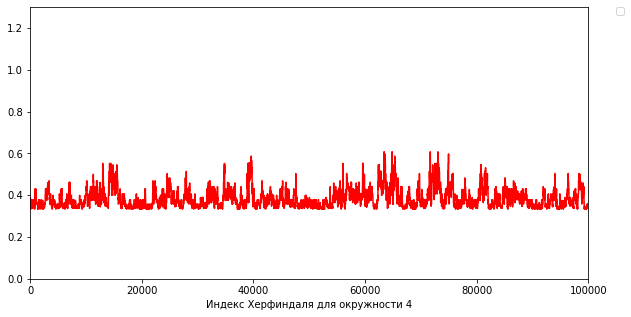

No handles with labels found to put in legend.


Окружность 5


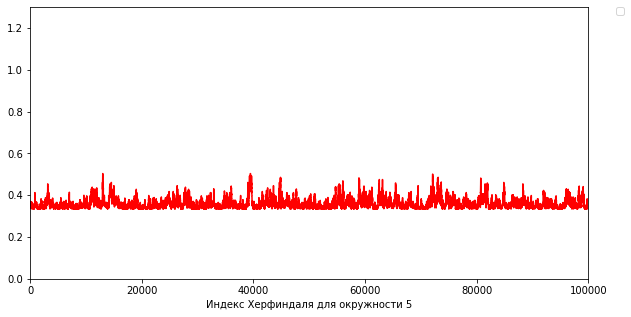

p = [32, 22, 40]


No handles with labels found to put in legend.


debug zero past = 1


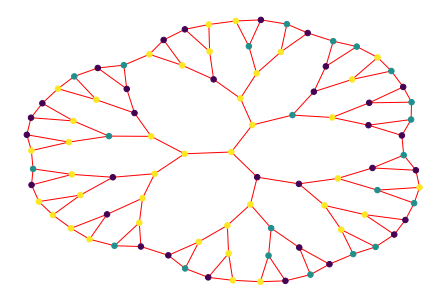

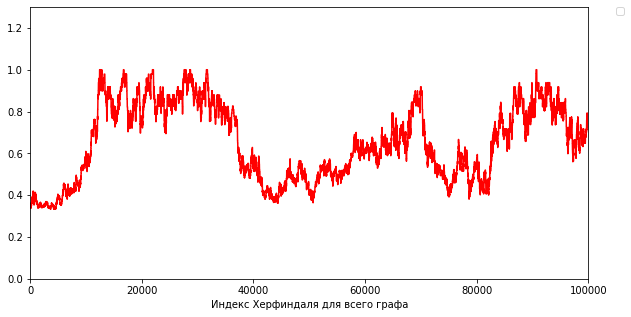

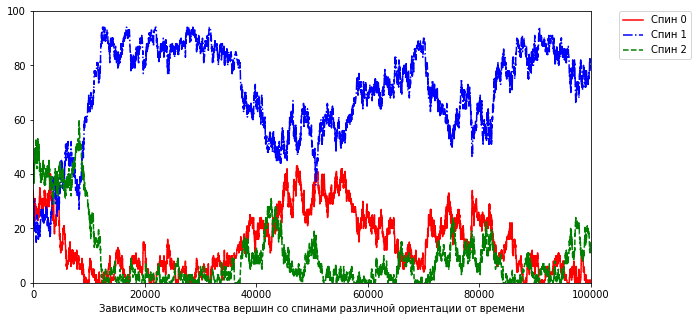

No handles with labels found to put in legend.


p = [1, 78, 15]
zero point


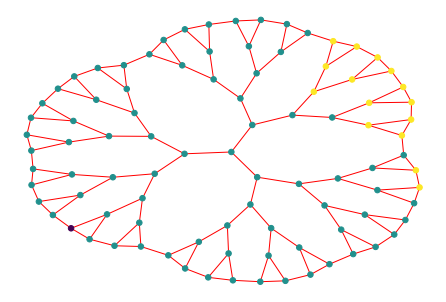

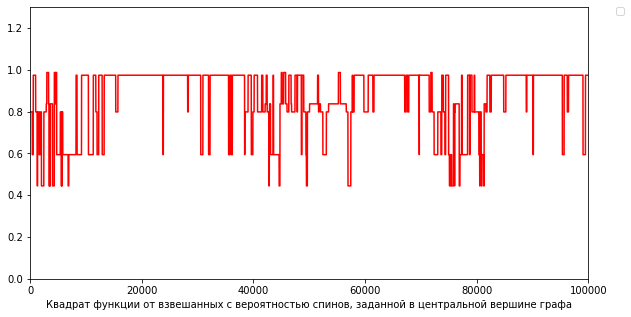

colors of branches
epoch = 0


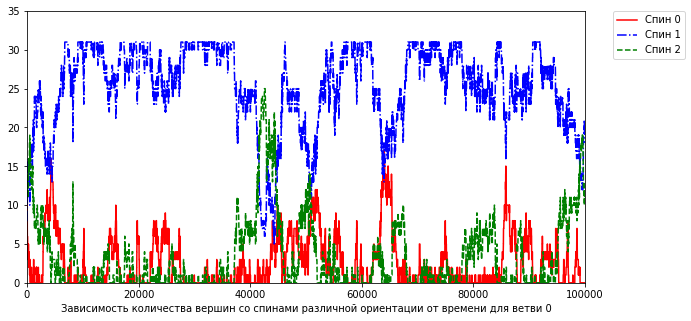

epoch = 1


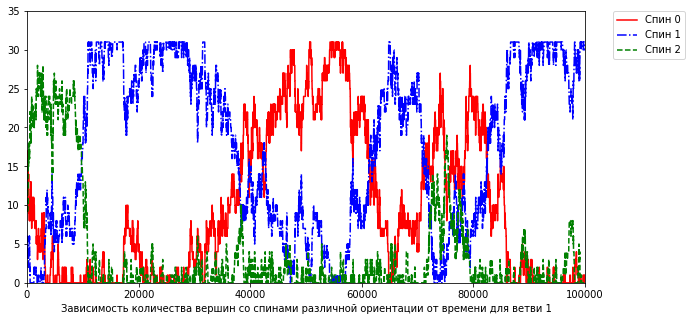

epoch = 2


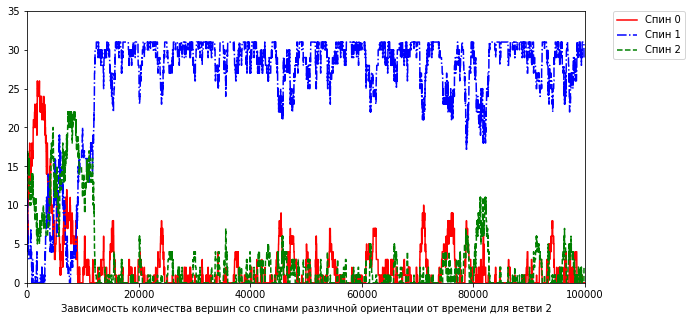

No handles with labels found to put in legend.


Branches
Ветвь 0


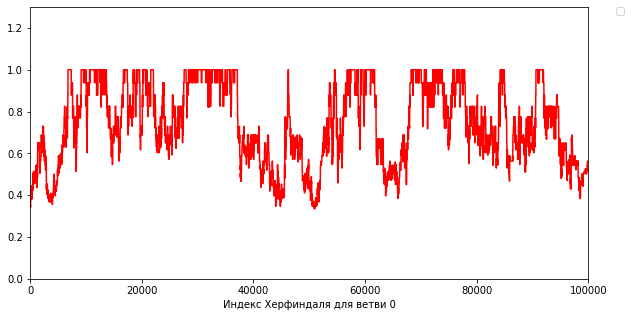

No handles with labels found to put in legend.


Ветвь 1


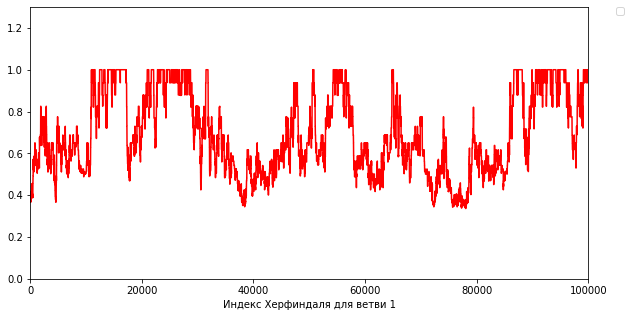

No handles with labels found to put in legend.


Ветвь 2


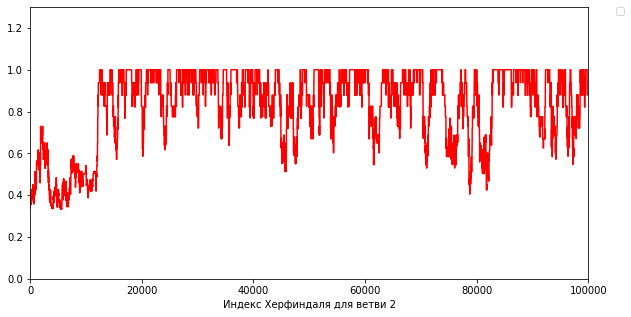

No handles with labels found to put in legend.


Circles
Окружность 0


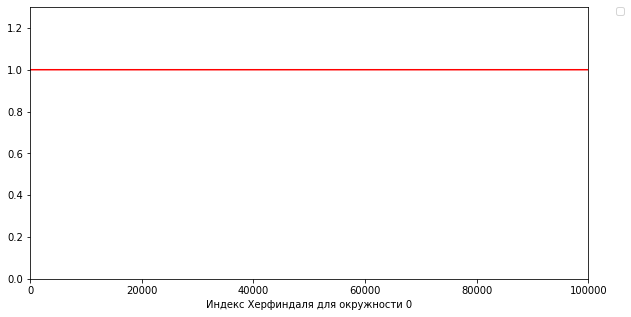

Окружность 1


No handles with labels found to put in legend.


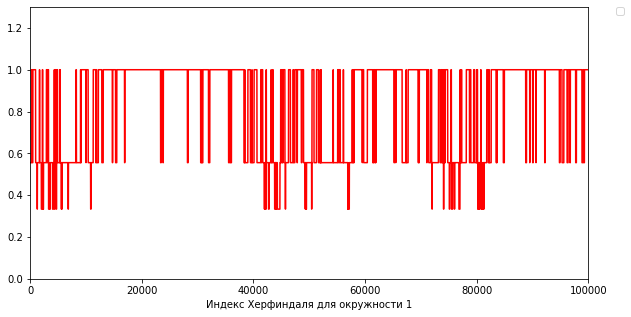

No handles with labels found to put in legend.


Окружность 2


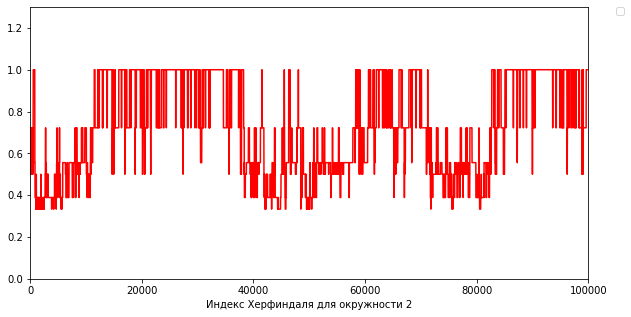

No handles with labels found to put in legend.


Окружность 3


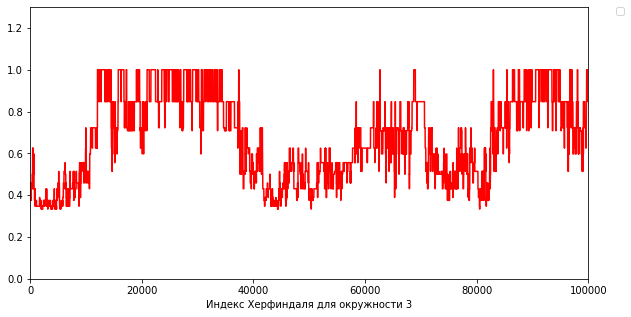

No handles with labels found to put in legend.


Окружность 4


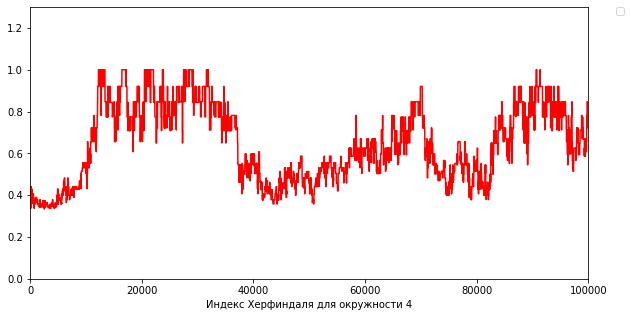

No handles with labels found to put in legend.


Окружность 5


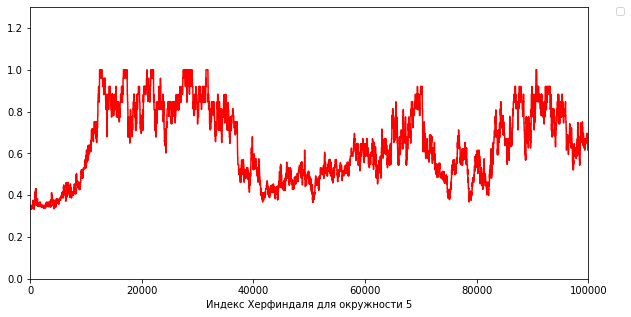

p = [30, 34, 30]


No handles with labels found to put in legend.


debug zero past = 2


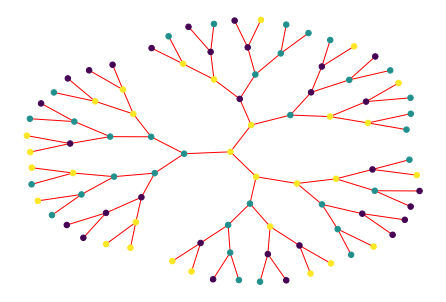

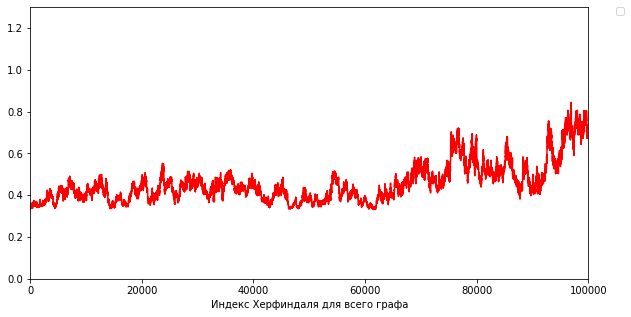

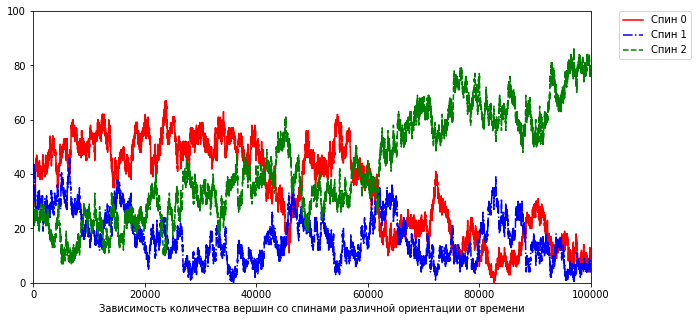

No handles with labels found to put in legend.


p = [10, 8, 76]
zero point


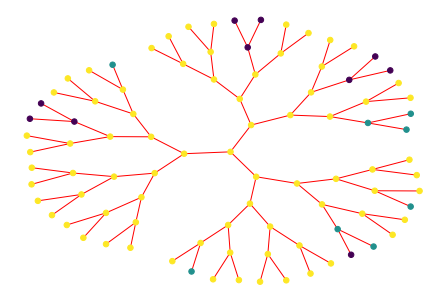

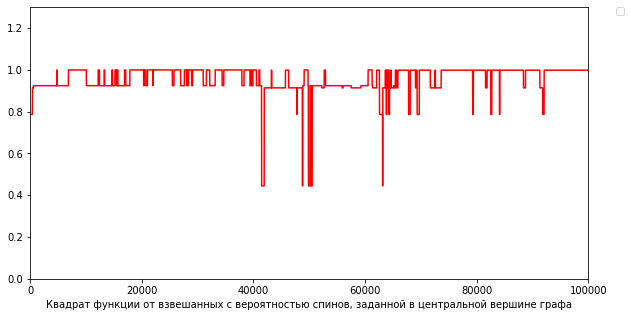

colors of branches
epoch = 0


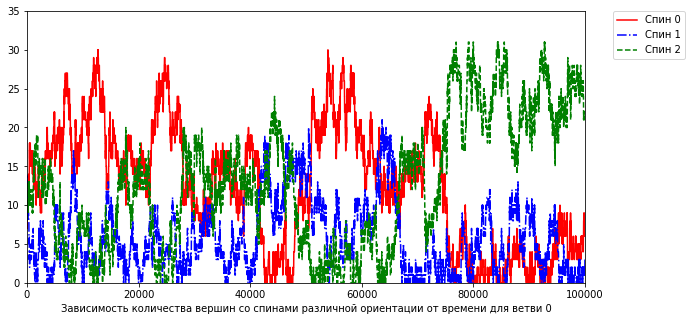

epoch = 1


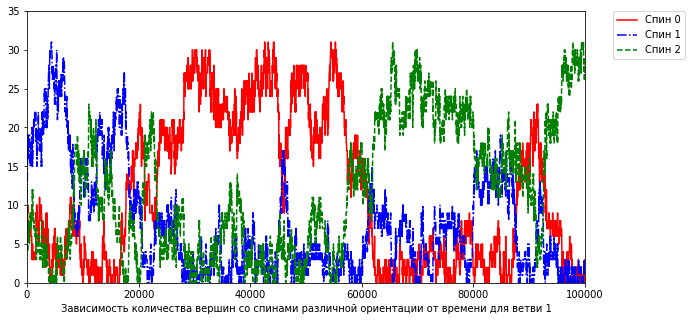

epoch = 2


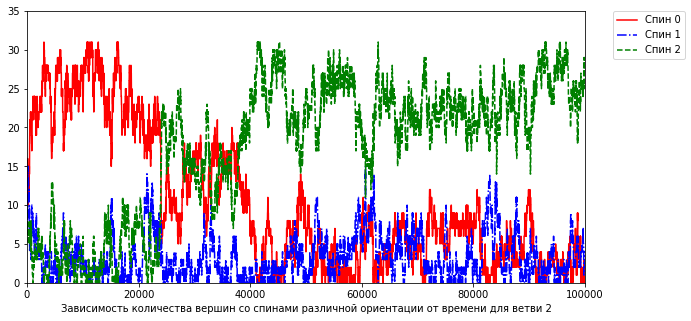

No handles with labels found to put in legend.


Branches
Ветвь 0


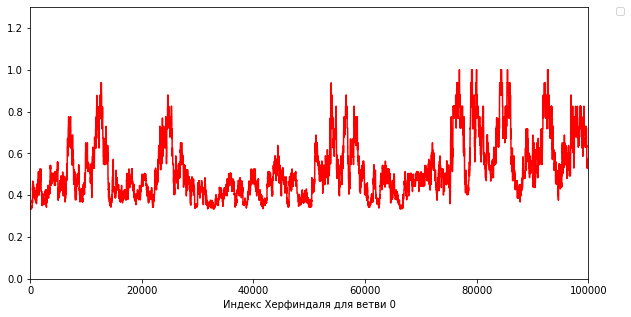

No handles with labels found to put in legend.


Ветвь 1


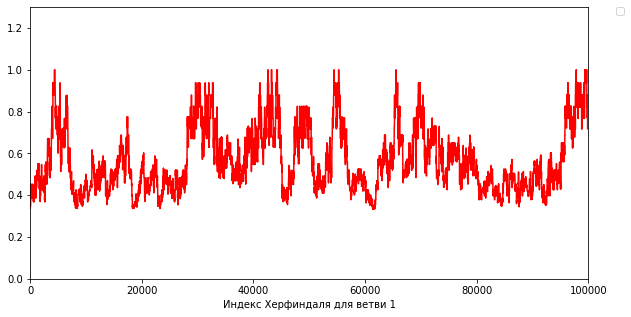

No handles with labels found to put in legend.


Ветвь 2


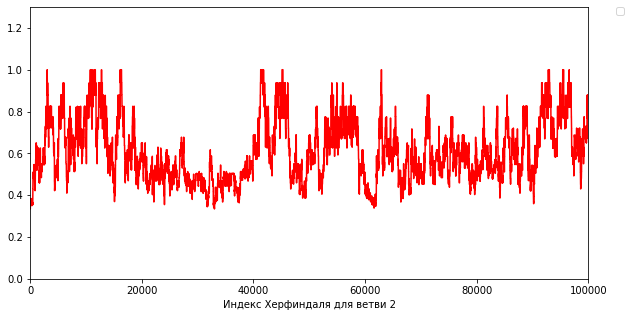

No handles with labels found to put in legend.


Circles
Окружность 0


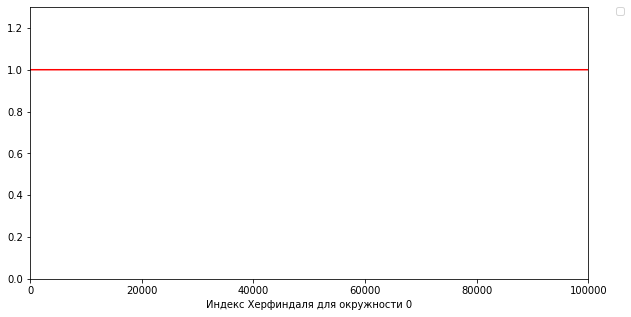

No handles with labels found to put in legend.


Окружность 1


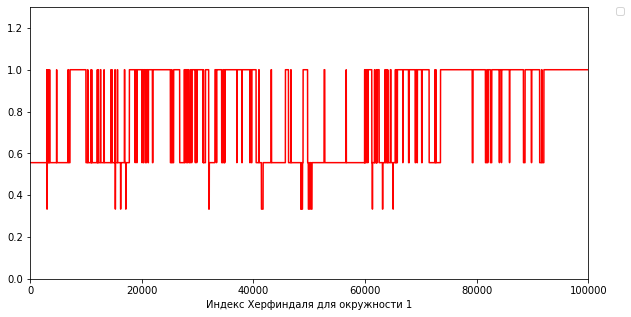

No handles with labels found to put in legend.


Окружность 2


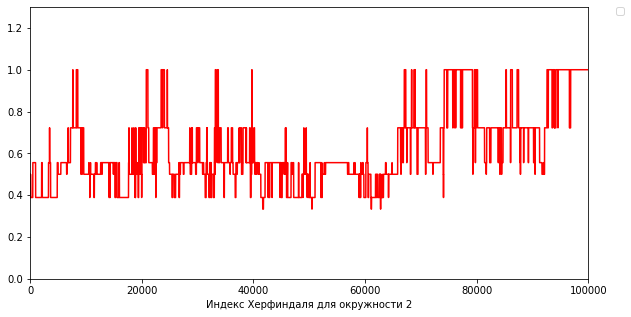

No handles with labels found to put in legend.


Окружность 3


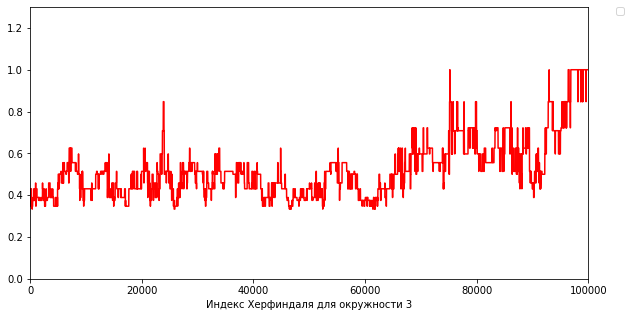

No handles with labels found to put in legend.


Окружность 4


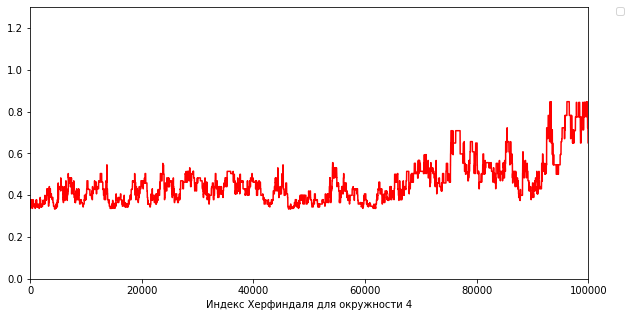

No handles with labels found to put in legend.


Окружность 5


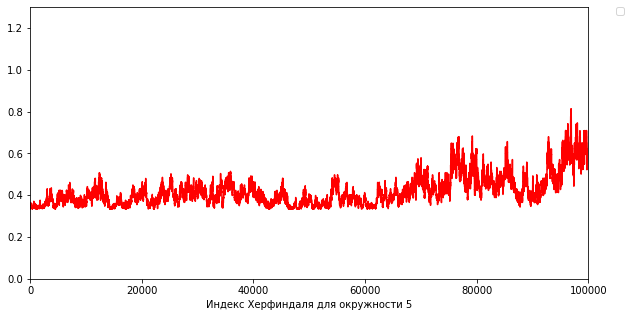

p = [36, 29, 29]


No handles with labels found to put in legend.


debug zero past = 1


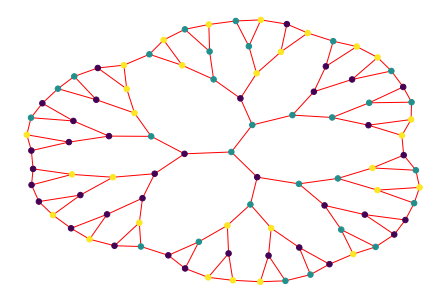

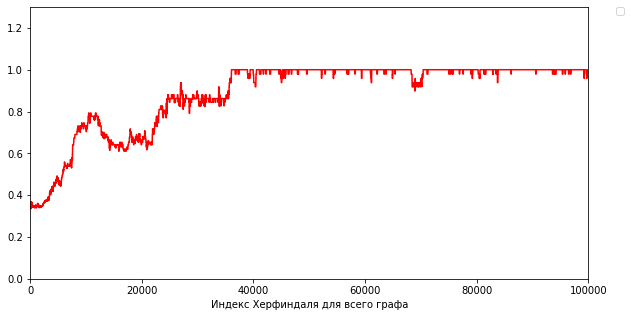

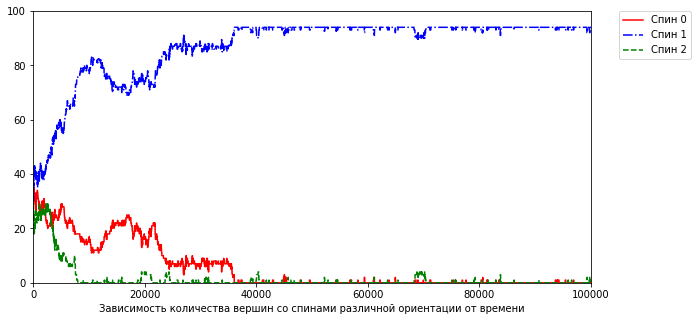

No handles with labels found to put in legend.


p = [94]
zero point


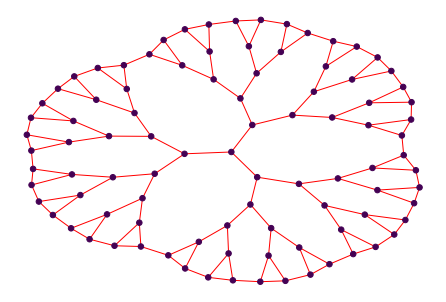

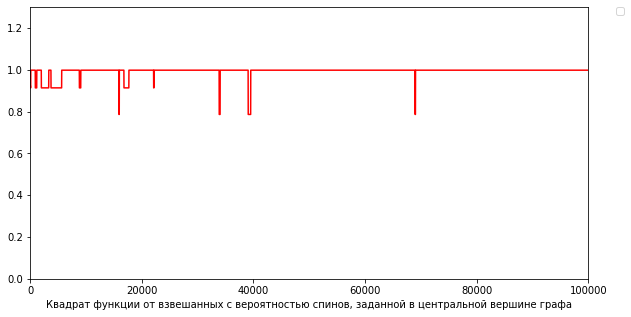

colors of branches
epoch = 0


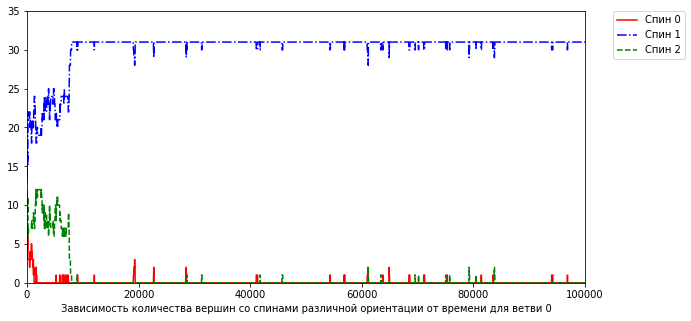

epoch = 1


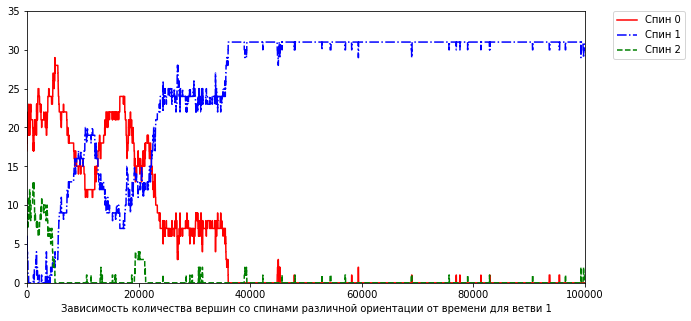

epoch = 2


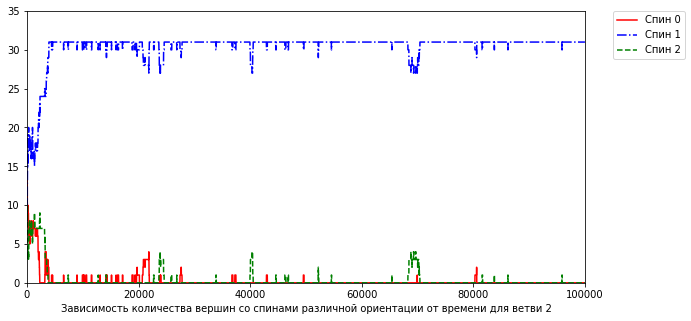

No handles with labels found to put in legend.


Branches
Ветвь 0


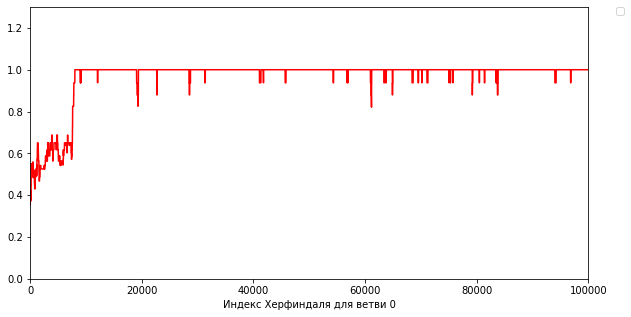

No handles with labels found to put in legend.


Ветвь 1


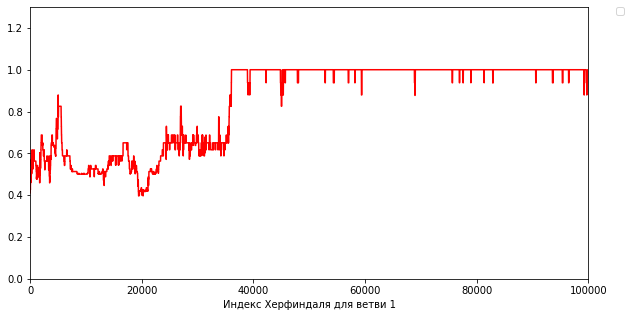

No handles with labels found to put in legend.


Ветвь 2


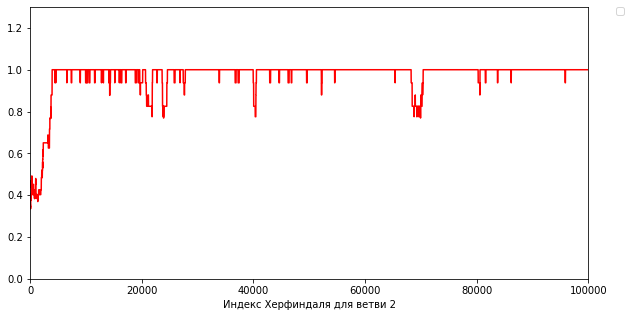

Circles
Окружность 0


No handles with labels found to put in legend.


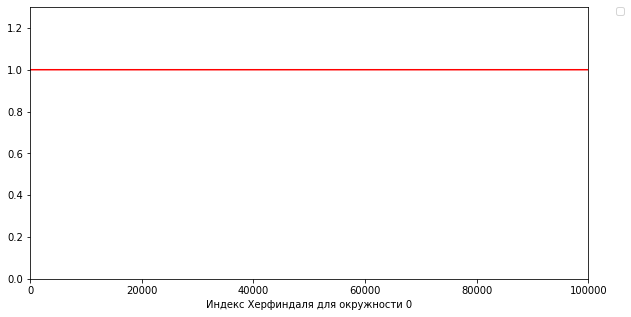

No handles with labels found to put in legend.


Окружность 1


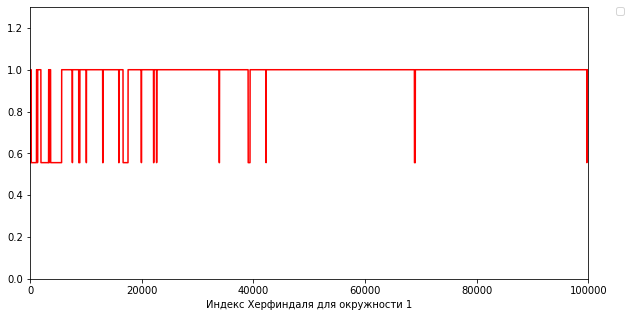

No handles with labels found to put in legend.


Окружность 2


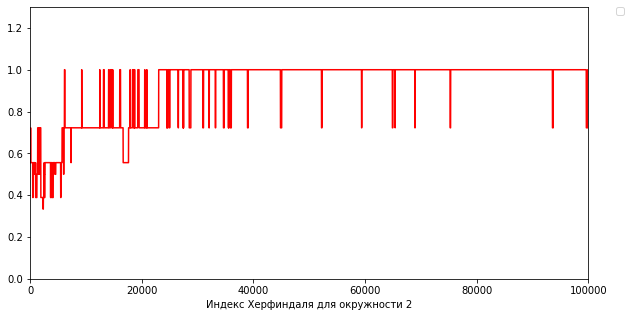

No handles with labels found to put in legend.


Окружность 3


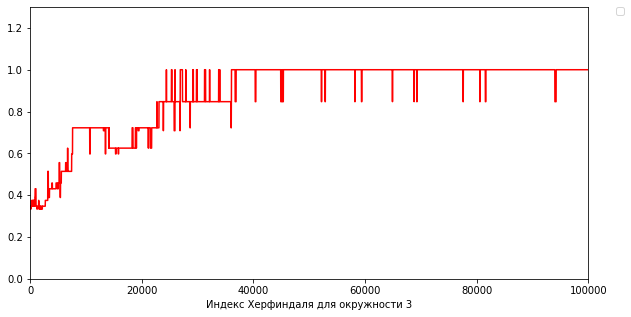

Окружность 4

No handles with labels found to put in legend.


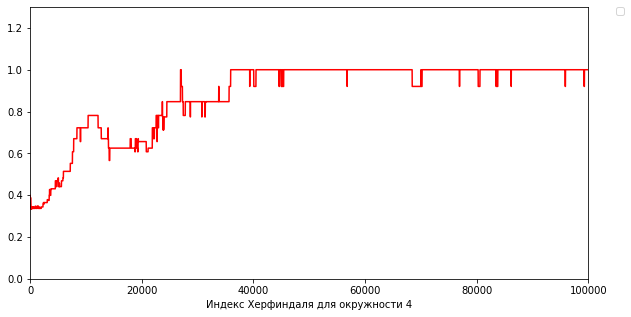

No handles with labels found to put in legend.


Окружность 5


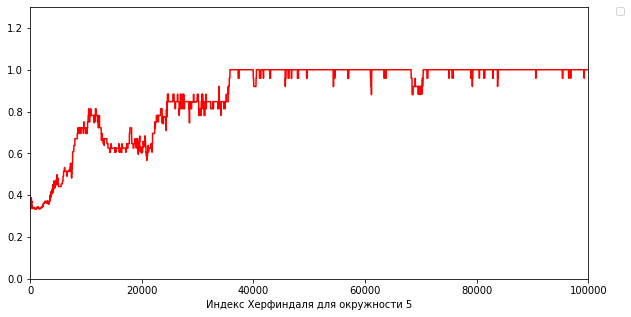

p = [38, 28, 28]


No handles with labels found to put in legend.


debug zero past = 1


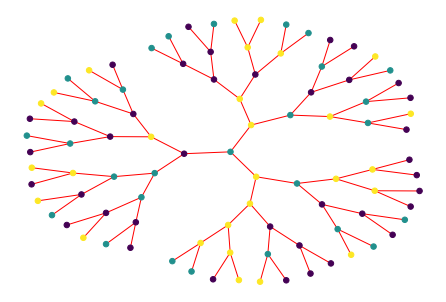

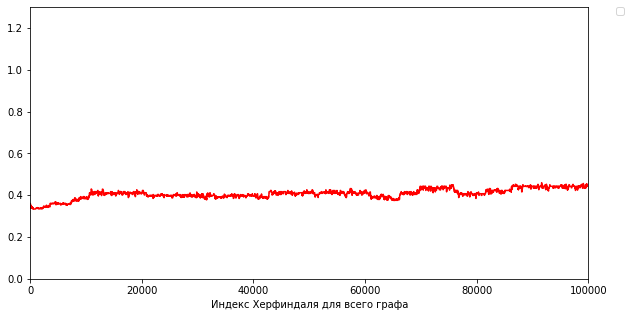

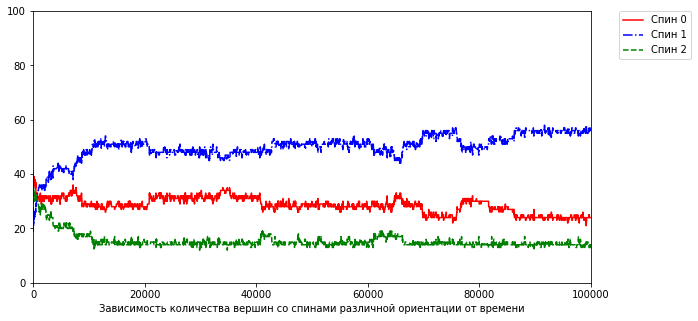

No handles with labels found to put in legend.


p = [24, 56, 14]
zero point


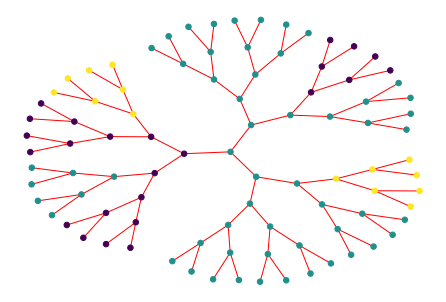

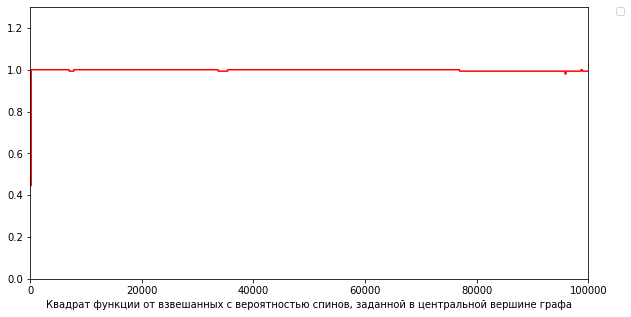

colors of branches
epoch = 0


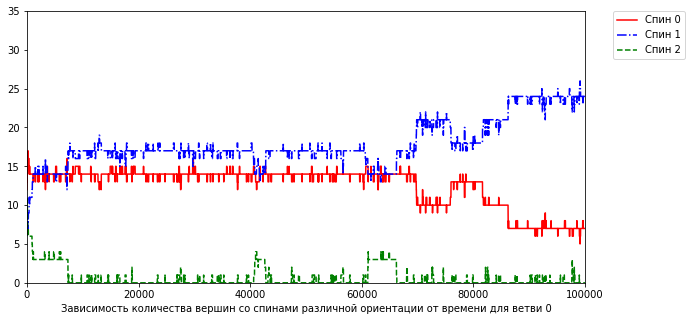

epoch = 1


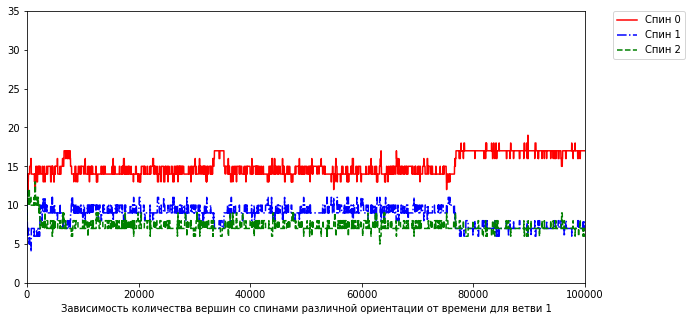

epoch = 2


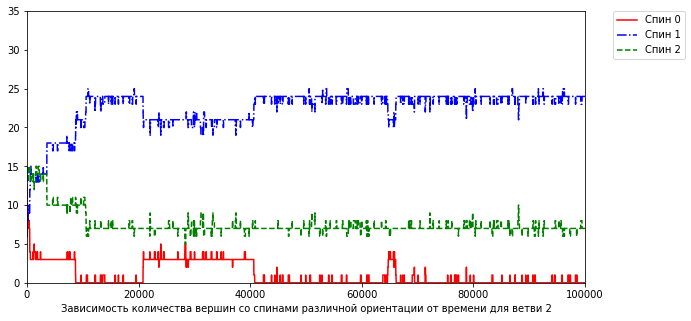

No handles with labels found to put in legend.


Branches
Ветвь 0


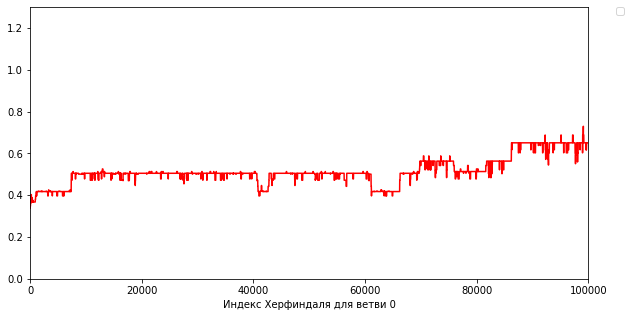

No handles with labels found to put in legend.


Ветвь 1


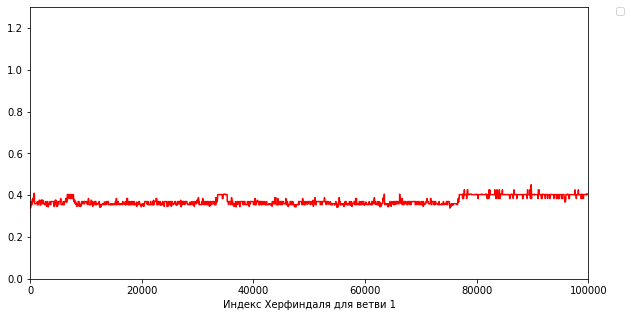

No handles with labels found to put in legend.


Ветвь 2


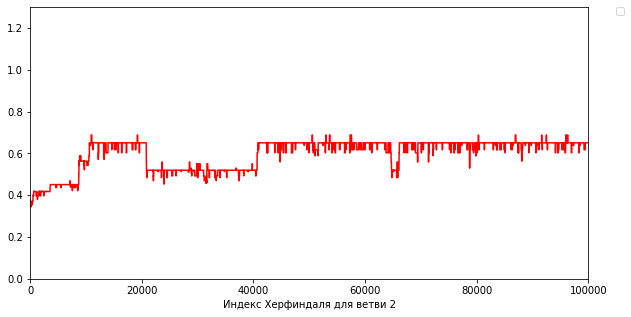

Circles
Окружность 0


No handles with labels found to put in legend.


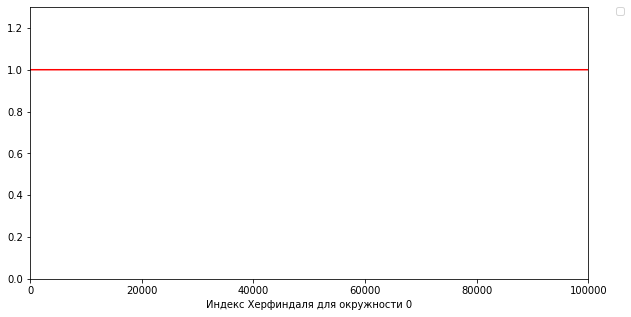

No handles with labels found to put in legend.


Окружность 1


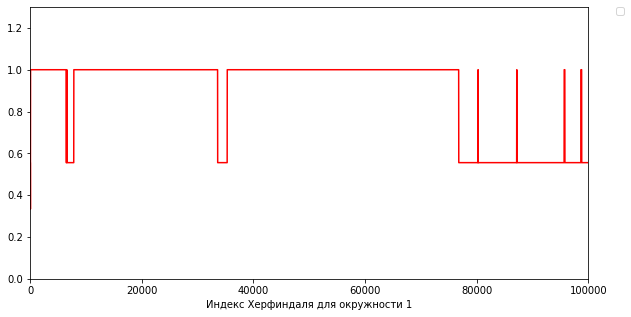

Окружность 2


No handles with labels found to put in legend.


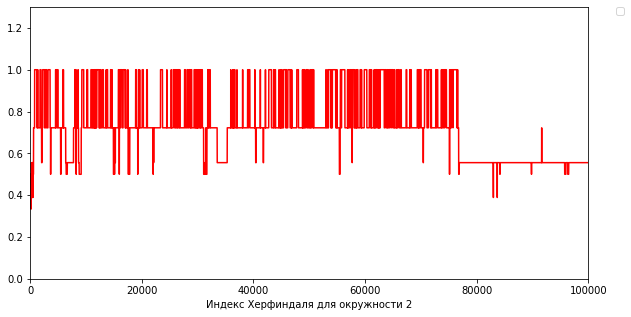

Окружность 3


No handles with labels found to put in legend.


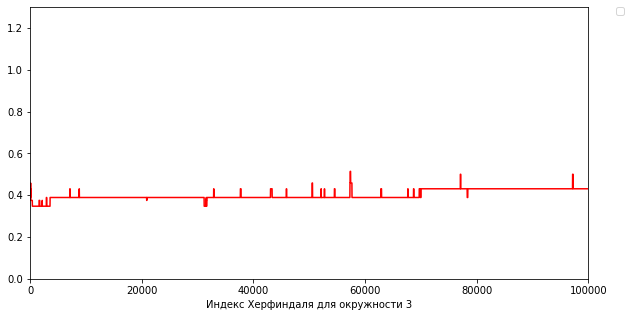

Окружность 4


No handles with labels found to put in legend.


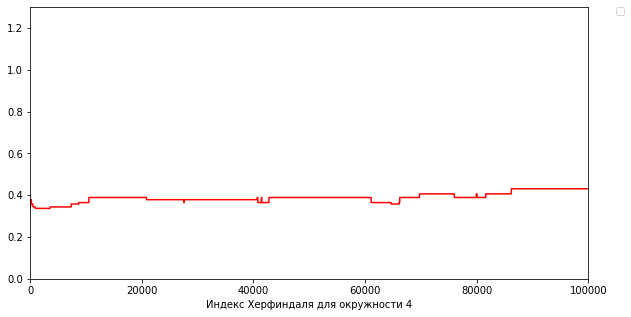

Окружность 5


No handles with labels found to put in legend.


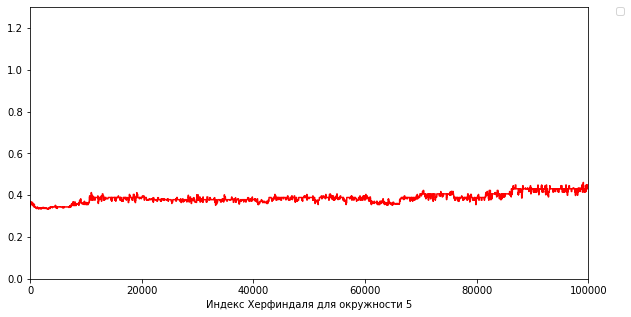

p = [36, 32, 26]


No handles with labels found to put in legend.


debug zero past = 0


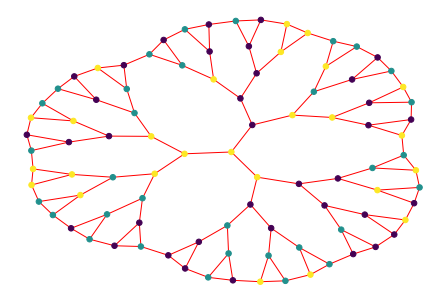

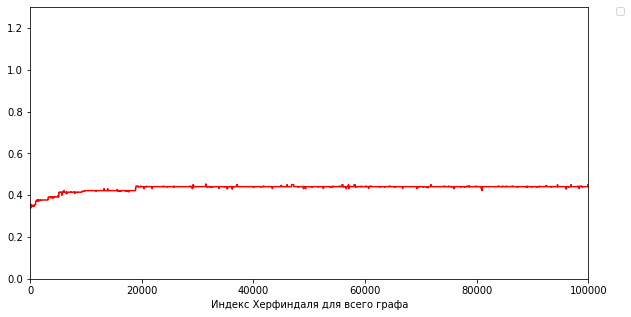

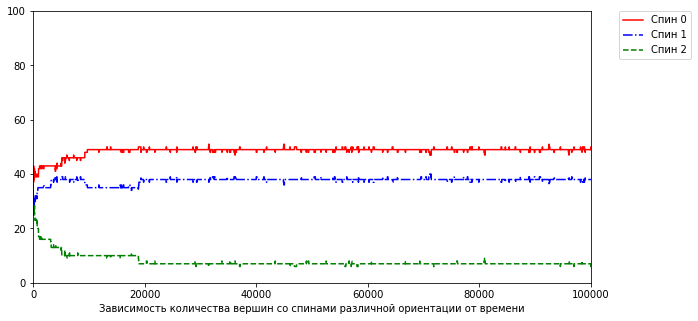

No handles with labels found to put in legend.


p = [49, 38, 7]
zero point


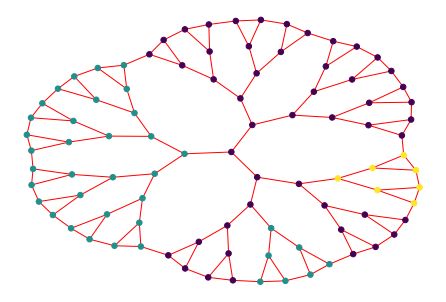

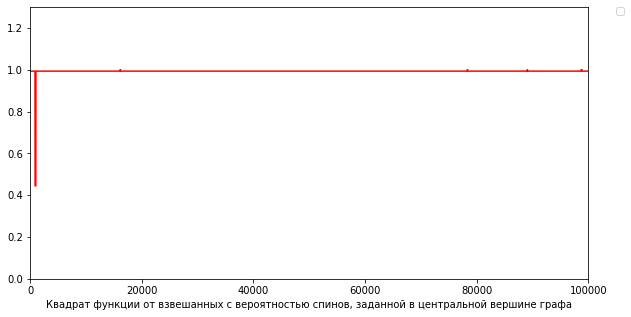

colors of branches
epoch = 0


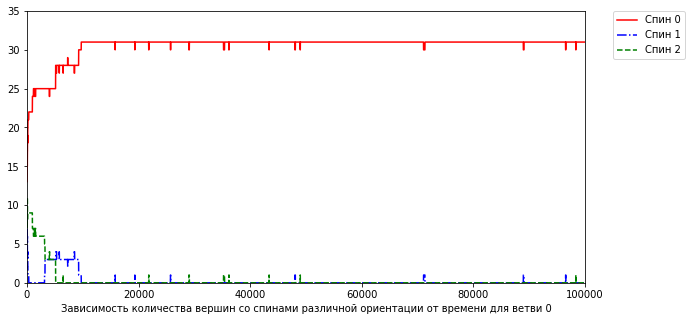

epoch = 1


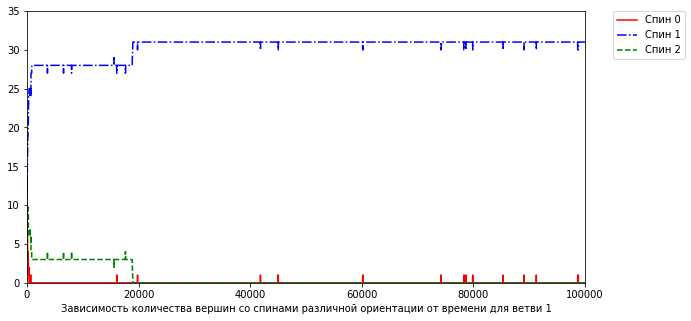

epoch = 2


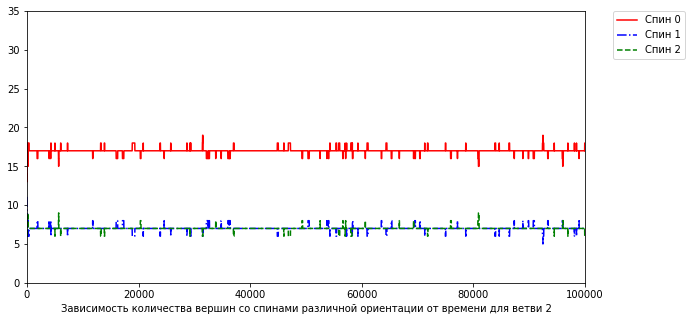

No handles with labels found to put in legend.


Branches
Ветвь 0


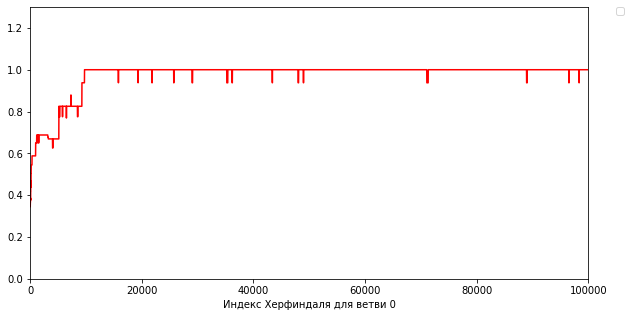

Ветвь 1


No handles with labels found to put in legend.


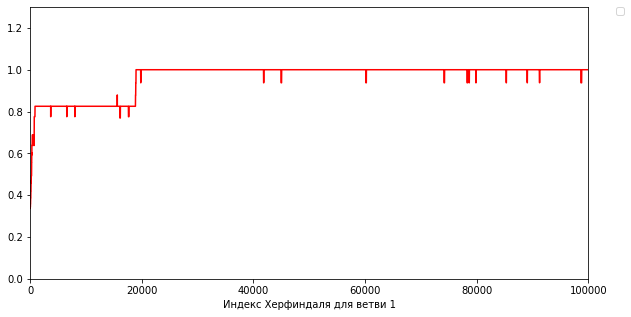

No handles with labels found to put in legend.


Ветвь 2


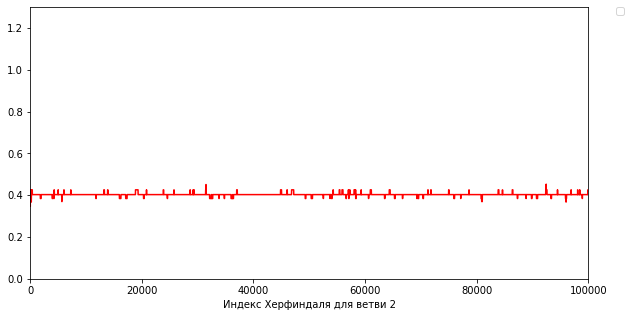

Circles


No handles with labels found to put in legend.


Окружность 0


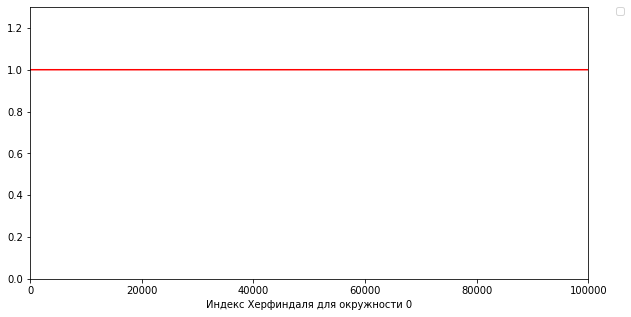

Окружность 1


No handles with labels found to put in legend.


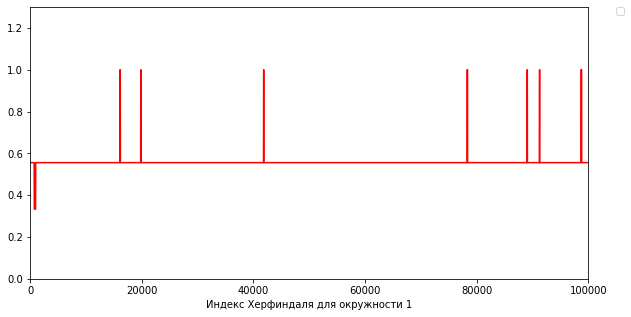

Окружность 2


No handles with labels found to put in legend.


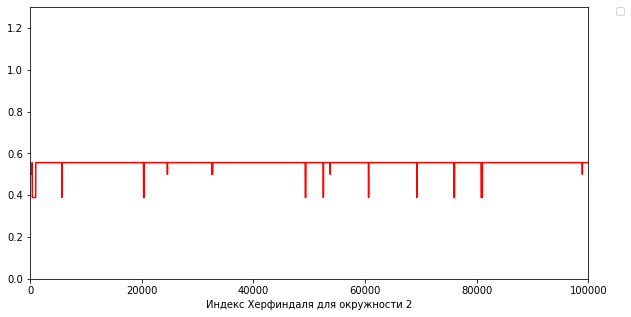

No handles with labels found to put in legend.


Окружность 3


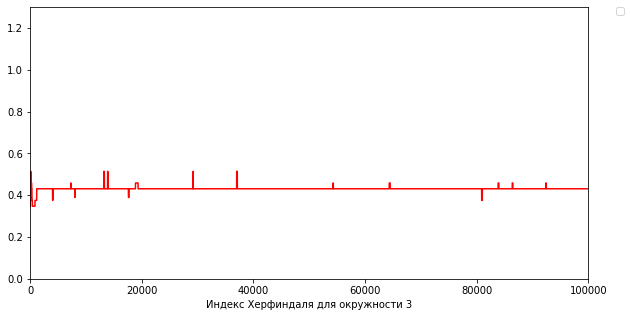

Окружность 4


No handles with labels found to put in legend.


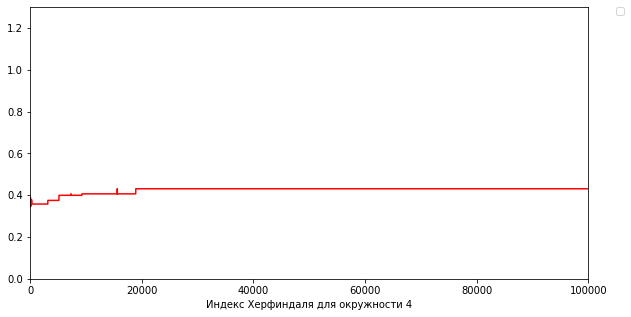

No handles with labels found to put in legend.


Окружность 5


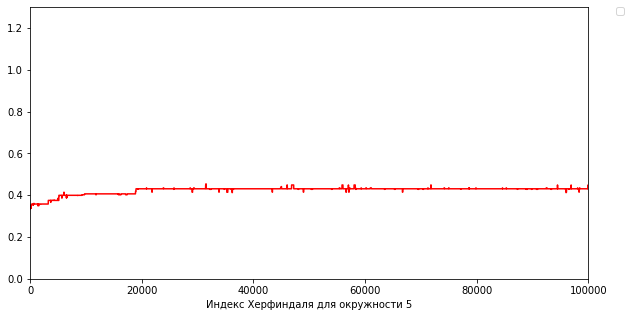

p = [30, 35, 29]


No handles with labels found to put in legend.


debug zero past = 2


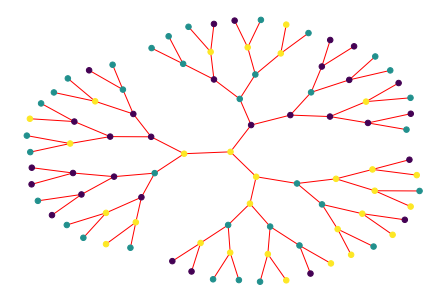

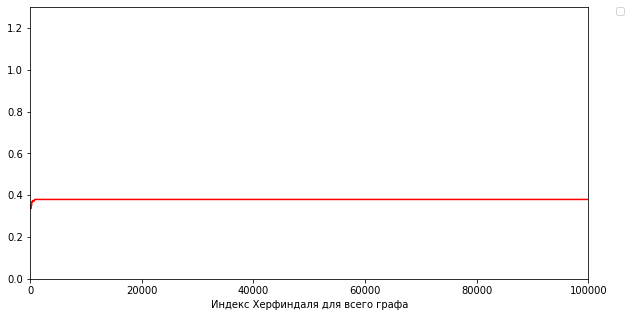

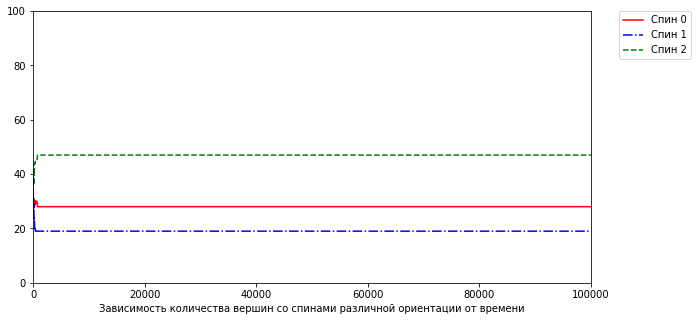

No handles with labels found to put in legend.


p = [28, 19, 47]
zero point


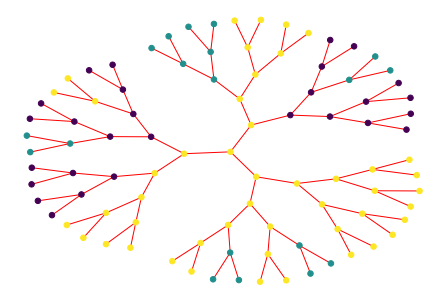

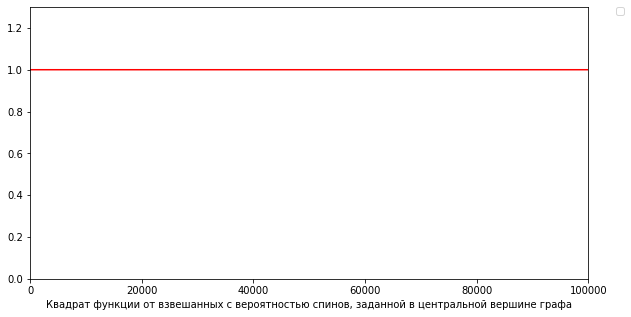

colors of branches
epoch = 0


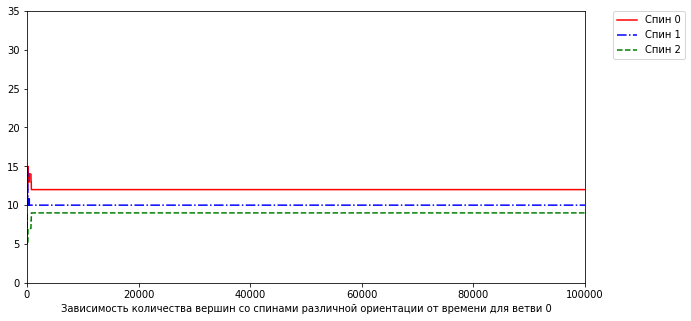

epoch = 1


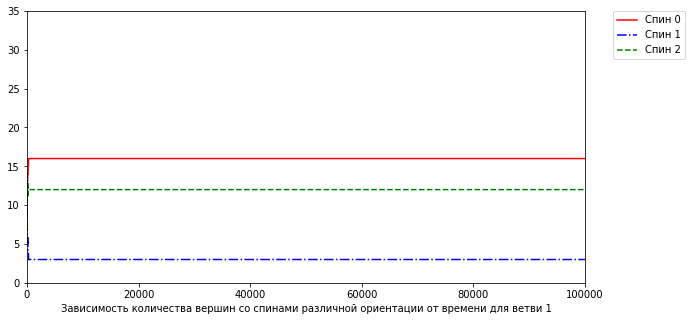

epoch = 2


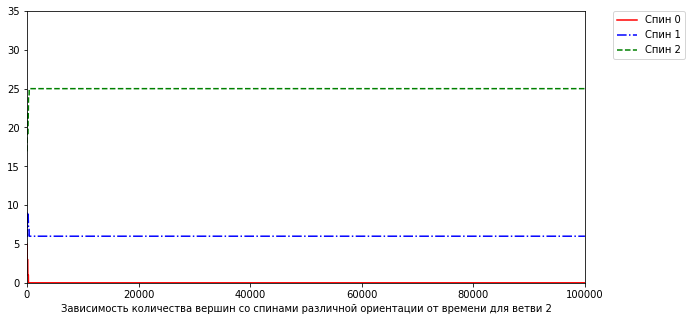

No handles with labels found to put in legend.


Branches
Ветвь 0


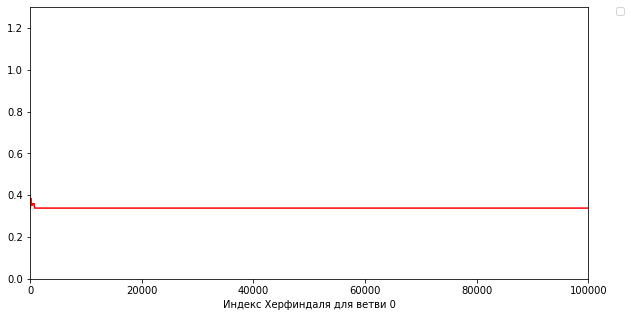

No handles with labels found to put in legend.


Ветвь 1


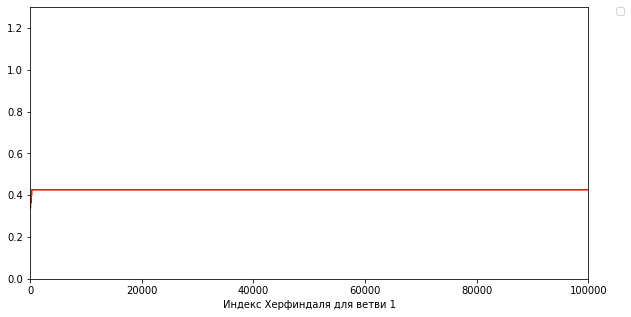

No handles with labels found to put in legend.


Ветвь 2


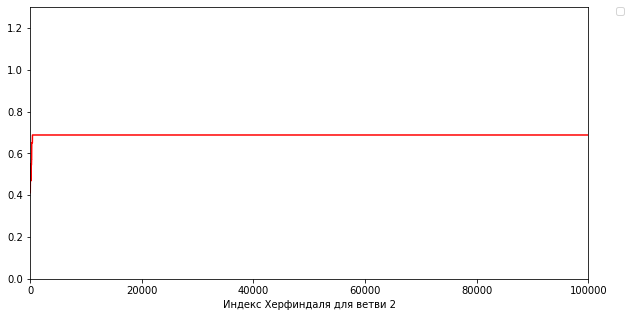

No handles with labels found to put in legend.


Circles
Окружность 0


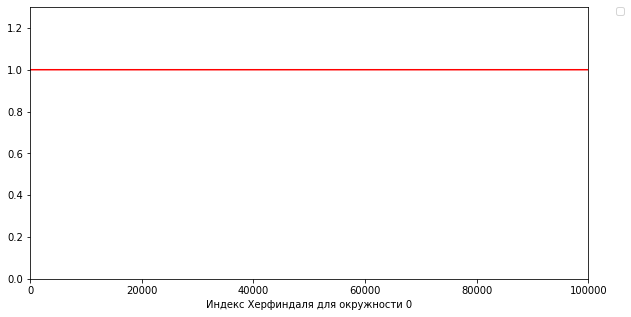

Окружность 1

No handles with labels found to put in legend.


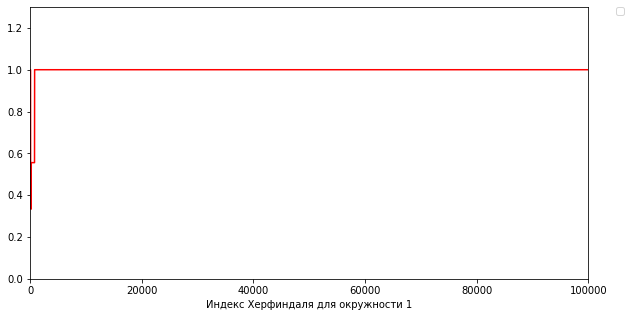

No handles with labels found to put in legend.


Окружность 2


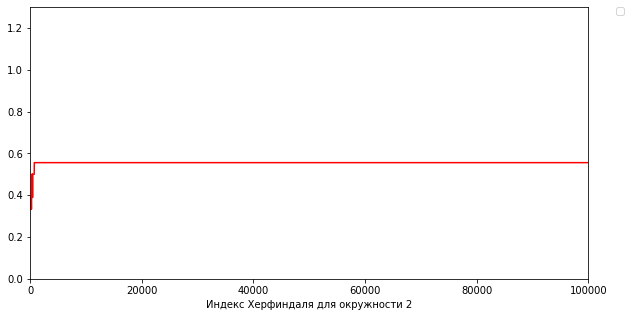

No handles with labels found to put in legend.


Окружность 3


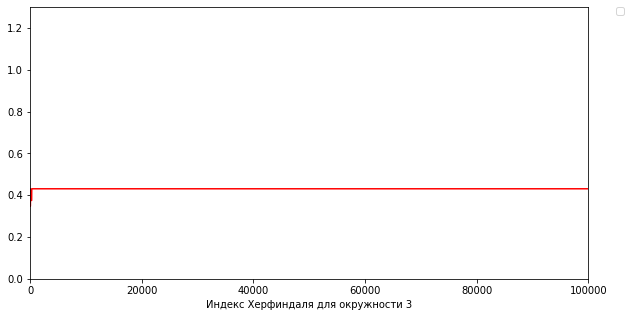

No handles with labels found to put in legend.


Окружность 4


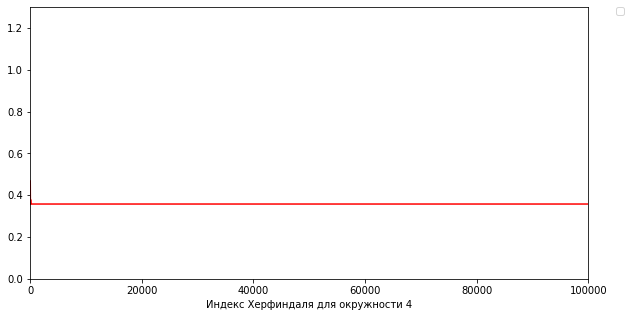

No handles with labels found to put in legend.


Окружность 5


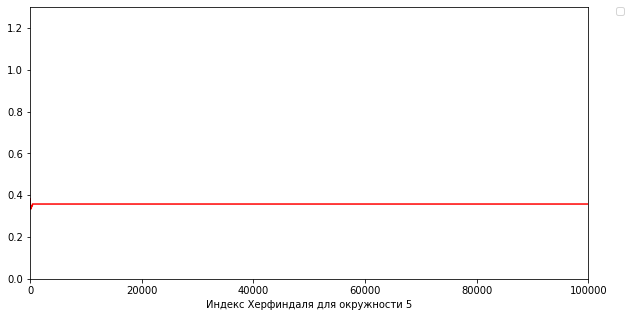

p = [34, 34, 26]


No handles with labels found to put in legend.


debug zero past = 0


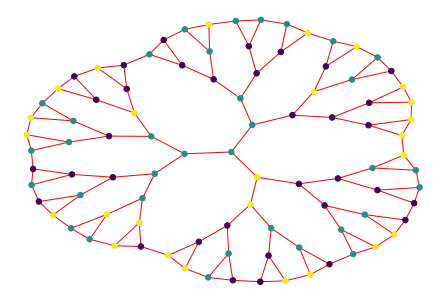

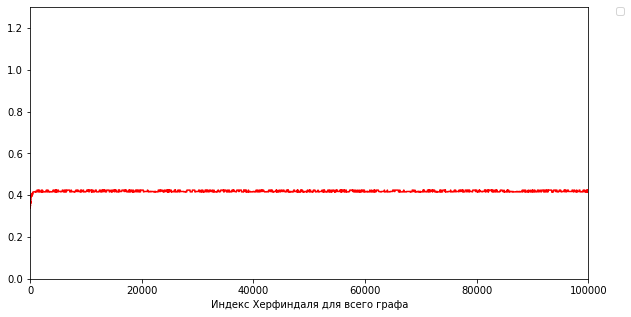

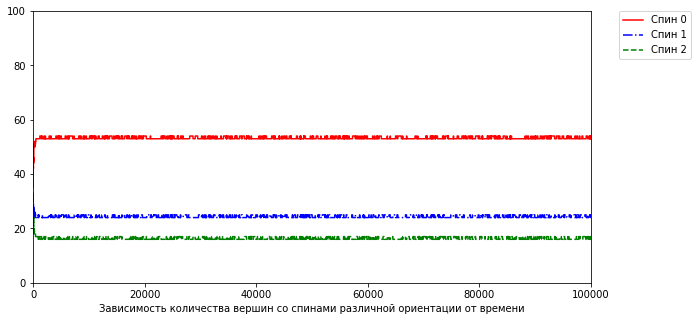

No handles with labels found to put in legend.


p = [53, 24, 17]
zero point


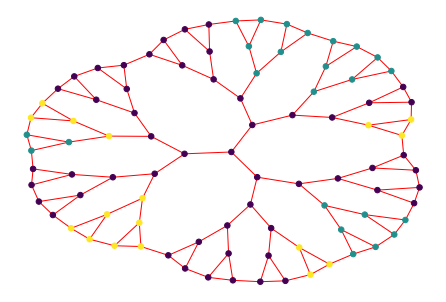

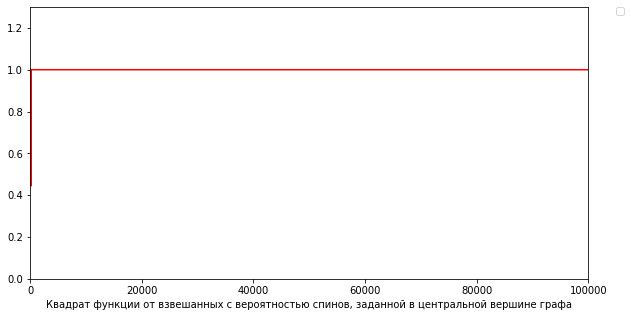

colors of branches
epoch = 0


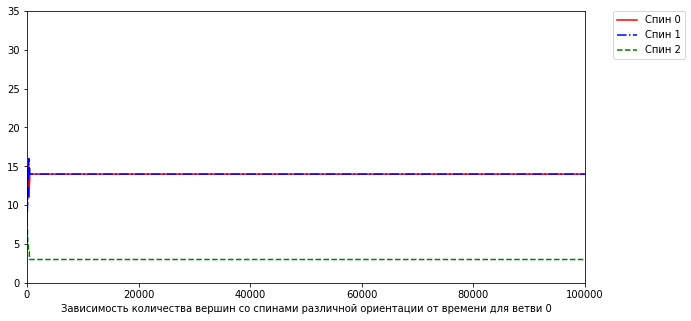

epoch = 1


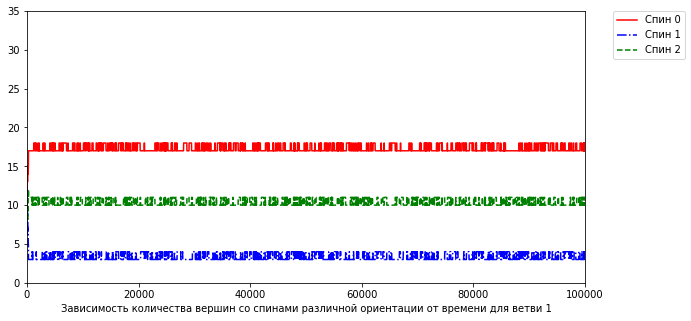

epoch = 2


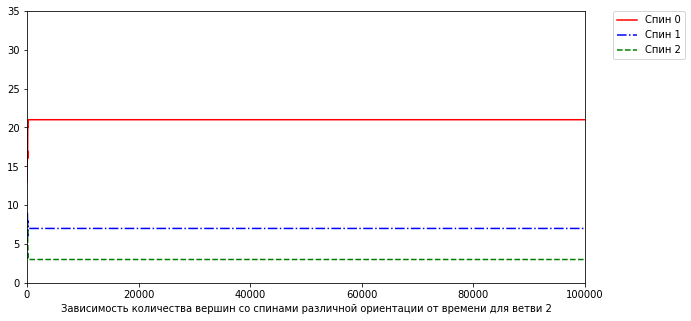

No handles with labels found to put in legend.


Branches
Ветвь 0


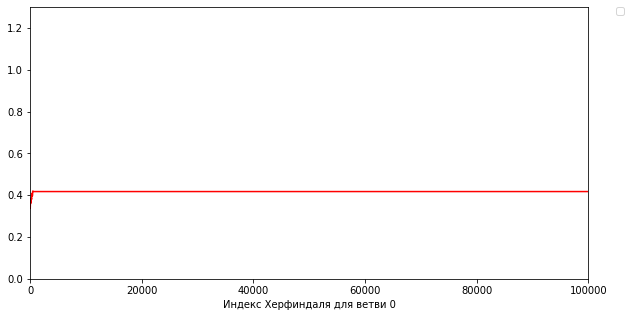

No handles with labels found to put in legend.


Ветвь 1


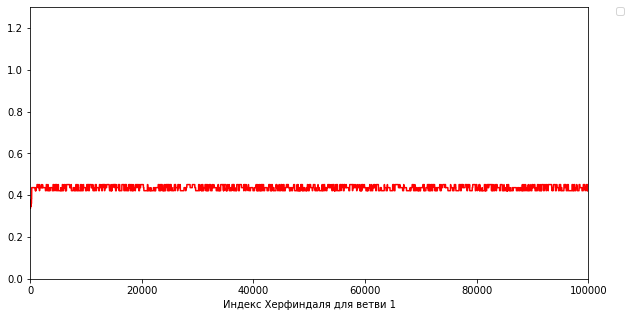

Ветвь 2


No handles with labels found to put in legend.


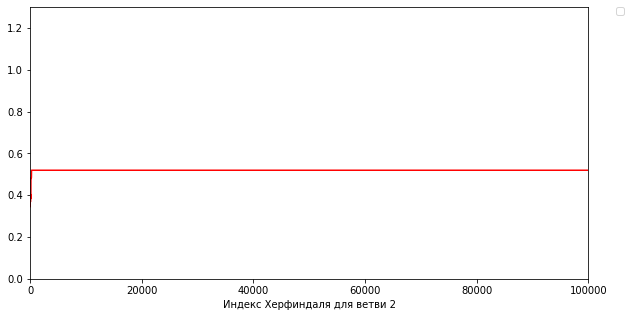

Circles
Окружность 0


No handles with labels found to put in legend.


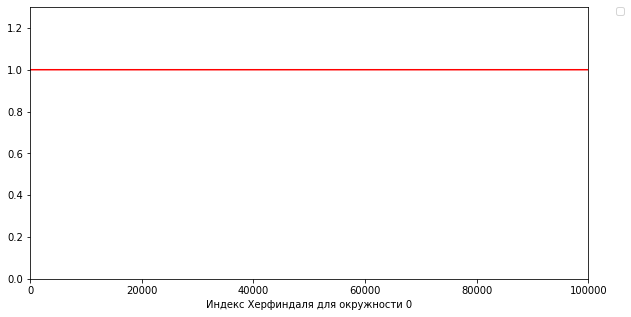

No handles with labels found to put in legend.


Окружность 1


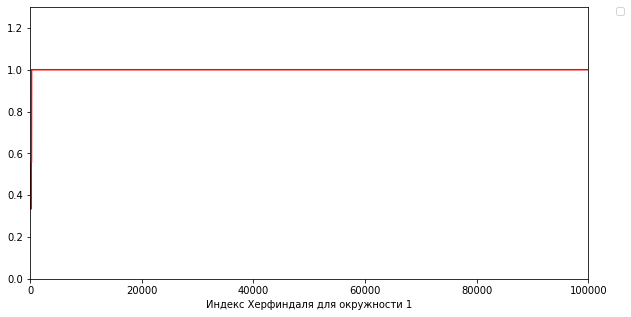

No handles with labels found to put in legend.


Окружность 2


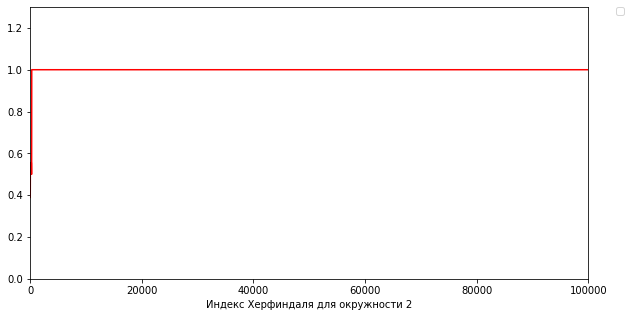

Окружность 3


No handles with labels found to put in legend.


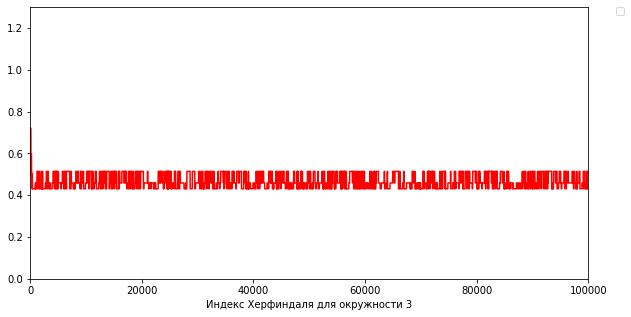

No handles with labels found to put in legend.


Окружность 4


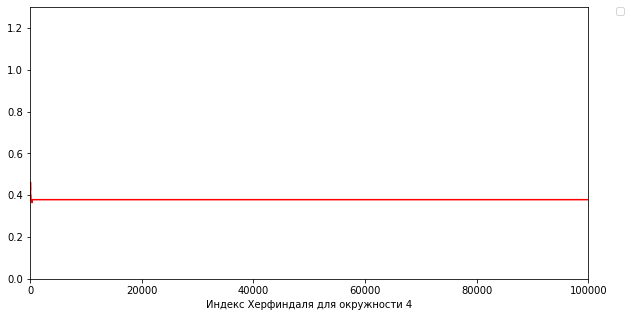

No handles with labels found to put in legend.


Окружность 5


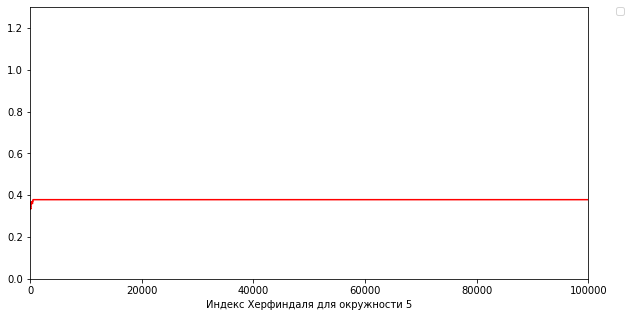

In [ ]:
stat3(100000)

In [ ]:
[i for i in range(3)]

[0, 1, 2]

In [ ]:
mass = np.array([0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1])
np.sum(mass == 1)

17